Like smallMa1 notebook, but tan beta now in range 0 - 50 instead of 10 - 30

In [1]:
from copy import deepcopy
from contextlib import contextmanager

import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib.pyplot import cm
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import LogNorm, Normalize
import matplotlib.gridspec as gridspec
from itertools import izip
from matplotlib.ticker import ScalarFormatter, FormatStrFormatter, MultipleLocator
from collections import namedtuple
from IPython.display import IFrame
import functools

%matplotlib inline

get_ipython().magic(u'load_ext autoreload')
get_ipython().magic(u'autoreload 2')


mpl.rcParams['font.size'] = 18
mpl.rcParams['figure.figsize'] = (7.0, 4.0)  # default size of plots
mpl.rcParams['axes.labelsize'] = 22
mpl.rcParams['xtick.labelsize'] = 16
mpl.rcParams['ytick.labelsize'] = 16
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['legend.framealpha'] = 0.6
mpl.rcParams['legend.scatterpoints'] = 1
mpl.rcParams['legend.numpoints'] = 1
# mpl.rcParams.update({'font.size': 24, 'font.family': 'STIXGeneral', 'mathtext.fontset': 'stix'})
mpl.rcParams.update({'font.family': 'STIXGeneral', 'mathtext.fontset': 'stix'})
pd.set_option('display.max_colwidth', 120)
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 500)

In [2]:
from common_plots import *

In [3]:
from common_strings import *

In [4]:
import Exp_limits.commonPlot as plotr

In [5]:
# Here get your dataframes.
# Extract dataframes from binary
store = pd.HDFStore("points_500_MICRO_SCAN_NTv493_HBv431_HSv140_smallMa1_DMass2_fixAssignMass_11_Jul_16_0758.h5")
# df_orig_1 = store.full12loop_all
df_pass_all = store.full12loop_good_posMuMagMom_planckUpperOnly_ignorebctaunu_ignorechi2 #'relaxed' constraints - +ve g-2 and omegah^2

store.close()

Helper functions for saving plots with different backends easily:

In [6]:
def get_backend():
    return list(get_ipython().magic(u"config InlineBackend.figure_formats"))

def set_backend(fmt):
    print 'Setting backend', fmt
    get_ipython().magic(u"config InlineBackend.figure_formats = '%s', " % fmt)

@contextmanager
def backend(fmt):
    old_fmt = get_backend()[0]
    set_backend(fmt)
    yield
#     set_backend(old_fmt)
    set_backend('png')

def save_fig(func):
    """Decorator func for easily saving plots in jupyter notebook.
    
    Just add in a filename=XXX to your normal function arguments.
    It will auto switch backends correctly.
    """
    def wrapper(*args, **kwargs):
        filename = kwargs['filename']
        if filename == '':
            raise IOError('No filename')
        if '.' not in filename:
            raise IOError('No extension in filename: %s' % filename)
        fmt = os.path.splitext(filename)[1].lstrip('.') if SAVE_PLOTS else 'png'
        with backend(fmt):
            new_kwargs = deepcopy(kwargs)
            del new_kwargs['filename']
            func(*args, **new_kwargs)
            if SAVE_PLOTS: 
                save_plot(filename)
    return wrapper


In [7]:
SAVE_PLOTS = True

if SAVE_PLOTS:
    set_backend('png')
    mpl.rcParams['savefig.dpi'] = 100
else:
    set_backend('png')
    mpl.rcParams['savefig.dpi'] = 72

Setting backend png


In [8]:
title = ''
SIZE = 15

Make it easier to choose optional constraints:

# Optional constraint flags 

In [9]:
def add_constraint_flags(df):
    accept_constraints = {
            "pass_del_a_mu": r"Muon magn\. mom\. more than 2 sigma away",
            "pass_relic": r"Relic density too small \(Planck\)",
            "pass_bctaunu": r"b \-> c tau nu more than 2 sigma away \(as SM\)",
            "pass_chi2zz": r"chi2\(H\->ZZ\) > 6\.18",
            "pass_chi2bb": r"chi2\(H\->bb\) > 6\.18",
            "pass_chi2gg": r"chi2\(H\->gg\) > 6\.18",
            "pass_cms4mu": r"Excluded H_125\->AA\->4mu \(CMS\)"
    }

    for k, v in accept_constraints.iteritems():
        if k not in df.columns:
            df[k] = ~df.constraints.str.contains(v)

    df['pass_HSHB'] = (df.HSprob > 0.05) & (df.HBresult==1)
    df['pass_NT'] = (df.pass_chi2zz) & (df.pass_chi2bb) & (df.pass_chi2gg)
    df['pass_strict'] = (df.pass_HSHB) & (df.pass_NT) & (df.pass_del_a_mu) & (df.pass_relic)

In [10]:
add_constraint_flags(df_pass_all)

# Add new constraints

In [13]:
cms_mu_10 = pd.read_csv('Exp_limits/CMS_HIG_13_010_full.csv')
cms_mu_10_dict = {k:v for k, v in zip(cms_mu_10.m_a.values, cms_mu_10.xsec_br_4mu.values)}
cms_mu_10_dict = OrderedDict(sorted(cms_mu_10_dict.items(), key=lambda t: t))

In [14]:
atlas = pd.read_csv('Exp_limits/ATLAS_HIGG_2014_02_full.csv')
atlas_dict = {k:v for k, v in zip(atlas.m_a.values, atlas.xsec_br_4tau.values)}
atlas_dict = OrderedDict(sorted(atlas_dict.items(), key=lambda t: t))

cms_tau_19 = pd.read_csv('Exp_limits/CMS_HIG_14_019_full.csv')
cms_19_dict = {k:v for k, v in zip(cms_tau_19.m_a.values, cms_tau_19.xsec_br_4tau.values)}
cms_19_dict = OrderedDict(sorted(cms_19_dict.items(), key=lambda t: t))

cms_tau_22 = pd.read_csv('Exp_limits/CMS_HIG_14_022_full.csv')
cms_22_dict = {k:v for k, v in zip(cms_tau_22.m_a.values, cms_tau_22.xsec_br_4tau.values)}
cms_22_dict = OrderedDict(sorted(cms_22_dict.items(), key=lambda t: t))

In [15]:
cms_2tau2mu_11 = pd.read_csv('Exp_limits/CMS_HIG_15_011_full.csv')
cms_2tau2mu_11_dict = {k:v for k, v in zip(cms_2tau2mu_11.m_a.values, cms_2tau2mu_11.xsec_br_4tau.values)}
cms_2tau2mu_11_dict = OrderedDict(sorted(cms_2tau2mu_11_dict.items(), key=lambda t:t))

In [16]:
cms_2b2mu_41 = pd.read_csv('Exp_limits/CMS_HIG_14_041_full.csv')

In [17]:
def apply_new_constraints(df):
    df['pass_limits_xsec_8_ggf_h1_2a1_4tau'] = df.apply(lambda x: (pass_limit(x.ma1, x.xsec_8_ggf_h1_2a1_4tau, atlas_dict) 
#                                                                    and pass_limit(x.ma1, x.xsec_8_ggf_h1_2a1_4tau, cms_19_dict) 
                                                                   and pass_limit(x.ma1, x.xsec_8_ggf_h1_2a1_4tau, cms_22_dict)), 
                                                        axis=1)
    df['pass_limits_xsec_8_ggf_h2_2a1_4tau'] = df.apply(lambda x: (pass_limit(x.ma1, x.xsec_8_ggf_h2_2a1_4tau, atlas_dict) 
#                                                                    and pass_limit(x.ma1, x.xsec_8_ggf_h2_2a1_4tau, cms_19_dict) 
                                                                   and pass_limit(x.ma1, x.xsec_8_ggf_h2_2a1_4tau, cms_22_dict)), 
                                                        axis=1)

In [18]:
apply_new_constraints(df_pass_all)

# Higgs Masses vs Input Params

##  a1

In [19]:
@save_fig
def plot_ma1_inputparams_multiple(df, title):
    dfs = [df, 
           df.query('pass_HSHB'), 
           df.query('pass_NT'), 
           df.query('pass_strict'),
           df.query('pass_HSHB & not pass_limits_xsec_8_ggf_h1_2a1_4tau')
          ]

    plot_input_params_scatters_multiple(dfs, 'ma1', r'$m_{a_1}\ \mathrm{[GeV]}$', 
                                        yrange=[0, 20], title=title, cols=3,
                                        param_dict=nmssm_params_extended,
                                        kwargs=[
                                            {'color':'green', 's': SIZE, 'label': 'Relaxed'},
                                            {'color':'magenta', 'marker': 'v', 's': SIZE, 'label': 'Pass HS+HB'},
                                            {'alpha': 0.75, 'color':'dodgerblue', 'marker': 'd', 's': SIZE, 'label': 'Pass NT Higgs '+r'$\chi^2$'},
                                            {'alpha': 0.75, 'color':'red', 'marker':'s', 's': SIZE, 'label': 'All NT constraints'},
                                            {'alpha':0.5, 'color':'orange', 'marker':'o', 's': SIZE, 'label': 'All NT constraints , fail new'}
                                        ])
    plt.gcf().axes[0].legend(loc='upper center', ncol=len(dfs), bbox_to_anchor=(1.75, 1.25))

Setting backend png
Setting backend png


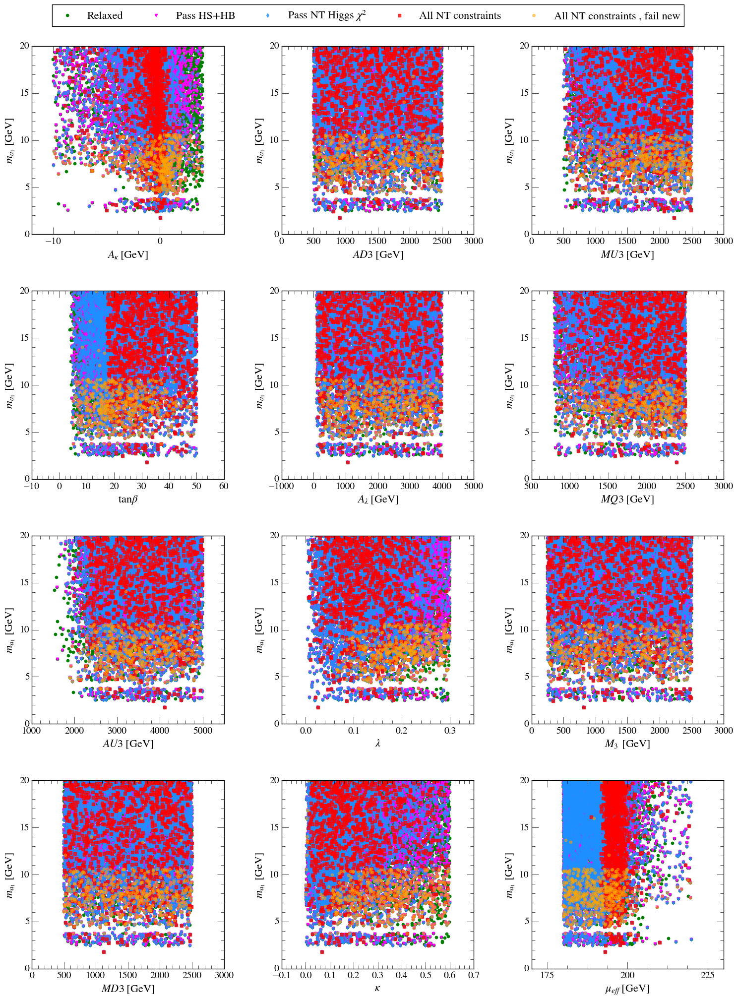

In [21]:
plot_ma1_inputparams_multiple(df_pass_all, '', filename='Thesis_plots_5/Masses/ma1_inputparams_multiple.png')

In [22]:
@save_fig
def plot_ma1_inputparams(df, title):
    plot_input_params_scatters(df, 'ma1', r'$m_{a_1}\ \mathrm{[GeV]}$', 
                               yrange=[0, 20], title=title, cols=2, s=SIZE, alpha=0.5)

Setting backend png
Setting backend png


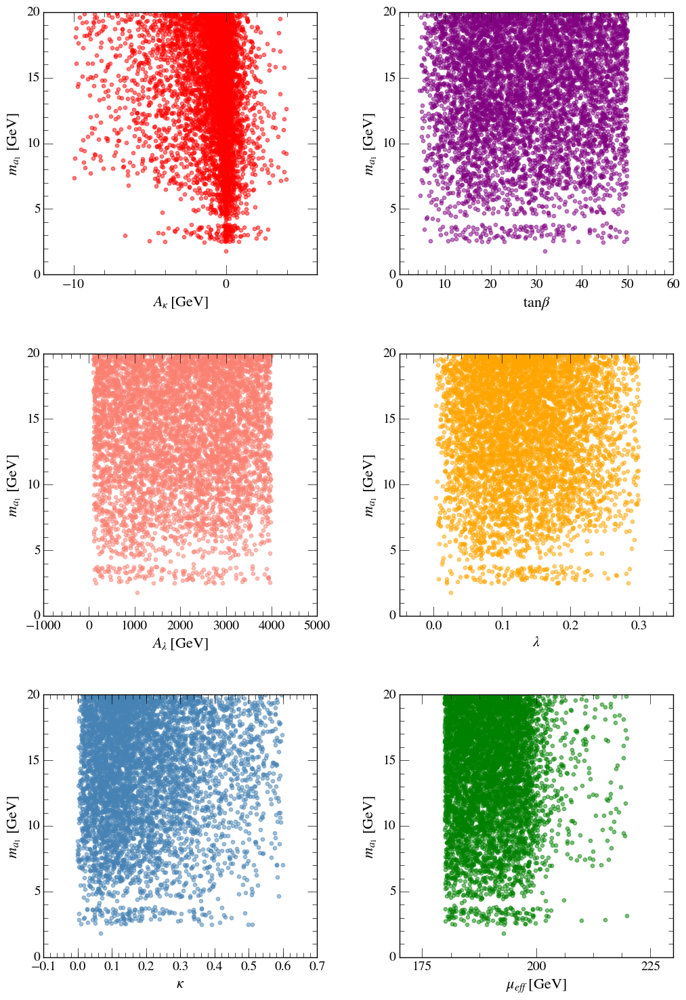

In [23]:
plot_ma1_inputparams(df_pass_all.query('pass_NT & pass_HSHB'), 
                     title, filename='Thesis_plots_5/Masses/ma1_inputparams_relaxed.png')

Setting backend png
Setting backend png


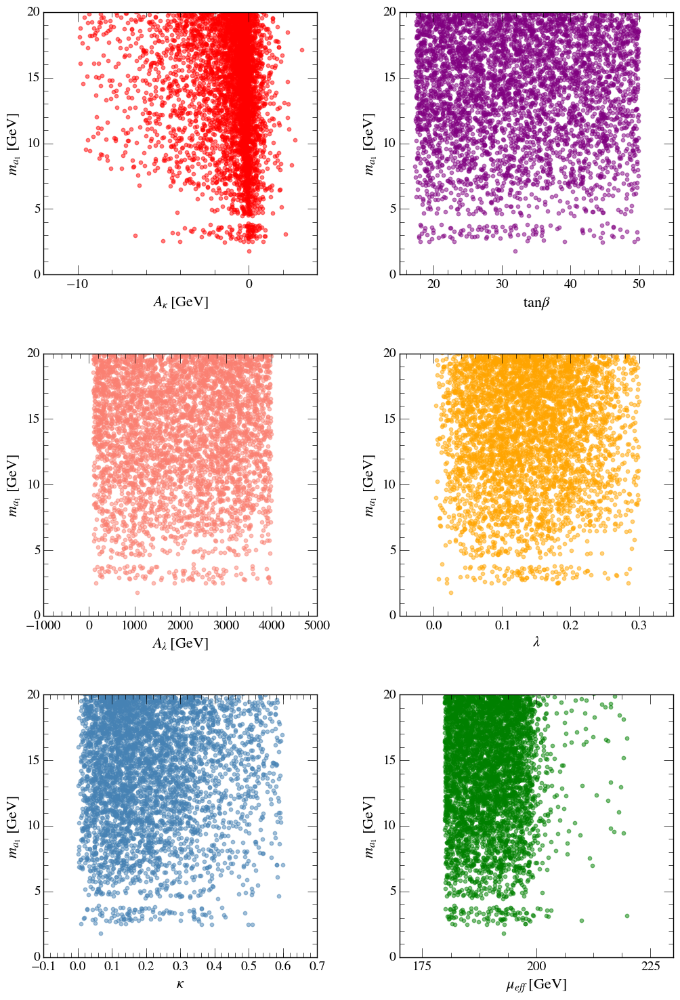

In [24]:
plot_ma1_inputparams(df_pass_all.query('pass_NT & pass_HSHB & pass_del_a_mu'), 
                     title='', filename='Thesis_plots_5/Masses/ma1_inputparams_relaxed_muon.png')

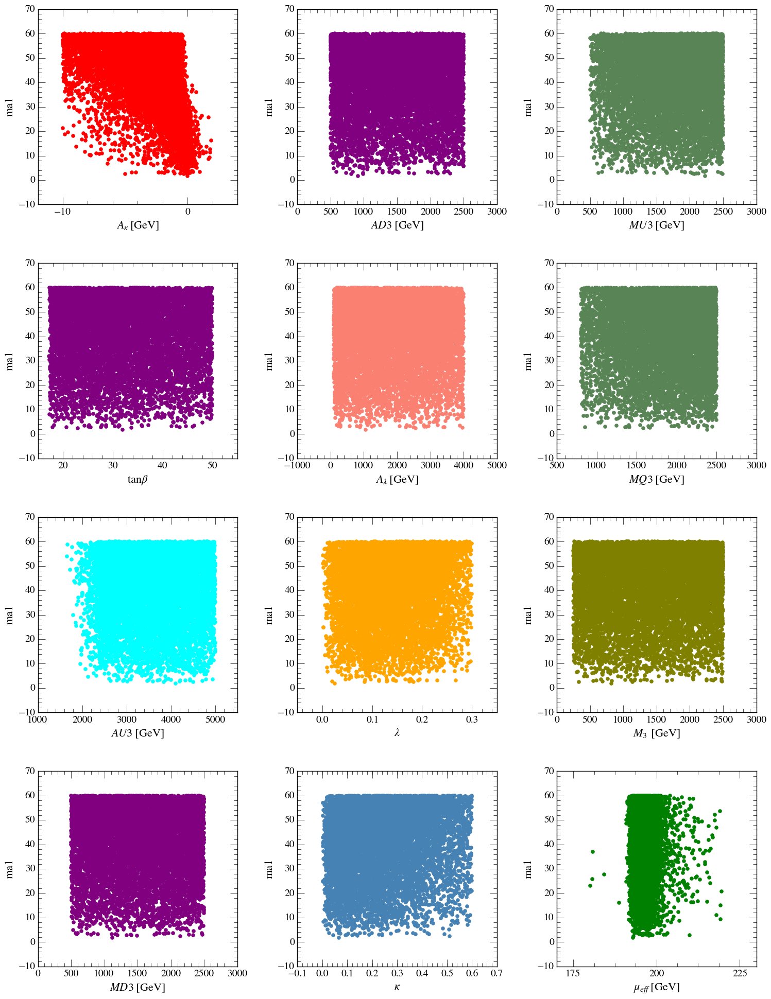

In [25]:
plot_input_params_scatters(df_pass_all.query('pass_strict'), ylabel='ma1', 
                           title='', yvar='ma1', param_dict=nmssm_params_extended)

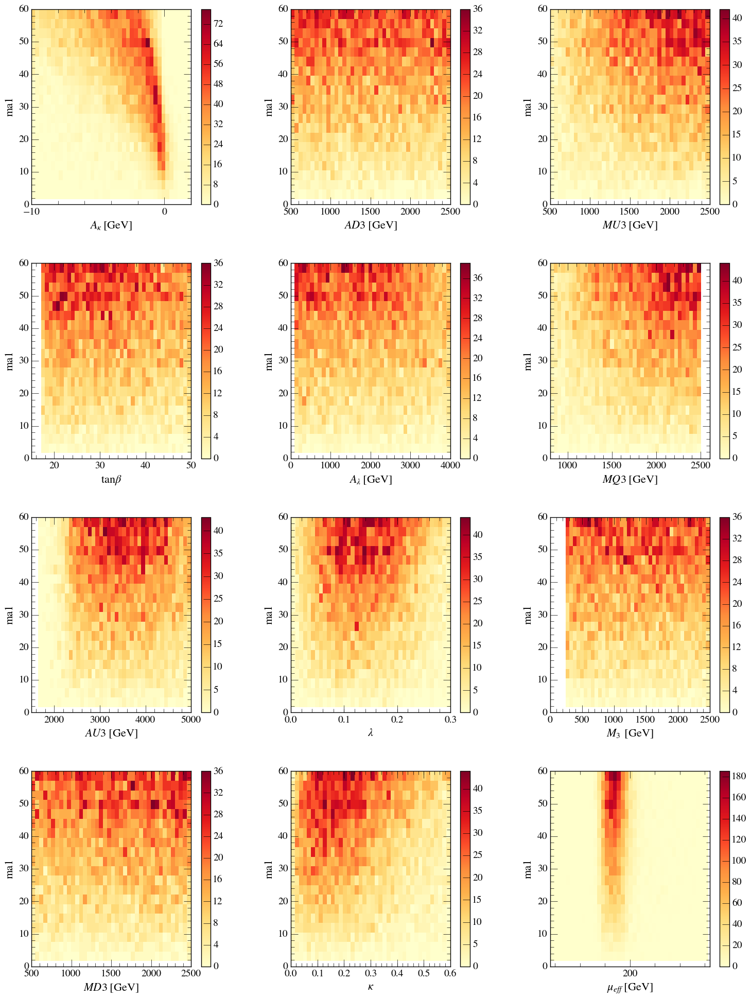

In [38]:
plot_input_params_hist2d(df_pass_all.query('pass_strict'), ylabel='ma1', 
                         title='', yvar='ma1', 
                         param_dict=nmssm_params_extended, 
                         bins=[40, 20],
                         cmap='YlOrRd', norm_axis=None)

Setting backend png
Setting backend png


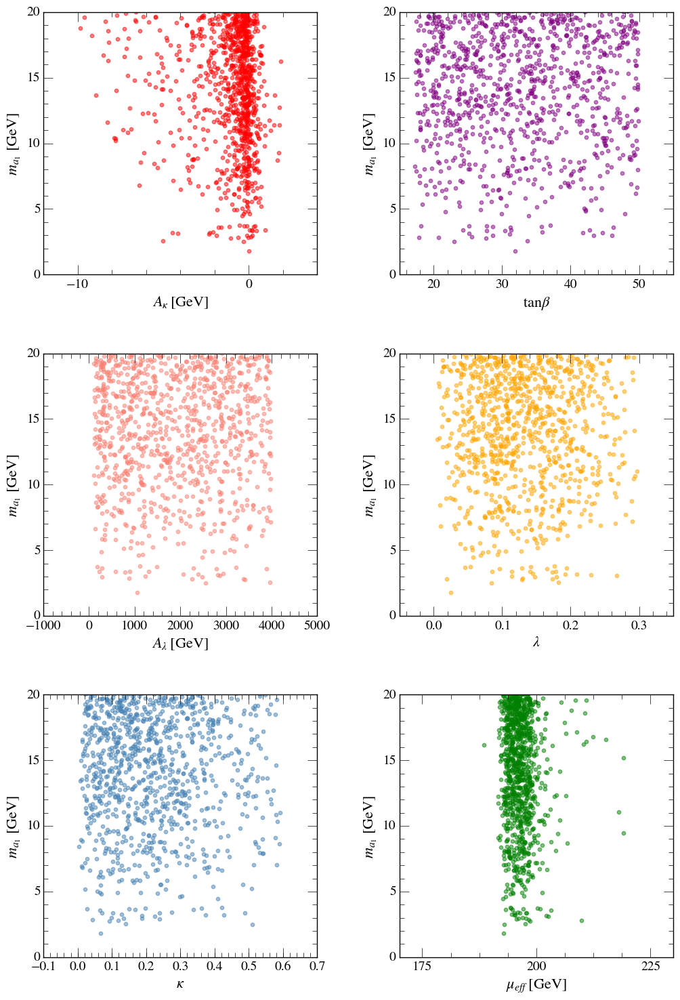

In [39]:
plot_ma1_inputparams(df_pass_all.query('pass_strict'), 
                     title, filename='Thesis_plots_5/Masses/ma1_inputparams_strict.png')

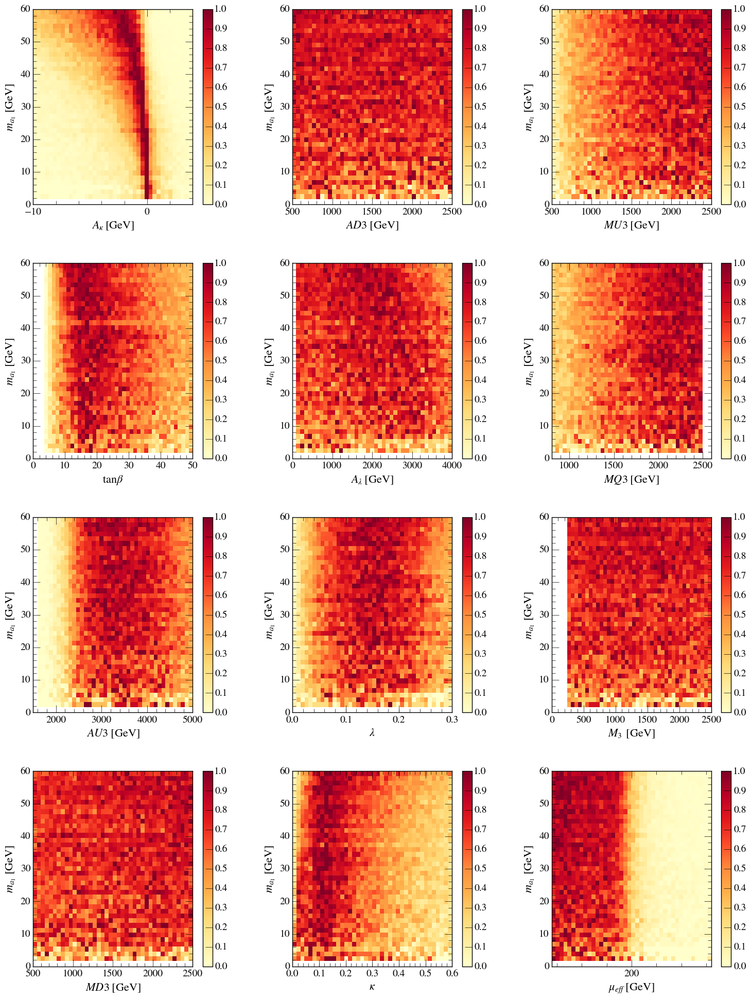

In [40]:
plot_input_params_hist2d(df=df_pass_all.query('pass_HSHB'), 
# plot_input_params_hist2d(df=df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                         yvar='ma1',
                         ylabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                         param_dict=nmssm_params_extended,
                         cmap='YlOrRd', norm_axis='y',
#                          norm=LogNorm(vmin=1E-3), 
#                          norm=Normalize(vmin=0, vmax=1), 
                         bins=[40,40])


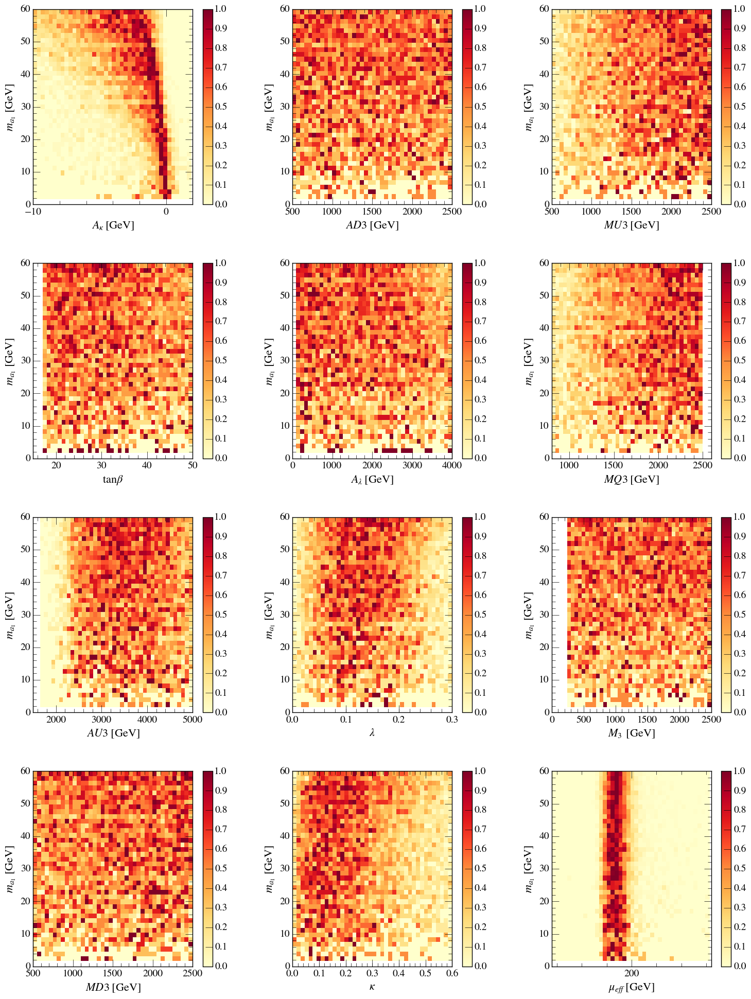

In [41]:
# plot_input_params_hist2d(df=df.query('HSprob>0.05 & HBresult==1'), 
plot_input_params_hist2d(df=df_pass_all.query('pass_strict'), 
                         yvar='ma1',
                         ylabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                         param_dict=nmssm_params_extended,
                         cmap='YlOrRd', norm_axis='y',
#                          norm=LogNorm(vmin=1E-3), 
#                          norm=Normalize(vmin=0, vmax=1), 
                         bins=[40,40])


In [42]:
@save_fig
def plot_ma1_akappa_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='akappa', yvar='ma1', 
                         bins=[40, 40], norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
    #                      norm=LogNorm(),
                         xlabel=r'$A_{\kappa}$', ylabel=M_A1_STR)

Setting backend png
Setting backend png


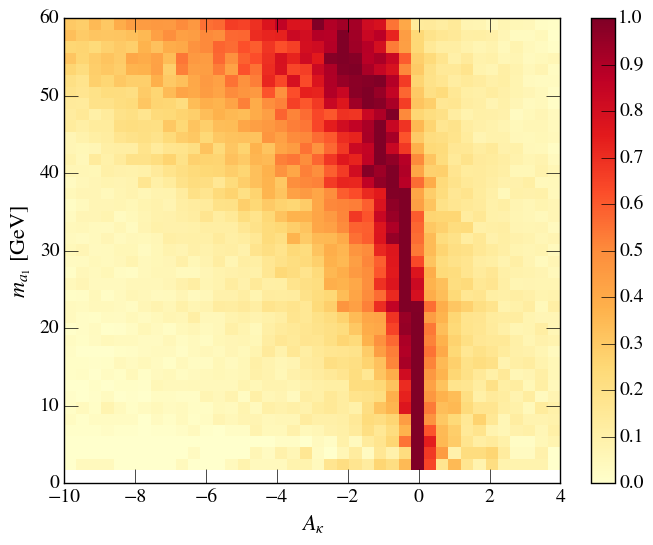

In [43]:
plot_ma1_akappa_hist2d(df_pass_all, filename='Thesis_plots_5/Masses/ma1_akappa_hist2d.png')

In [44]:
@save_fig
def plot_ma1_tgbeta_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='tgbeta', yvar='ma1', 
                         bins=[30, 30],  norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
#                          norm=LogNorm(),
                         xlabel=TGBETA_STR, ylabel=M_A1_STR, vmin=0)
    

Setting backend png
Setting backend png


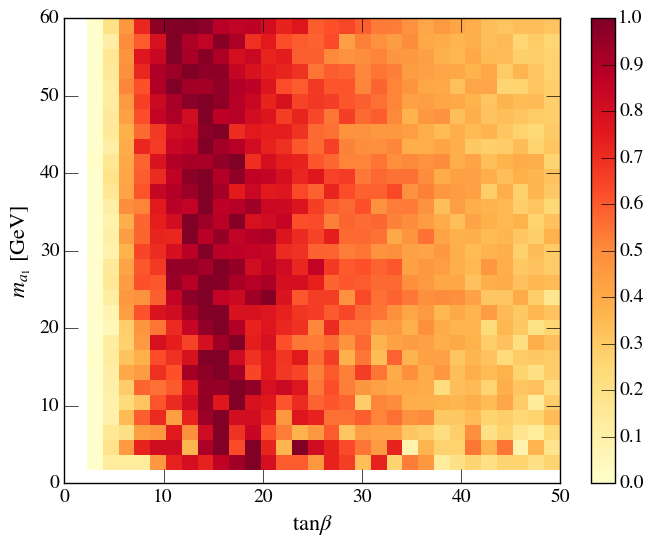

In [45]:
plot_ma1_tgbeta_hist2d(df_pass_all, filename='Thesis_plots_5/Masses/ma1_tgbeta_hist2d.png')

In [46]:
@save_fig
def plot_ma1_kappa_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='kappa', yvar='ma1', 
                         bins=[40, 40], norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
    #                      norm=LogNorm(),
                         xlabel=KAPPA_STR, ylabel=M_A1_STR)

Setting backend png
Setting backend png


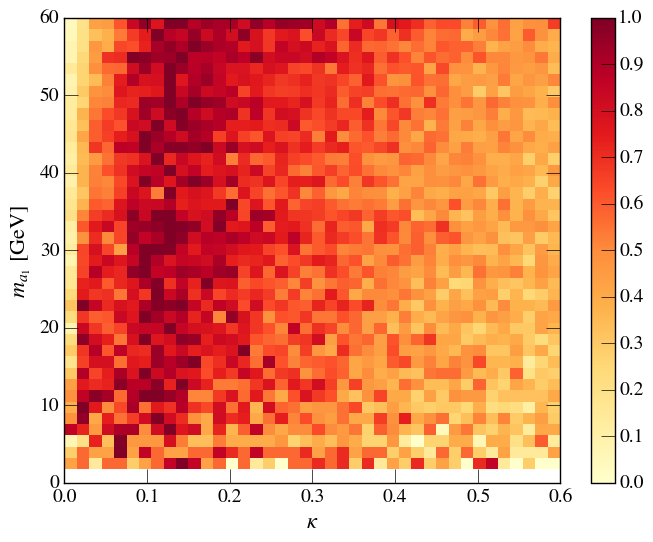

In [47]:
plot_ma1_kappa_hist2d(df_pass_all, filename='Thesis_plots_5/Masses/ma1_kappa_hist2d.png')

In [48]:
@save_fig
def plot_ma1_lambda_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='lambda_', yvar='ma1', 
                         bins=[40, 40], norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
    #                      norm=LogNorm(),
                         xlabel=LAMBDA_STR, ylabel=M_A1_STR)

Setting backend png
Setting backend png


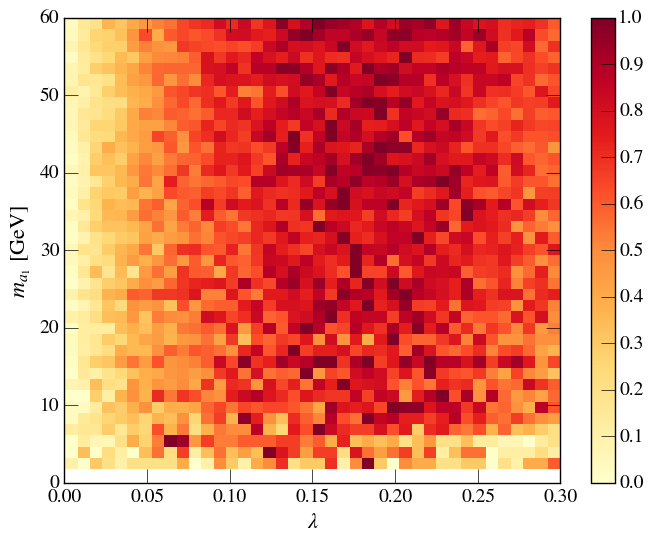

In [49]:
plot_ma1_lambda_hist2d(df_pass_all, filename='Thesis_plots_5/Masses/ma1_lambda_hist2d.png')

## h1

In [50]:
@save_fig
def plot_mh1_inputparams(df, title, yrange=[0, 150]):
    plot_input_params_scatters(df, 'mh1', r'$m_{h_1}\ \mathrm{[GeV]}$', 
                               yrange=yrange, 
                               title=title, cols=2, s=SIZE)

Setting backend png
Setting backend png


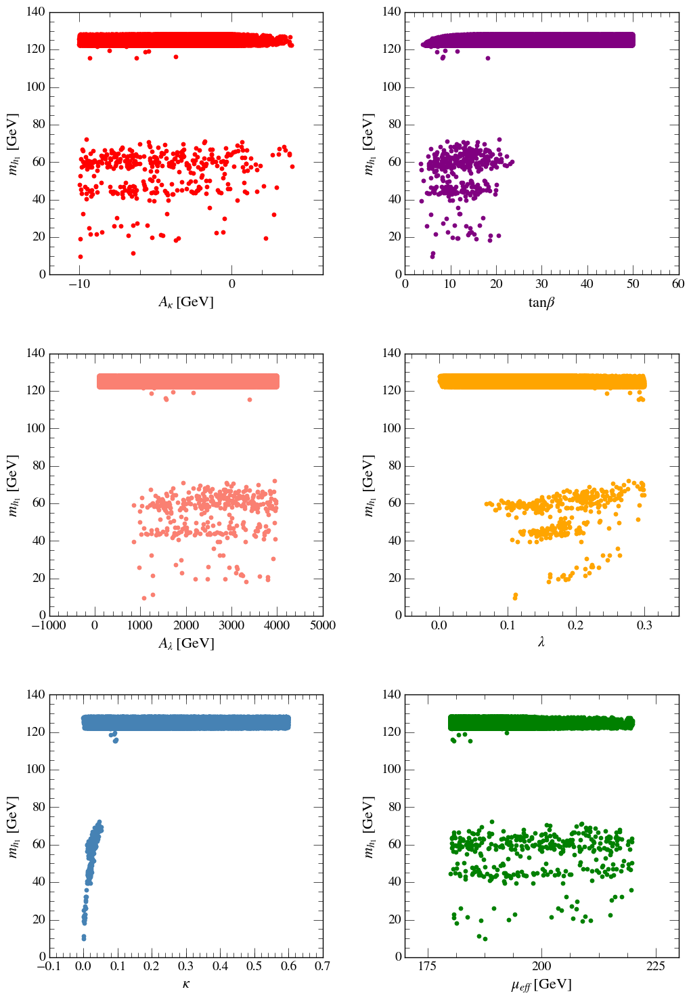

In [51]:
plot_mh1_inputparams(df_pass_all.query('pass_NT'), 
                     title, filename='Thesis_plots_5/Masses/mh1_inputparams_relaxed.png', yrange=[0, 140])

Setting backend png
Setting backend png


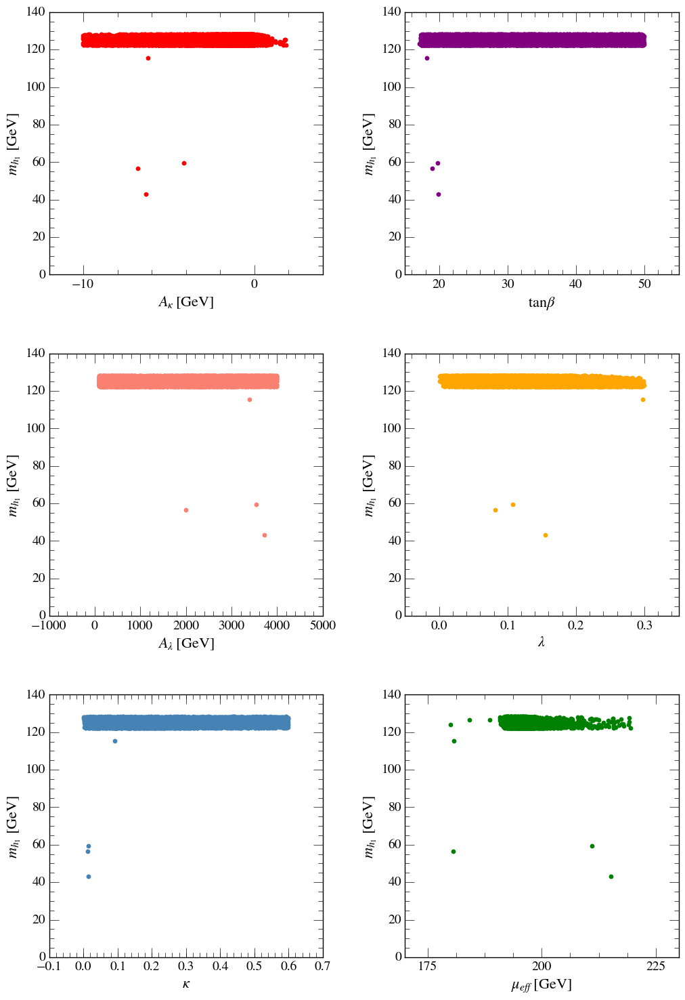

In [52]:
plot_mh1_inputparams(df_pass_all.query('pass_strict'), 
                     title='', filename='Thesis_plots_5/Masses/mh1_inputparams_strict.png', yrange=[0, 140])

Setting backend png
Setting backend png


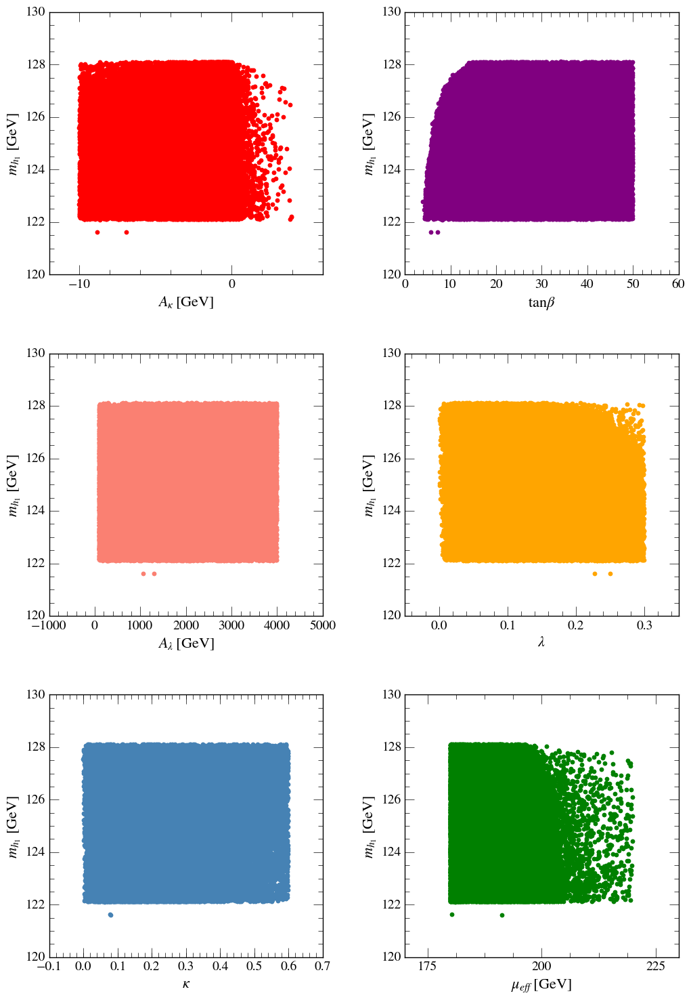

In [53]:
plot_mh1_inputparams(df_pass_all.query('pass_NT'), 
                     title, filename='Thesis_plots_5/Masses/mh1_inputparams_relaxed_h125.png', yrange=[120,130])

Setting backend png
Setting backend png


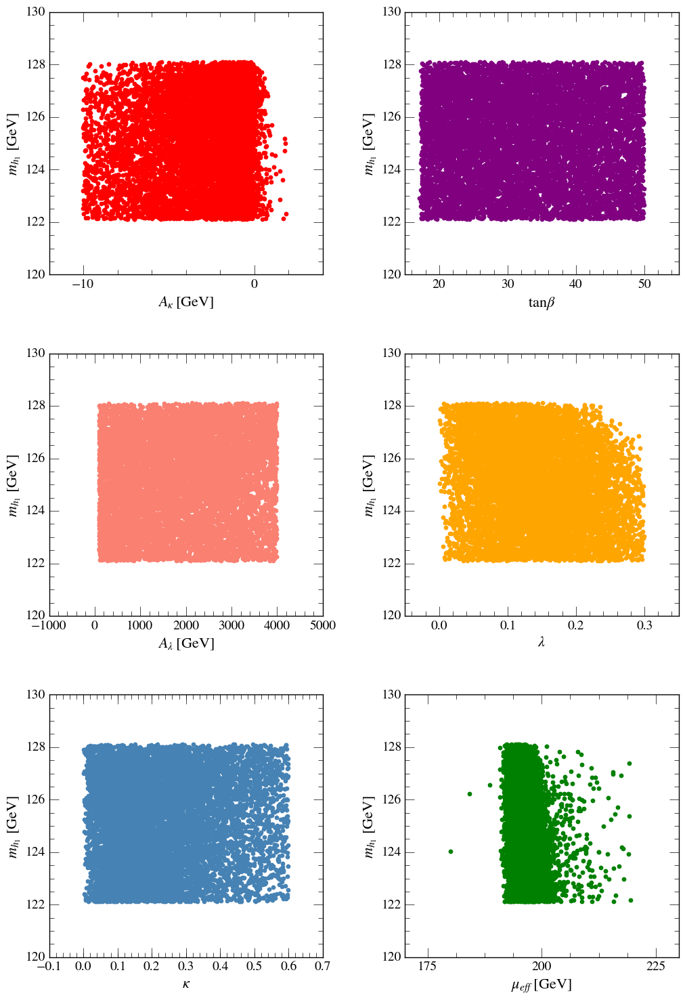

In [54]:
plot_mh1_inputparams(df_pass_all.query('pass_strict'), 
                     title='', filename='Thesis_plots_5/Masses/mh1_inputparams_strict_h125.png', yrange=[120,130])

In [55]:
@save_fig
def plot_mh1_input_hist2d(df, vars=None):
    plist = vars or nmssm_params_extended.keys()
    custom_dict = {k:v for k, v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_hist2d(df=df, 
                             yvar='mh1',
                             ylabel=M_H1_STR, 
                             param_dict=custom_dict,
                             norm_axis='y',
                             cmap='YlOrRd',
#                              norm=LogNorm(), 
                             bins=[30, 30])


Setting backend png
Setting backend png


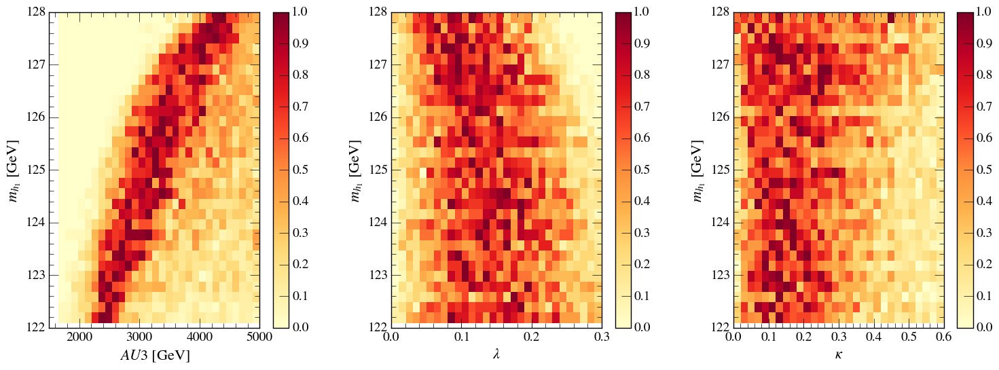

In [56]:
plot_mh1_input_hist2d(df_pass_all.query('pass_strict & 122<mh1<128'),
# plot_mh1_input_hist2d(df_pass_all.query('122<mh1<128'),
                      vars=['au3', 'lambda_', 'kappa'],
                      filename='Thesis_plots_5/Masses/mh1_input_hist2d.png')

In [57]:
@save_fig
def plot_mh1_input_scatter(df, vars=None):
    plist = vars or nmssm_params_extended.keys()
    custom_dict = {k:v for k, v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_scatters(df=df, 
                             yvar='mh1',
                             ylabel=M_H1_STR, alpha=0.1,
                             param_dict=custom_dict)

Setting backend png
Setting backend png


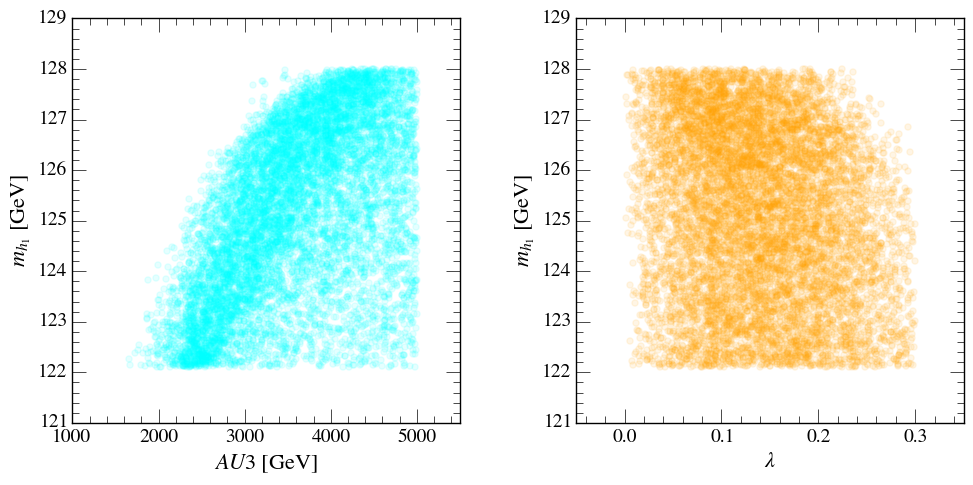

In [58]:
plot_mh1_input_scatter(df_pass_all.query('pass_strict & 122<mh1<128'),
# plot_mh1_input_hist2d(df_pass_all.query('122<mh1<128'),
                      vars=['au3', 'lambda_'],
                      filename='Thesis_plots_5/Masses/mh1_input_scatter.png')

## h2

In [59]:
@save_fig
def plot_mh2_inputparams(df, title):
    plot_input_params_scatters(df, 'mh2', r'$m_{h_2}\ \mathrm{[GeV]}$', 
                               yrange=[120, 140], 
                               title=title, cols=2, s=SIZE)

Setting backend png
Setting backend png


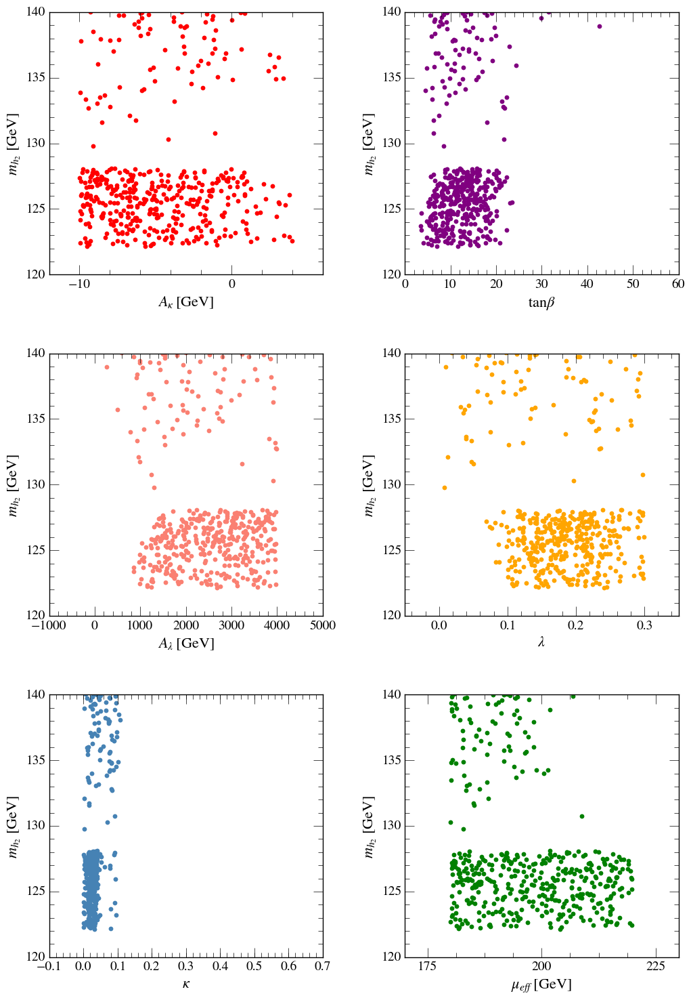

In [60]:
plot_mh2_inputparams(df_pass_all.query('pass_NT'), 
                     title, filename='Thesis_plots_5/Masses/mh2_inputparams_relaxed.png')

Setting backend png
Setting backend png


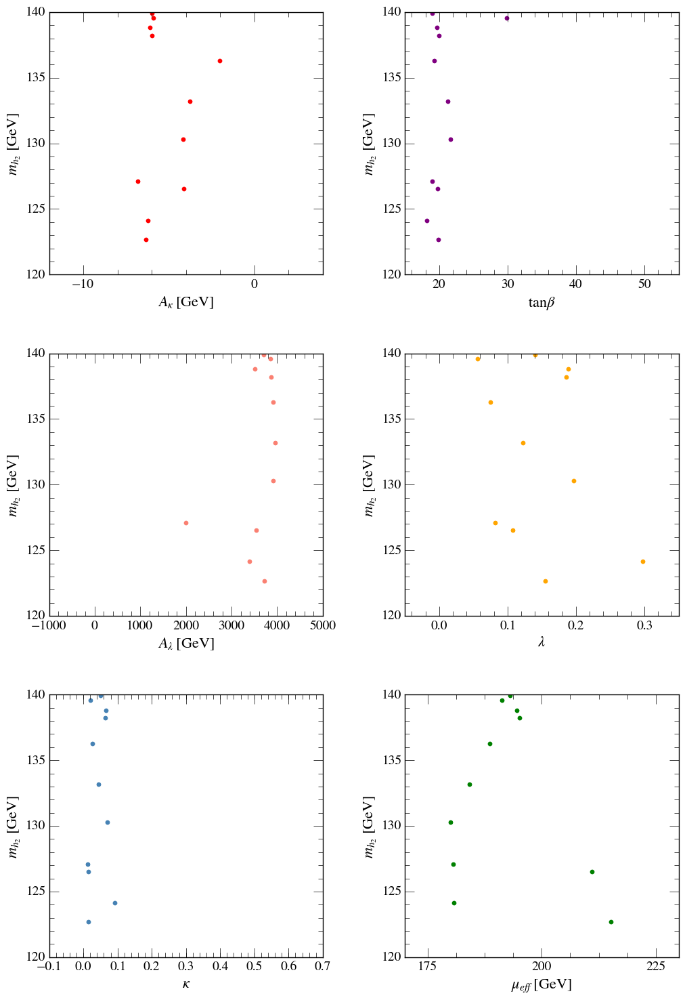

In [61]:
plot_mh2_inputparams(df_pass_all.query('pass_strict'), 
                     title='', filename='Thesis_plots_5/Masses/mh2_inputparams_strict.png')

In [62]:
title = ''

In [63]:
@save_fig
def plot_mh1_ma1_scatter(df, title):
    plot_scatter(df=df, xvar='ma1', yvar='mh1', 
                 xlabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                 ylabel=r'$m_{h_1}\ \mathrm{[GeV]}$',
                 color='dodgerblue', s=SIZE)
    plt.xlim(0, 60)
    plt.ylim(0, 140)
    plt.title(title)
    
    xmin, xmax = plt.xlim()
    ymin, ymax = xmin, xmax
    plt.plot([xmin, xmax], [ymin, ymax], linestyle='dashed', 
             label=r'$m_{h_1} =\ m_{a_1}$', linewidth=2)

#     plt.plot([xmin, xmax], [2*ymin, 2*ymax], linestyle='dashed', color='red',
#              label=r'$m_{h_1} =\ 2m_{a_1}$', linewidth=2)

#     plt.plot([xmin, xmax], [62.5, 62.5], linestyle='dashed', color='purple',
#              label=r'$m_{h_1} =\ 62.5\ \mathrm{GeV}$', linewidth=2)

    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'Y', color='k', alpha=1, fill=False,
                          label=r'$125 \pm 3\ \mathrm{GeV}$', hatch='xxx')
    
#     make_highlight_region(plt.gca(), [0, 62.5], 
#                           'Y', color='darkorchid', alpha=0.25, fill=True,
#                           label=r'$h_2 \to 2h_1\ \mathrm{allowed}$')

#     poly = patches.Polygon([[0, 0], [60, 0], [60, 62.5], [62.5/2, 62.5]], closed=True, 
    poly = patches.Polygon([[0, 0], [60, 0], [60, 62.5], [0, 62.5]], closed=True, 
                           color='darkorchid', fill=True, hatch='//', 
                           label=r'$h_2 \to 2h_1\ \mathrm{allowed}$', alpha=0.25)
    plt.gca().add_patch(poly)
    
    poly2 = patches.Polygon([[0, 0], [62.5/2, 62.5], [0, 62.5]], closed=True, 
                           fill=True, color='red', hatch=r"\\",
                           label=r'$h_2 \to 2h_1 \to 4a_1\ \mathrm{allowed}$', alpha=0.25)
    plt.gca().add_patch(poly2)

#     make_highlight_region(plt.gca(), [0, 62.5], 
#                           'Y', color='purple', alpha=0.2,
#                           label=r'$h_2 \to 2h_1\ \mathrm{allowed}$')

    plt.legend(loc='lower right', frameon=True, bbox_to_anchor=(1,0), framealpha=0.8, fontsize=14)
    plt.tight_layout()


Setting backend png
Setting backend png


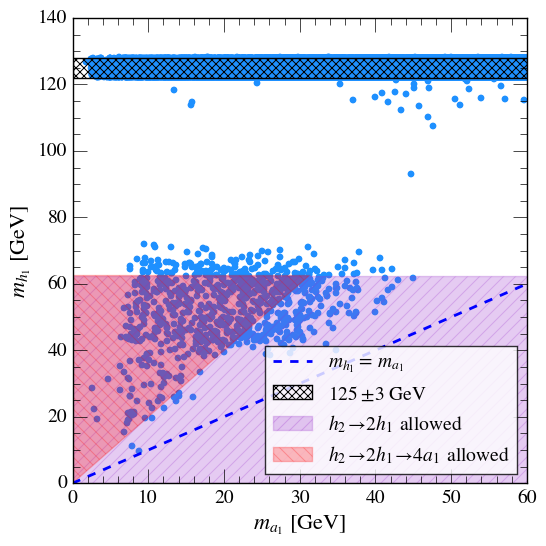

In [64]:
plot_mh1_ma1_scatter(df_pass_all, title, filename='Thesis_plots_5/Masses/mh1_ma1_relaxed.png')

Setting backend png
Setting backend png


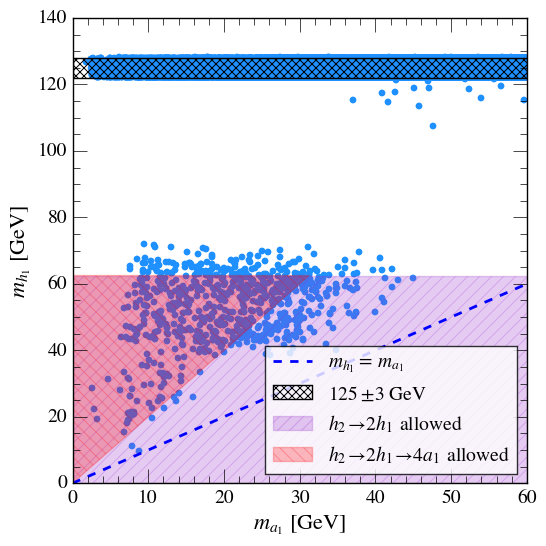

In [65]:
plot_mh1_ma1_scatter(df_pass_all.query('pass_HSHB'), 
                     title, filename='Thesis_plots_5/Masses/mh1_ma1_HSHB.png')

Setting backend png
Setting backend png


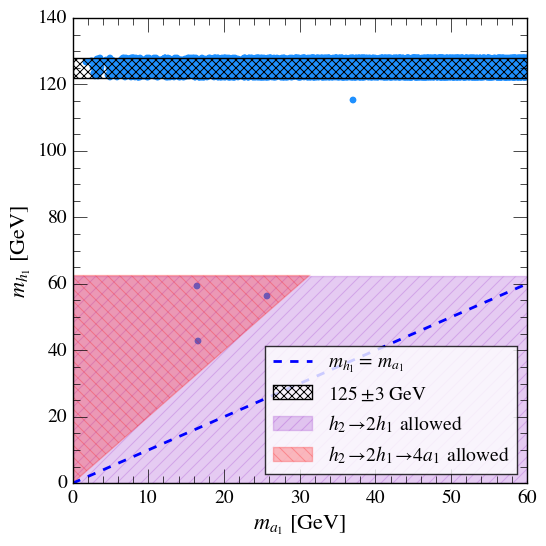

In [66]:
plot_mh1_ma1_scatter(df_pass_all.query('pass_strict'), 
                     title, filename='Thesis_plots_5/Masses/mh1_ma1_strict.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x120962fd0>,
 array([   0.,    0.,    0.,    1.,    5.,   74.,   83.,   56.,   12.,
          72.,   58.,   85.,  103.,  156.,  175.,  175.,  202.,  207.,
         195.,  235.]),
 array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
          4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
          9. ,   9.5,  10. ]),
 <a list of 20 Patch objects>)

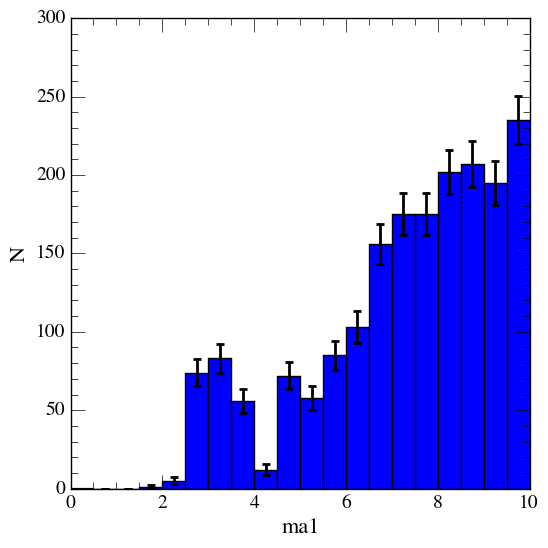

In [67]:
plot_histogram(df=df_pass_all.query('122.1<mh1<128.1'), var='ma1', bins=20, range=[0,10])

In [68]:
dff = df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('mh2<128.1')
nu_tautau =  dff['xsec_8_ggf_h2_2h1_4b'] * dff['Brh1a1a1'] * dff['Brh1a1a1'] * dff['Bra1tautau'] * dff['Bra1tautau'] / (dff['Brh1bb'] * dff['Brh1bb'])
nu_tautau = nu_tautau.dropna()

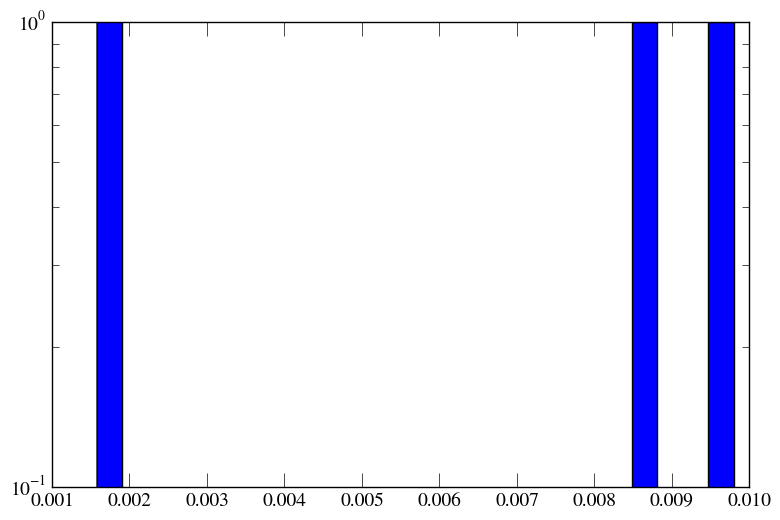

In [69]:
plt.hist(nu_tautau.values, bins=25)
plt.ylim(bottom=0.1)
plt.yscale('log')

In [70]:
dff = df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('mh2<128.1')
nu_bb =  dff['xsec_8_ggf_h2_2h1_4b'] * dff['Brh1a1a1'] * dff['Brh1a1a1'] * dff['Bra1bb'] * dff['Bra1bb'] / (dff['Brh1bb'] * dff['Brh1bb'])
nu_bb = nu_bb.dropna()

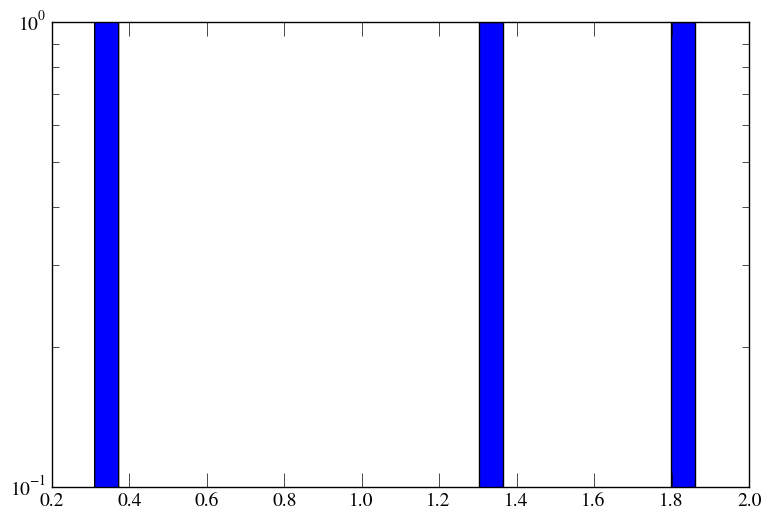

In [71]:
plt.hist(nu_bb.values, bins=25)
plt.ylim(bottom=0.1)
plt.yscale('log')

In [72]:
@save_fig
def plot_mh2_ma1_scatter(df, title):
    plot_scatter(df=df, xvar='ma1', yvar='mh2', 
                 xlabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                 ylabel=r'$m_{h_2}\ \mathrm{[GeV]}$', 
                 color='green', s=SIZE)
    plt.xlim(0, 60)
    plt.ylim(80, 220)
#     plt.yscale('log')
    plt.title(title)
    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'Y', color='k', alpha=1, fill=False, hatch="xxx", 
                          label=r'$125 \pm 3\ \mathrm{GeV}$')
    plt.legend(loc='lower right', frameon=False)
    plt.tight_layout()


Setting backend png
Setting backend png


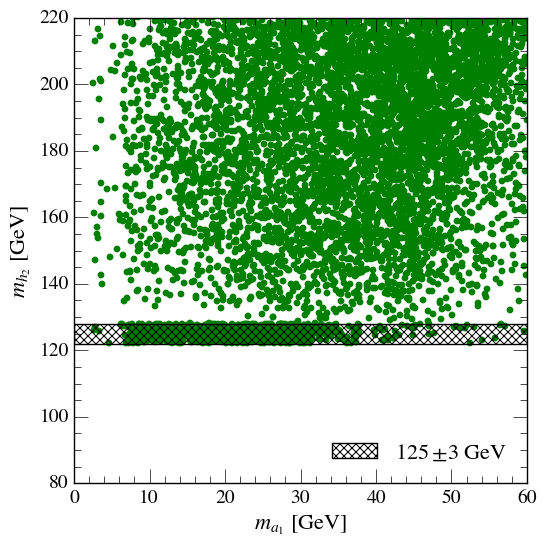

In [73]:
plot_mh2_ma1_scatter(df_pass_all, title, filename='Thesis_plots_5/Masses/mh2_ma1_relaxed.png')

In [74]:
@save_fig
def plot_mh2_ma1_hist2d(df, title):
    plot_histogram2d(df=df.query('120 < mh2<220'), 
                     xvar='ma1', yvar='mh2', 
                     xlabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                     ylabel=r'$m_{h_2}\ \mathrm{[GeV]}$', 
                     bins=[40,40],
                     norm_axis='x',
                     cmap='YlOrRd')
    plt.xlim(0, 60)
    plt.ylim(120, 220)
#     plt.yscale('log')
    plt.title(title)
#     make_highlight_region(plt.gca(), [125-3, 125+3], 
#                           'Y', color='k', alpha=1, fill=False, hatch="xxx", 
#                           label=r'$125 \pm 3\ \mathrm{GeV}$')
    plt.legend(loc='lower right', frameon=False)
    plt.tight_layout()


Setting backend png


/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/axes/_axes.py:475: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


Setting backend png


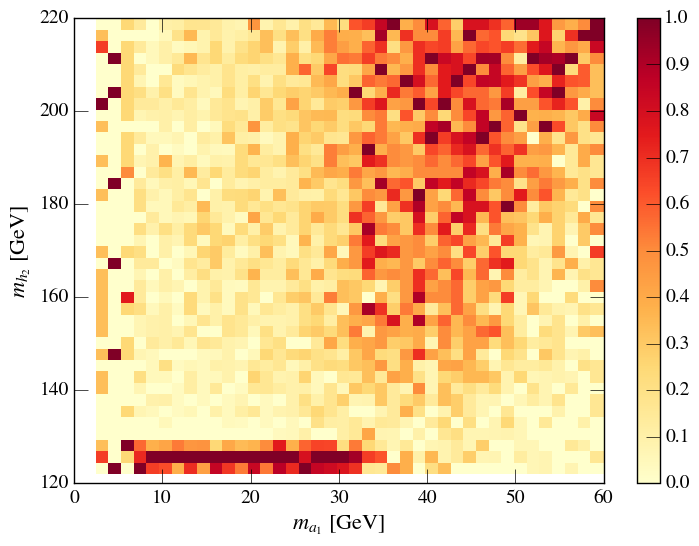

In [75]:
plot_mh2_ma1_hist2d(df_pass_all, title, filename='Thesis_plots_5/Masses/mh2_ma1_hist2d.png')

In [76]:
@save_fig
def plot_mh2_mh1_scatter(df, title):
    plot_scatter(df=df, xvar='mh1', yvar='mh2', 
                 xlabel=r'$m_{h_1}\ \mathrm{[GeV]}$', 
                 ylabel=r'$m_{h_2}\ \mathrm{[GeV]}$',
                 color='red', s=SIZE)
    plt.xlim(0, 140)
    plt.ylim(80, 220)
    
    xmin, xmax = plt.xlim()
    ymin, ymax = xmin, xmax
    plt.plot([xmin, xmax], [ymin, ymax], linestyle='dashed', 
             label=r'$m_{h_2} =\ m_{h_1}$', linewidth=2)

    plt.title(title)
    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'X', color='k', alpha=1, fill=False, hatch='xxx')
    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'Y', color='k', alpha=1, fill=False, hatch='xxx', 
                          label=r'$125 \pm 3\ \mathrm{GeV}$')
    plt.legend(loc='upper left', frameon=False)
    plt.tight_layout()

Setting backend png
Setting backend png


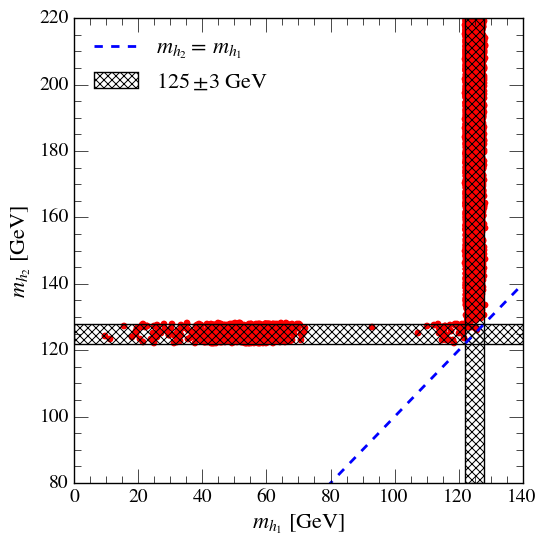

In [77]:
plot_mh2_mh1_scatter(df_pass_all, title, filename='Thesis_plots_5/Masses/mh2_mh1_relaxed.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x12230d550>,
 <matplotlib.collections.PathCollection at 0x120a4bd90>)

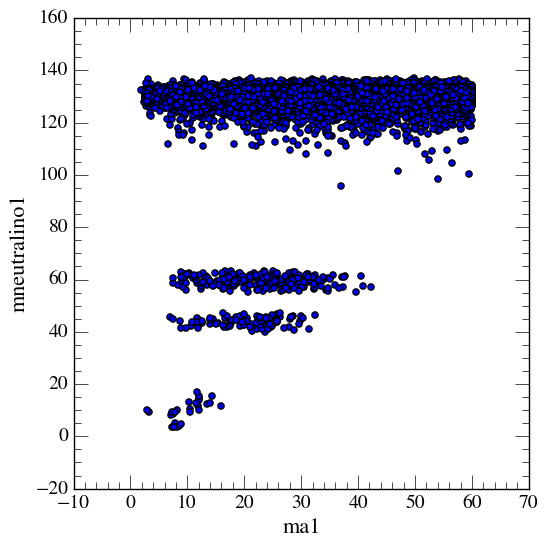

In [78]:
plot_scatter(df=df_pass_all.query('pass_NT'), xvar='ma1', yvar='mneutralino1')

(<matplotlib.axes._subplots.AxesSubplot at 0x120a5b150>,
 <matplotlib.collections.PathCollection at 0x1634ae450>)

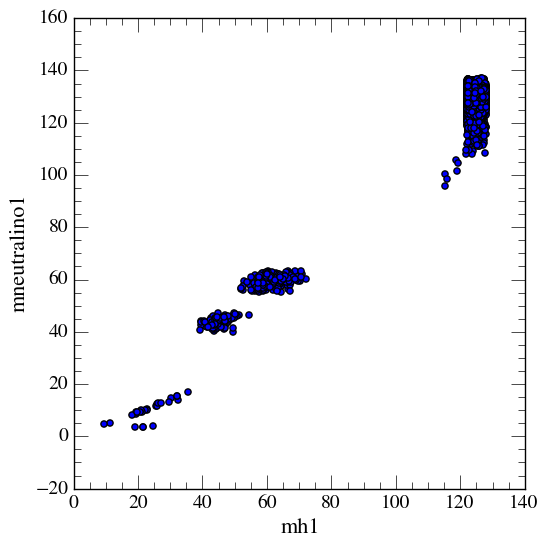

In [79]:
plot_scatter(df=df_pass_all.query('pass_NT'), xvar='mh1', yvar='mneutralino1')

(<matplotlib.axes._subplots.AxesSubplot at 0x11ff4a7d0>,
 <matplotlib.collections.PathCollection at 0x11f059b90>)

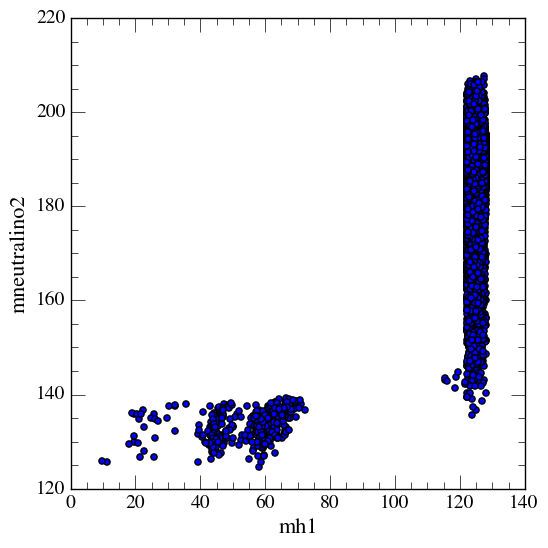

In [80]:
plot_scatter(df=df_pass_all.query('pass_NT'), xvar='mh1', yvar='mneutralino2')

(<matplotlib.axes._subplots.AxesSubplot at 0x11fd698d0>,
 <matplotlib.collections.PathCollection at 0x12def0290>)

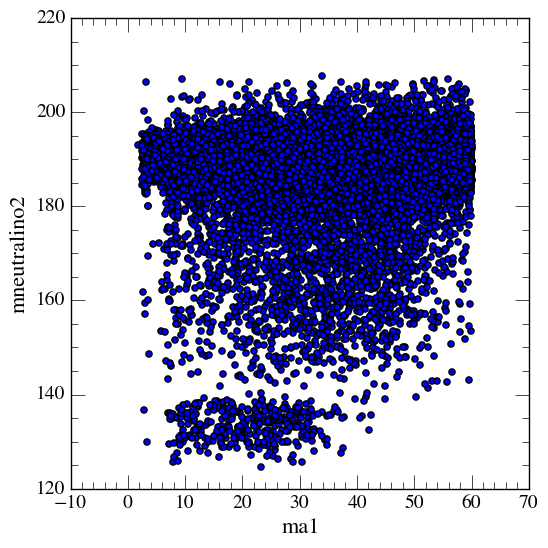

In [81]:
plot_scatter(df=df_pass_all.query('pass_NT'), xvar='ma1', yvar='mneutralino2')

In [94]:
@save_fig
def plot_mass_corrs(df, title):
    cols = ['mh1', 'mh2', 'mh3', 'mhc', 'ma1', 'ma2', 'mneutralino1', 'mneutralino2', 'mstop1', 'mstop2', 'msbottom1', 'msbottom2', 'mgluino']
    df = df[cols]
    pd.tools.plotting.scatter_matrix(df, figsize=[20, 20], alpha=0.7, grid=True, hist_kwds={'bins': 25}, color='red')
    plt.suptitle(title, y=0.93)

Setting backend png
Setting backend png


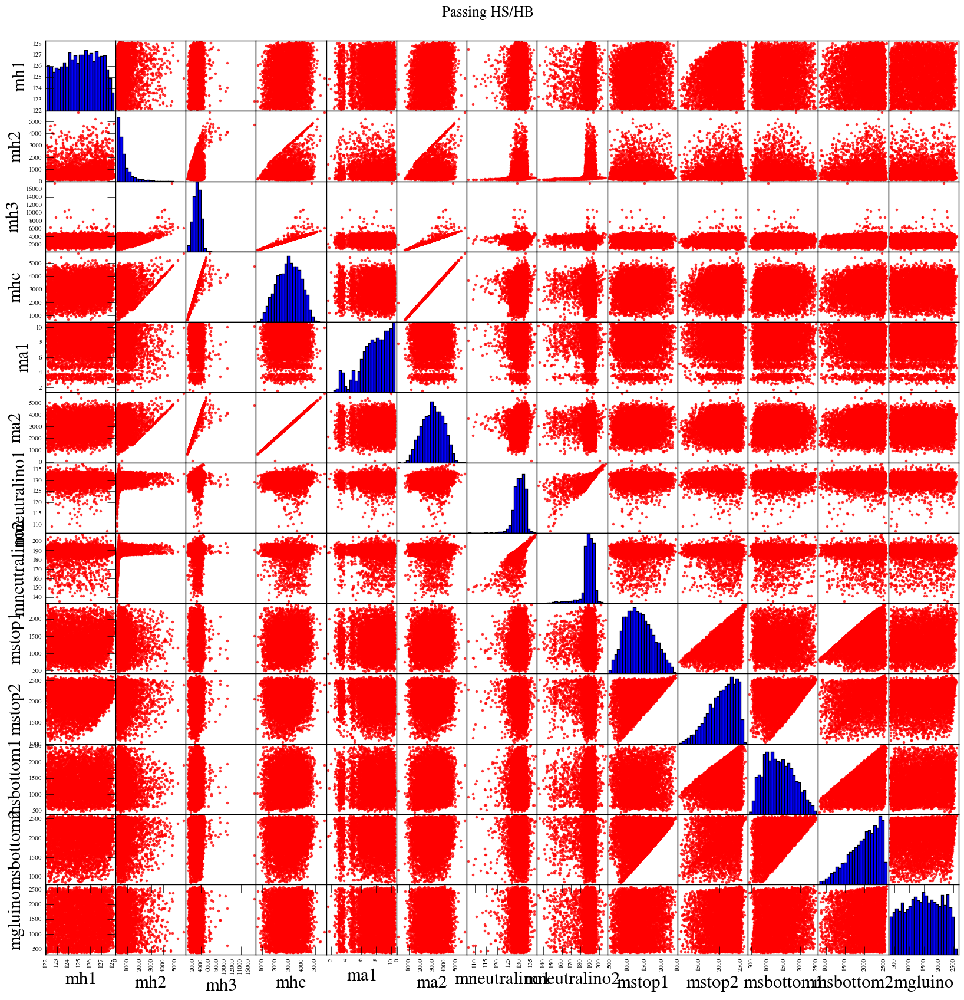

In [79]:
plot_mass_corrs(df_pass_all.query('122.1<mh1<128.1 & mh2>128.1 & ma1<10.5 & pass_HSHB'), 
                'Passing HS/HB', filename='Thesis_plots_5/Masses/mass_corr_HSHB_h1.png')

Setting backend png
Setting backend png


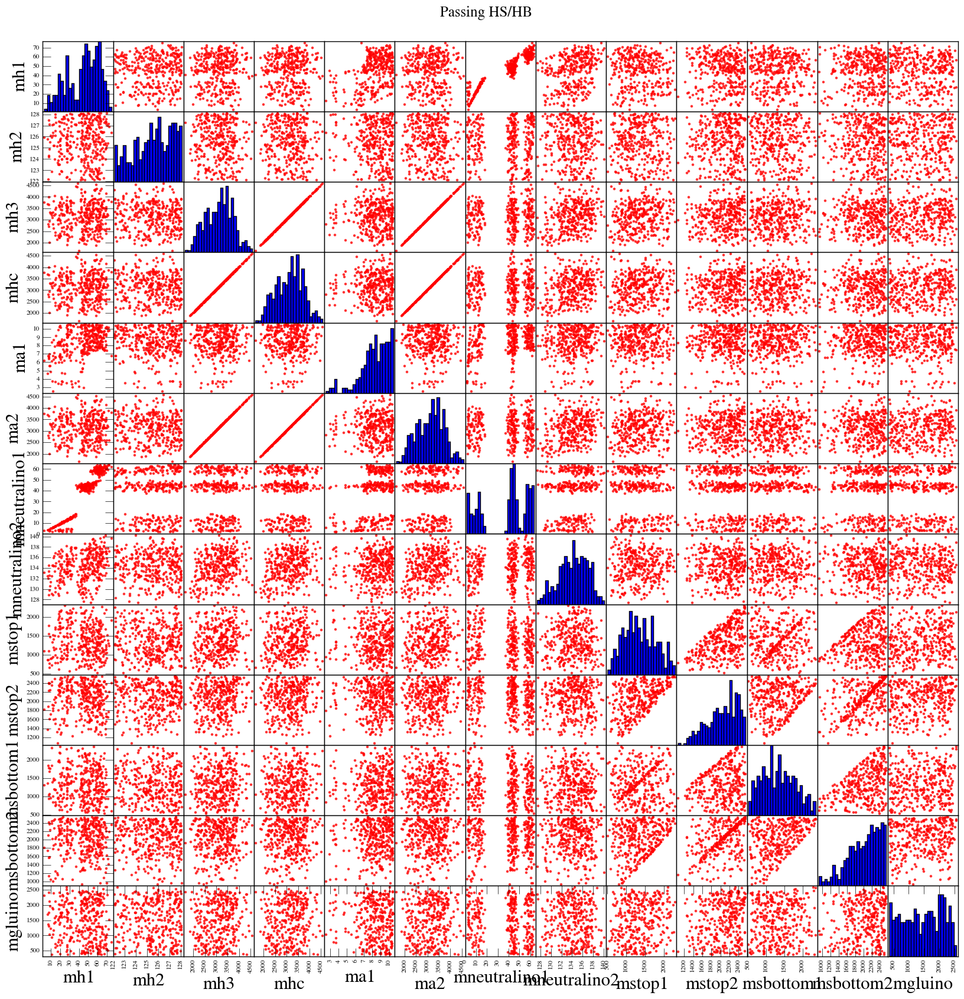

In [80]:
plot_mass_corrs(df_pass_all.query('122.1<mh2<128.1 & mh1<122.1 & ma1<10.5 & pass_HSHB'), 
                'Passing HS/HB', filename='Thesis_plots_5/Masses/mass_corr_HSHB_h2.png')

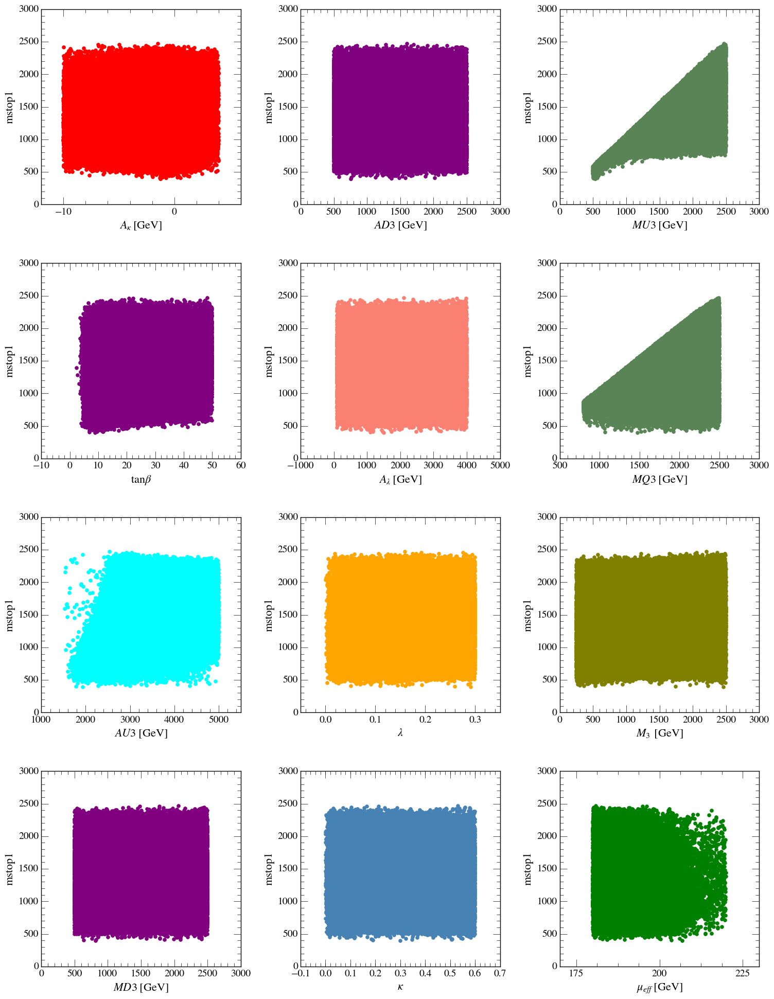

In [82]:
plot_input_params_scatters(df_pass_all, yvar='mstop1', ylabel='mstop1', param_dict=nmssm_params_extended)

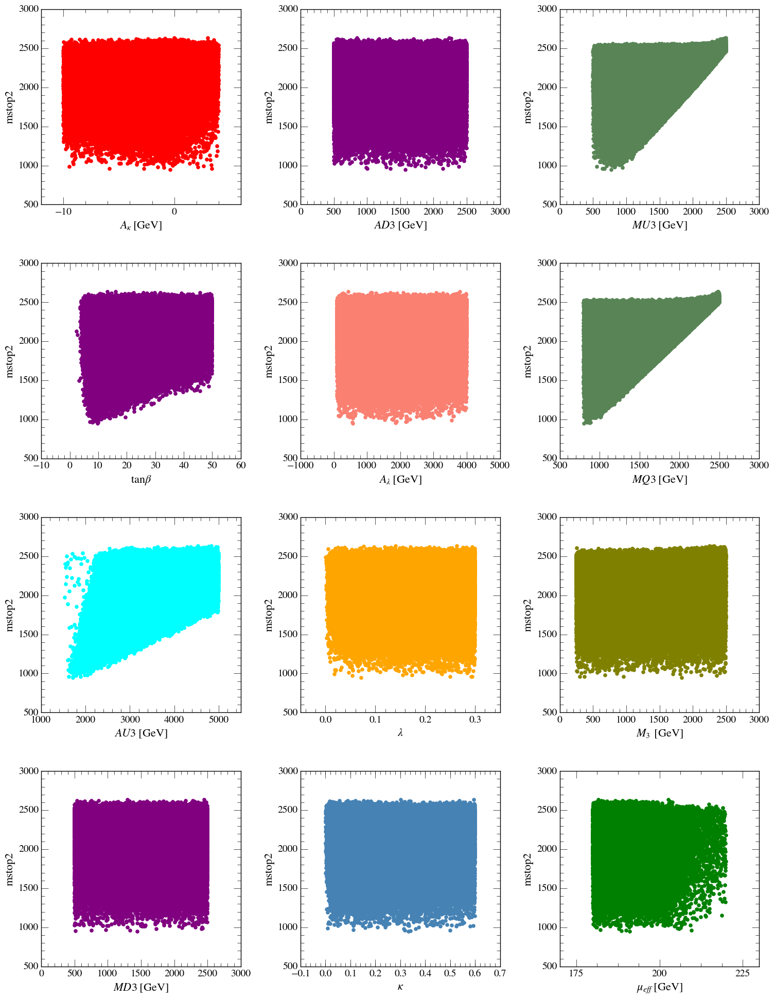

In [83]:
plot_input_params_scatters(df_pass_all, yvar='mstop2', ylabel='mstop2', param_dict=nmssm_params_extended)

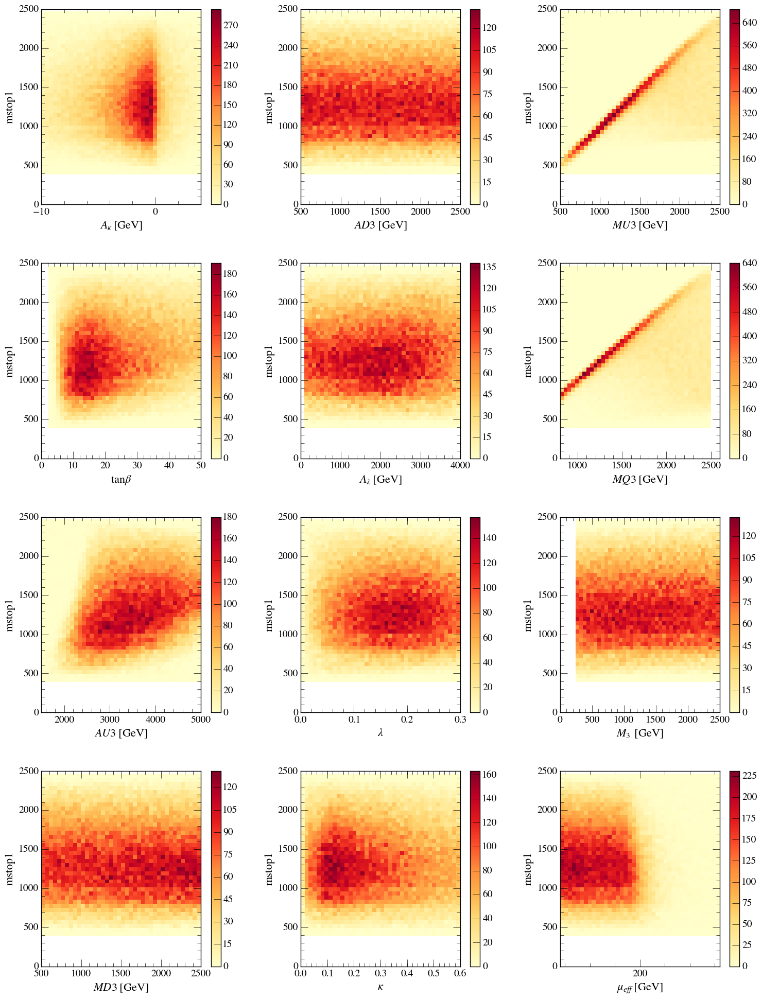

In [84]:
plot_input_params_hist2d(df_pass_all, yvar='mstop1', ylabel='mstop1', 
                         param_dict=nmssm_params_extended, 
                         bins=[40,40], cmap='YlOrRd')

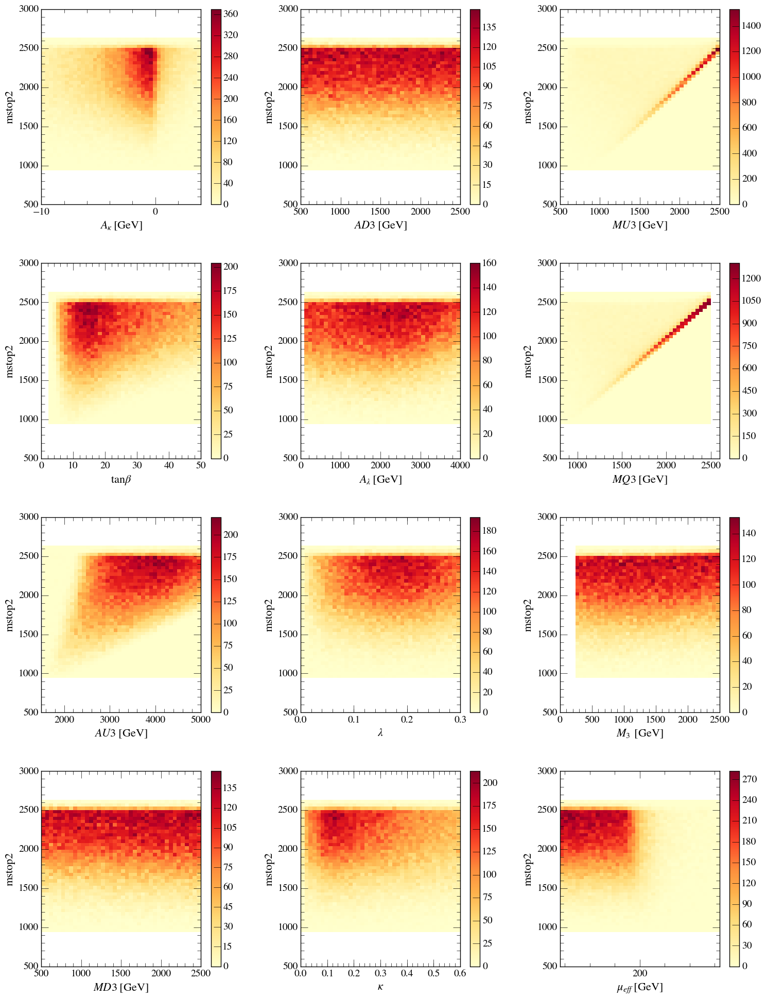

In [85]:
plot_input_params_hist2d(df_pass_all, yvar='mstop2', ylabel='mstop2', 
                         param_dict=nmssm_params_extended, 
                         bins=[40,40], cmap='YlOrRd')

#  Reduced couplings, BR

In [86]:
@save_fig
def plot_h1ggrc2_scatter(df):
    plot_input_params_scatters_multiple(dfs=[df.query('122.1<mh1<128.1'), df.query('mh1<122.1')], 
                                        yvar='h1ggrc2', ylabel=r"$g_{ggh_1}^2$", 
                                        param_dict=nmssm_params_extended,
                                        kwargs=[{'color':'dodgerblue', 'label':r'$h_1\ =\ h_{125}$'}, 
                                                {'color':'orange', 'marker': 'd', 'label': r'$h_1\ \neq\ h_{125}$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

Setting backend png
Setting backend png


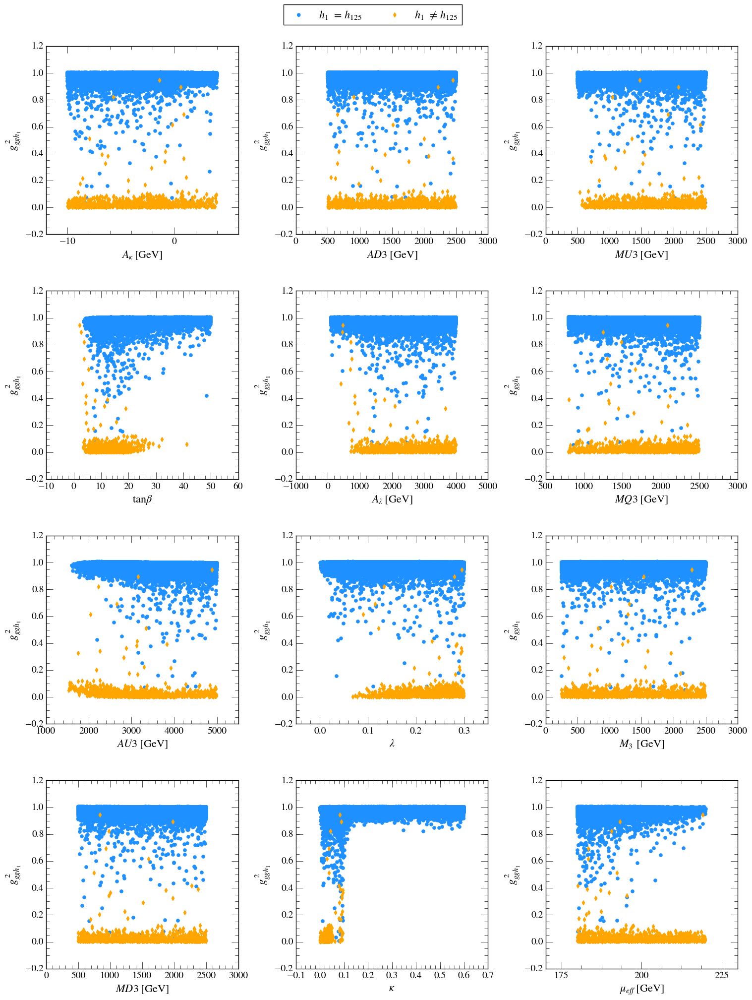

In [87]:
plot_h1ggrc2_scatter(df_pass_all, filename='Thesis_plots_5/Couplings_BR/h1ggrc2_scatter.png')

Setting backend png
Setting backend png


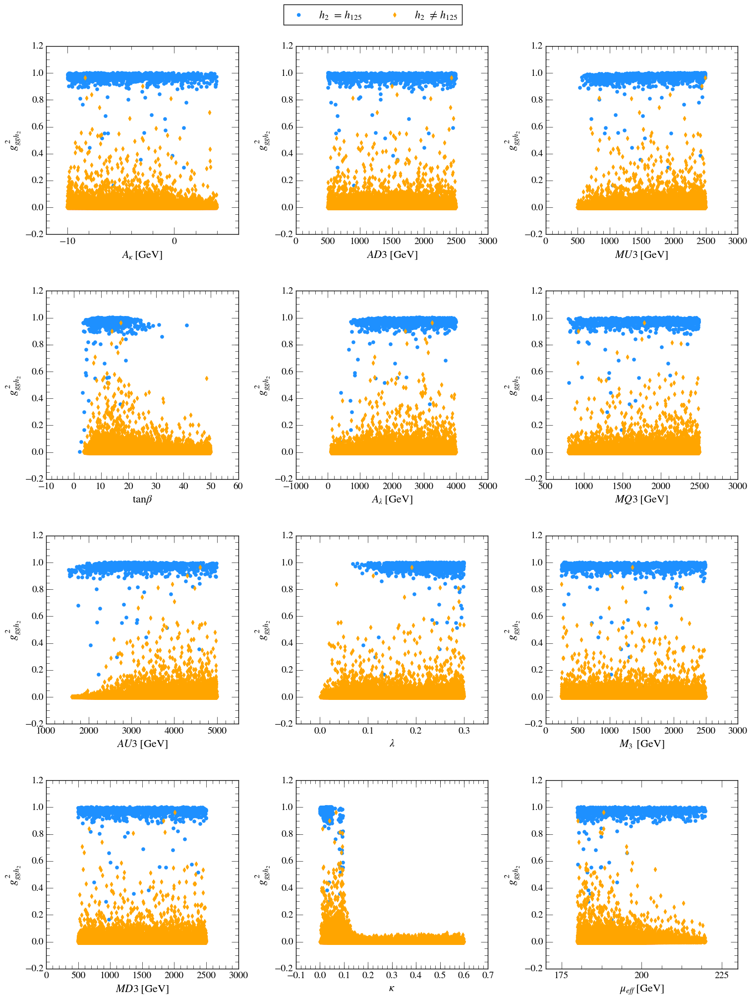

In [88]:
@save_fig
def plot_h2ggrc2_scatter(df):
    plot_input_params_scatters_multiple(dfs=[df.query('122.1<mh2<128.1'), df.query('mh2>128.1')], 
                                        yvar='h2ggrc2', ylabel=r"$g_{ggh_2}^2$", 
                                        param_dict=nmssm_params_extended,
                                        kwargs=[{'color':'dodgerblue', 'label':r'$h_2\ =\ h_{125}$'}, 
                                                {'color':'orange', 'marker': 'd', 'label': r'$h_2\ \neq\ h_{125}$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_h2ggrc2_scatter(df_pass_all, filename='Thesis_plots_5/Couplings_BR/h2ggrc2_scatter.png')

Setting backend png
Setting backend png


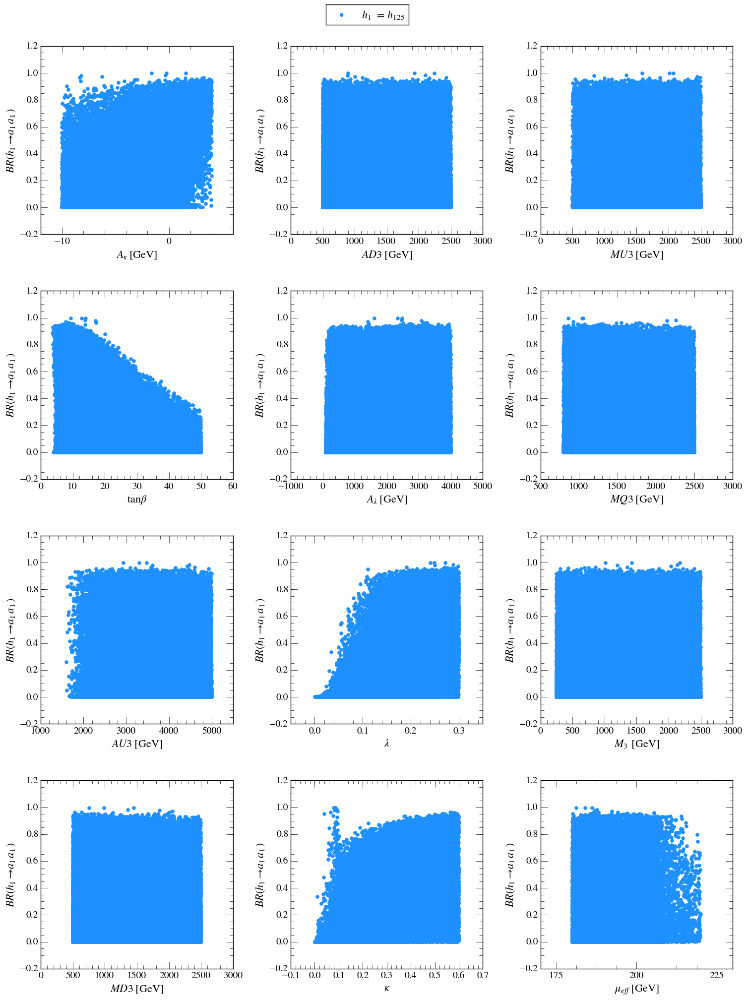

In [89]:
@save_fig
def plot_brh1a1a1_scatter(df):
    plot_input_params_scatters_multiple(dfs=[df.query('122.1<mh1<128.1')],
#                                              , df[~df.constraints.str.contains('chi2')].query('122.1<mh1<128.1')], 
                                        yvar='Brh1a1a1', ylabel=r"$BR(h_1\to a_1a_1)$", 
                                        param_dict=nmssm_params_extended,
                                        kwargs=[
                                            {'color':'dodgerblue', 'label':r'$h_1\ =\ h_{125}$'}])
#                                             {'color':'green', 'label': 'Pass NT '+r'$\chi^2$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_brh1a1a1_scatter(df_pass_all, filename='Thesis_plots_5/Couplings_BR/Brh1a1a1_scatter.png')

Setting backend png
Setting backend png


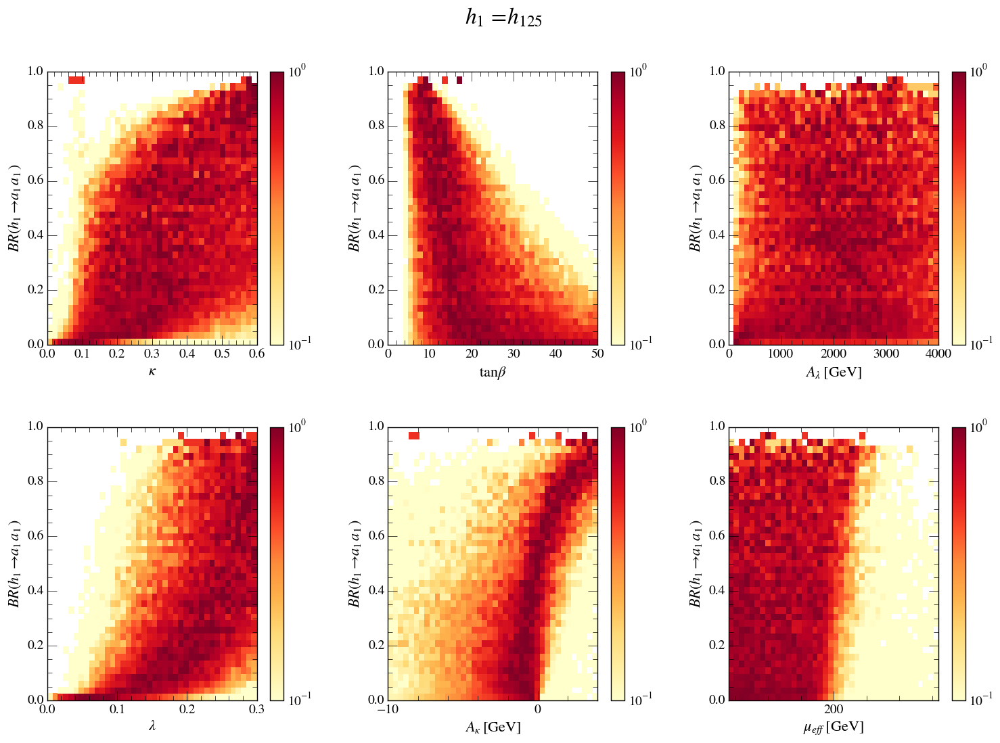

In [90]:
@save_fig
def plot_brh1a1a1_hist2d(df):
    plist = ['akappa', 'tgbeta', 'alambda', 'kappa', 'lambda_', 'mueff']
    custom_params = {k:v for k,v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_hist2d(df=df.query('122.1<mh1<128.1 & mh2>128.1 & Brh1a1a1>0'), 
                             yvar='Brh1a1a1', ylabel=r"$BR(h_1\to a_1a_1)$", 
                             param_dict=custom_params,
                             norm=LogNorm(vmin=1E-1),
                             bins=[40,40],
                             norm_axis='y',
                             cmap='YlOrRd',
                             label=r'$h_1\ =\ h_{125}$')
    plt.suptitle(r'$h_1 = h_{125}$')
    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.2))

plot_brh1a1a1_hist2d(df_pass_all, filename='Thesis_plots_5/Couplings_BR/Brh1a1a1_hist2d.png')

Setting backend png
Setting backend png


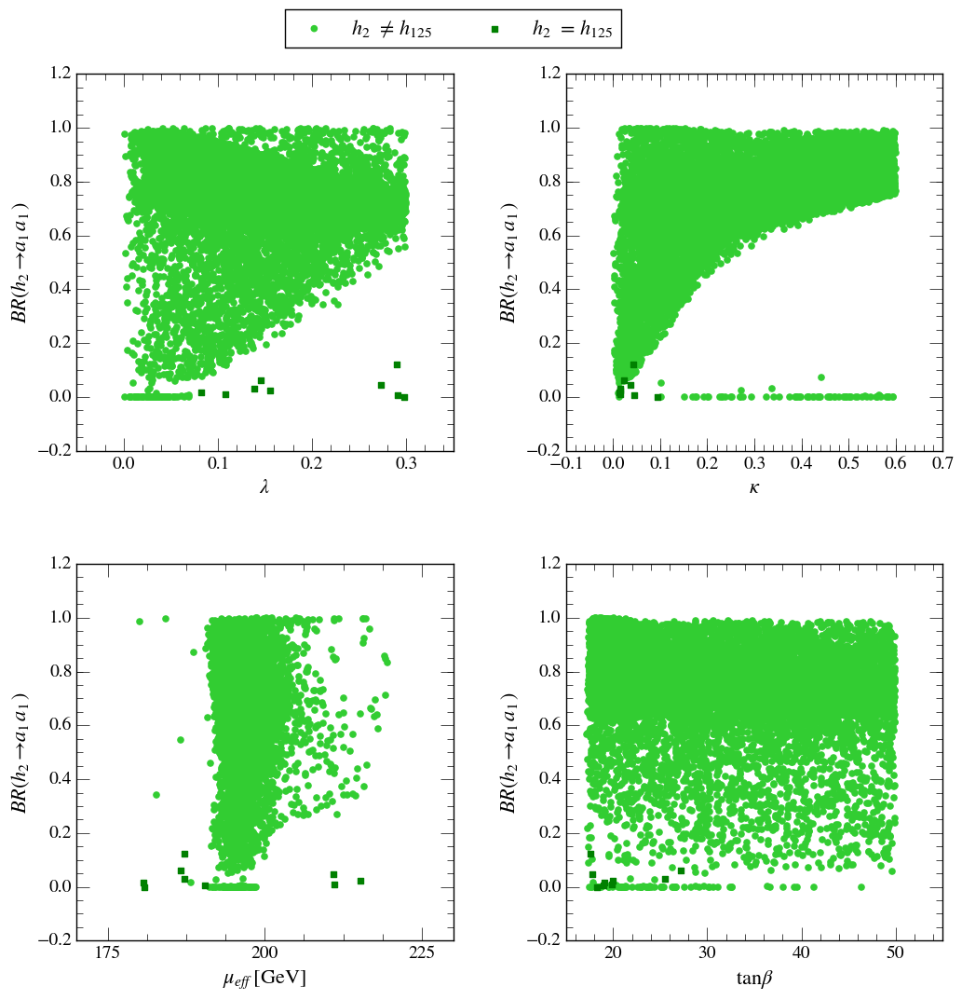

In [91]:
@save_fig
def plot_brh2a1a1_scatter(df):
    plist = ['tgbeta', 'kappa', 'lambda_', 'mueff']
#     plist = nmssm_params_extended.keys()
    custom_params = {k:v for k,v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_scatters_multiple(dfs=[df.query('mh2>129.1'), 
                                             df.query('mh1<122.1 & 122.1<mh2<128.1')], 
                                        yvar='Brh2a1a1', ylabel=r"$BR(h_2\to a_1a_1)$", 
                                        param_dict=custom_params,
                                        cols=2,
                                        kwargs=[
                                           {'color':'limegreen', 'label':r'$h_2\ \neq\ h_{125}$'},
                                           {'color':'green', 'label':r'$h_2\ =\ h_{125}$', 'marker':'s'}
                                        ])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1, 1.2))

plot_brh2a1a1_scatter(df_pass_all.query('pass_HSHB & pass_del_a_mu & pass_relic'), 
                      filename='Thesis_plots_5/Couplings_BR/Brh2a1a1_scatter.png')

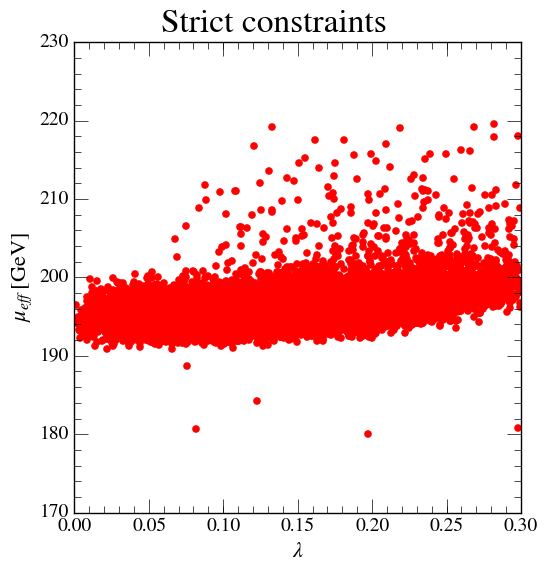

In [92]:
_ = plot_scatter(df=df_pass_all.query('pass_strict'), 
                 xvar='lambda_', xlabel=LAMBDA_STR,
                 yvar='mueff', ylabel=MUEFF_STR, 
                 color='red')
plt.xlim(0, 0.3)
plt.suptitle('Strict constraints')
plt.savefig('Thesis_plots_5/mueff_lambda_strict.png')

(100, 1000)

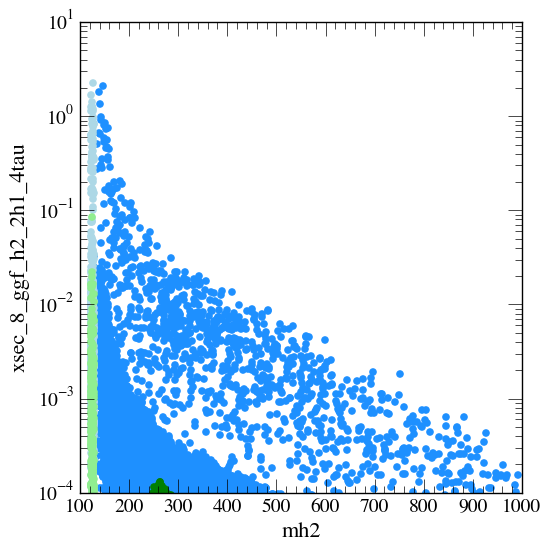

In [93]:
plot_scatter(df=df_pass_all.query('pass_HSHB & 128.1<mh2<1000'), 
             xvar='mh2', yvar='xsec_8_ggf_h2_2a1_4tau', color='dodgerblue')
plot_scatter(ax=plt.gca(), df=df_pass_all.query('pass_HSHB & 122.1<mh2<128.1'), 
             xvar='mh2', yvar='xsec_8_ggf_h2_2a1_4tau', color='lightblue')
plot_scatter(ax=plt.gca(), df=df_pass_all.query('pass_HSHB & 128.1<mh2<1000'), 
             xvar='mh2', yvar='xsec_8_ggf_h2_2h1_4tau', color='green')
plot_scatter(ax=plt.gca(), df=df_pass_all.query('pass_HSHB & 122.1<mh2<128.1'), 
             xvar='mh2', yvar='xsec_8_ggf_h2_2h1_4tau', color='lightgreen')
plt.yscale('log')
plt.ylim(1E-4, 10)
plt.xlim(100, 1000)
# plt.xscale('log')

Setting backend png
Setting backend png


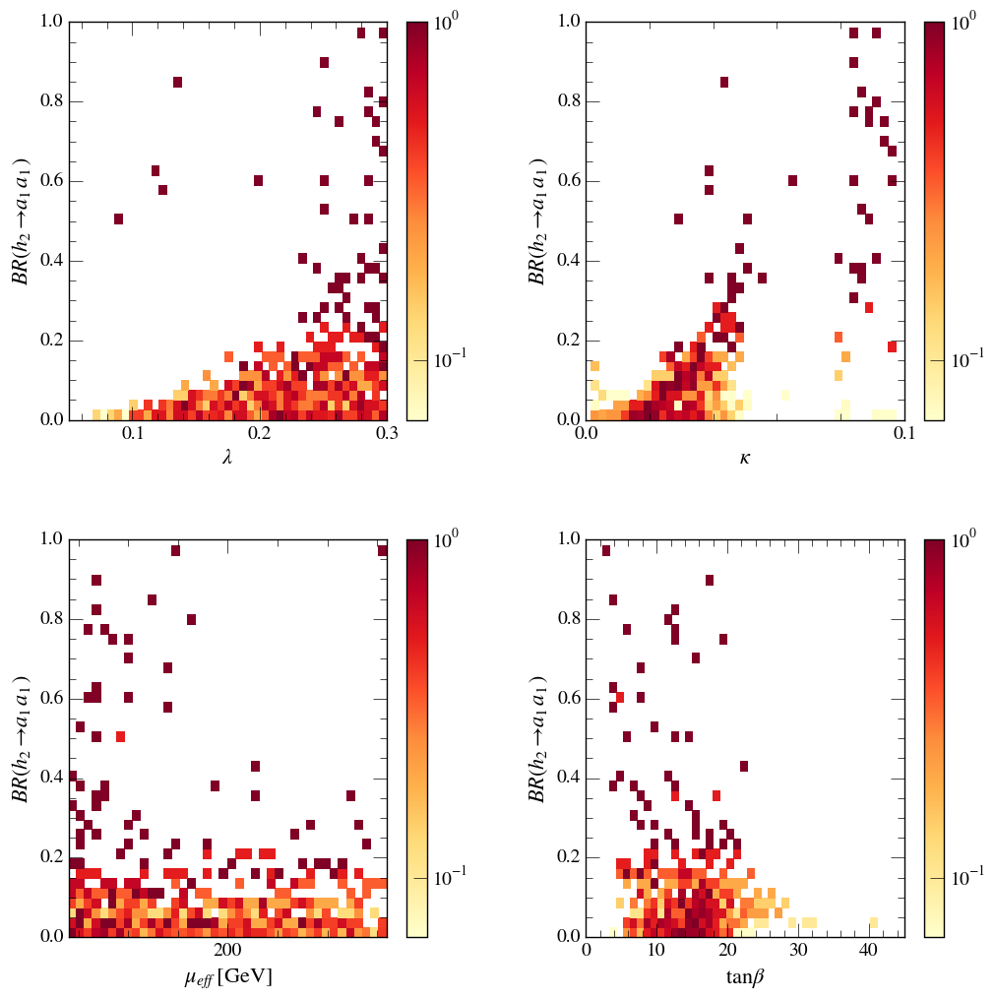

In [94]:
@save_fig
def plot_brh2a1a1_hist2d(df):
    plist = ['tgbeta', 'kappa', 'lambda_', 'mueff']
    custom_params = {k:v for k,v in nmssm_params_extended.iteritems() if k in plist}

    plot_input_params_hist2d(df=df.query('122.1<mh2<128.1 & Brh1a1a1>0'), 
                             yvar='Brh2a1a1', ylabel=r"$BR(h_2\to a_1a_1)$", 
                             param_dict=custom_params,
                             norm=LogNorm(),
                             bins=[40,40],
                             norm_axis='y',
                             cmap='YlOrRd',
                             cols=2,
                             label=r'$h_2\ =\ h_{125}$')
 
    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_brh2a1a1_hist2d(df_pass_all, filename='Thesis_plots_5/Couplings_BR/Brh2a1a1_hist2d.png')

In [95]:
import math

def plot_contours(ax, xlim=[0, 1], ylim=[0, 1], n_div=15, log_steps=False):
    """For contours of constant BR * ggh^2"""
    delta = min(xlim[1], ylim[1])/40.
    # generate a grid of x and y values
    x = np.arange(xlim[0], xlim[1]+delta, delta)
    y = np.arange(ylim[0], ylim[1]+delta, delta)
    X, Y = np.meshgrid(x, y)
    # generate a grid of the product of these values
    Z = X * Y

    if log_steps:
        max_v = xlim[1] * ylim[1]
        min_v = xlim[0] * ylim[0]
        print math.log(max_v, 10)-5, math.log(max_v, 10)+1
        n_div = np.logspace( math.log(max_v, 10)-5, math.log(max_v, 10)+1, num=7)

    manual_locations = [(math.sqrt(x), math.sqrt(x)) for x in n_div]
    manual_locations[-1] = (0.55, n_div[-1]/0.55)
    CS = ax.contour(X, Y, Z, n_div, colors='k')
    ax.clabel(CS, inline=1, fontsize=16, fmt='%g', manual=manual_locations)


@save_fig    
def plot_grc2_br(df, mass_range, title):
    fig, ax = generate_fig_axes(size=(8,7))

    n_div = [1E-2, 2E-2, 5E-2, 1E-1, 2E-1, 5E-1]
    plot_contours(plt.gca(), n_div=n_div)

    F = 3

    df = df.query('%f<ma1<%f' % (mass_range[0], mass_range[1]))
    plot_scatter(ax=ax, df=df.query('122.1 < mh1 < 128.1 & mh2>128.1'), 
                 xvar='h1ggrc2', yvar='Brh1a1a1', color='blue', 
                 label=r'$h_{125} = h_1,\ h_i = h_1,\ X = a_1$',
                 marker='s', s=F*SIZE, alpha=0.75)
    plot_scatter(ax=plt.gca(), df=df.query('122.1 < mh2 < 128.1'), 
                 xvar='h2ggrc2', yvar='Brh2a1a1', color='red', 
                 label=r'$h_{125} = h_2,\ h_i = h_2,\ X = a_1$',
                 marker='o', s=F*SIZE, alpha=0.95)
    plot_scatter(ax=plt.gca(), df=df.query('122.1 < mh1 < 128.1 & mh2>128.1'), 
                 label=r'$h_{125} = h_1,\ h_i = h_2,\ X = a_1$',
                 xvar='h2ggrc2', yvar='Brh2a1a1', color='purple', 
                 marker='s', s=F*SIZE, alpha=0.75)
    plot_scatter(ax=plt.gca(), df=df.query('122.1 < mh2 < 128.1'), 
                 label=r'$h_{125} = h_2,\ h_i = h_1,\ X = a_1$',
                 xvar='h1ggrc2', yvar='Brh1a1a1', color='green', 
                 marker='o', s=F*SIZE, alpha=0.95)

    plot_scatter(ax=plt.gca(), df=df.query('%f<mh1<%f & 122.1 < mh2 < 128.1' % (mass_range[0], mass_range[1])), 
                 label=r'$h_{125} = h_2,\ h_i = h_2,\ X = h_1$',
                 xvar='h2ggrc2', yvar='Brh2h1h1', color='orange', 
                 marker='^', s=F*SIZE, alpha=0.95)

    plt.xlim(-0.1, 1.1)
    plt.ylim(-0.1, 1.1)


    plt.xlabel(r'$g_{ggh_i}^2$')
    plt.ylabel(r'$BR(h_i \to XX)$')

    plt.legend(loc='upper right', fontsize=15, framealpha=0.85, frameon=False)

    plt.title(title)
    plt.tight_layout()

In [96]:
low_mass_title = r'$m_{X} < 10.5\ \mathrm{GeV}$'
hi_mass_title = r'$12 < m_{X} < 62\ \mathrm{GeV}$'

Setting backend png


/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/text.py:52: UnicodeWarning: Unicode equal comparison failed to convert both arguments to Unicode - interpreting them as being unequal
  if rotation in ('horizontal', None):
/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/text.py:54: UnicodeWarning: Unicode equal comparison failed to convert both arguments to Unicode - interpreting them as being unequal
  elif rotation == 'vertical':


Setting backend png


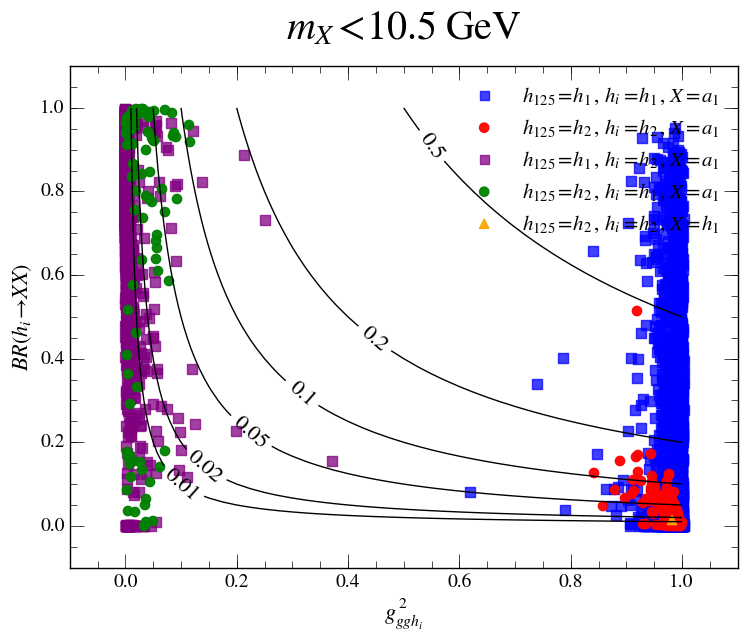

In [97]:
plot_grc2_br(df_pass_all, [0, 10.5], low_mass_title, filename='Thesis_plots_5/Couplings_BR/rc2_br_ma1Lt10p5.png')

Setting backend png
Setting backend png


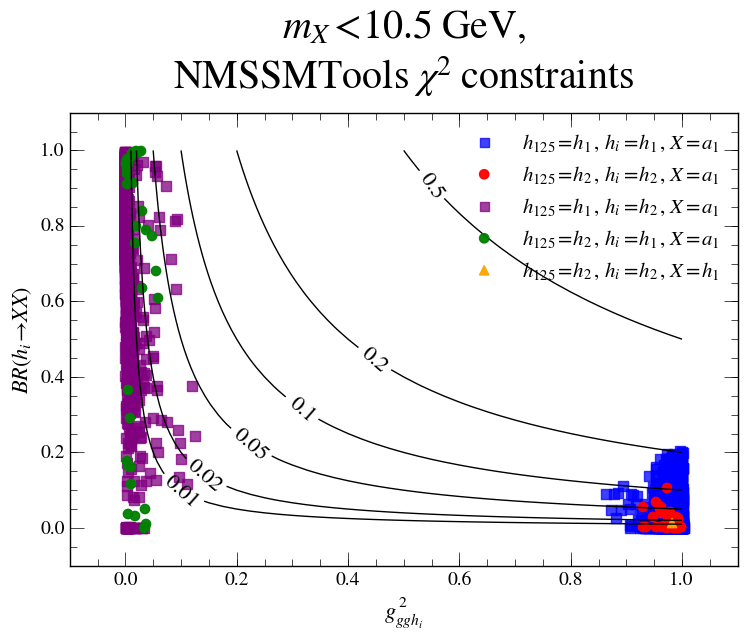

In [98]:
plot_grc2_br(df_pass_all.query('pass_NT'), [0, 10.5], 
             low_mass_title + ",\nNMSSMTools " + r'$\chi^2$' + 'constraints', 
             filename='Thesis_plots_5/Couplings_BR/rc2_br_ma1Lt10p5_NT.png')

Setting backend png
Setting backend png


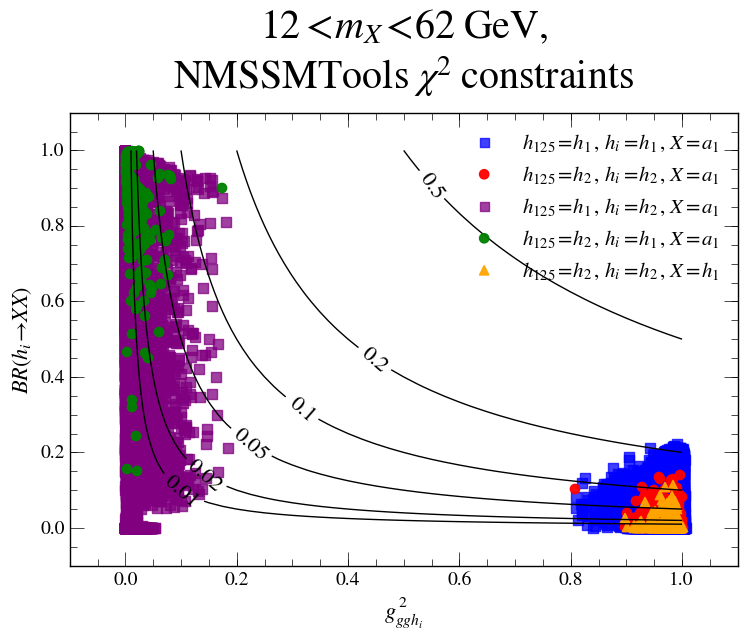

In [99]:
plot_grc2_br(df_pass_all.query('pass_NT'), [12, 62], 
             hi_mass_title + ",\nNMSSMTools " + r'$\chi^2$' + 'constraints', 
             filename='Thesis_plots_5/Couplings_BR/rc2_br_ma1Gt12_NT.png')

Setting backend png
Setting backend png


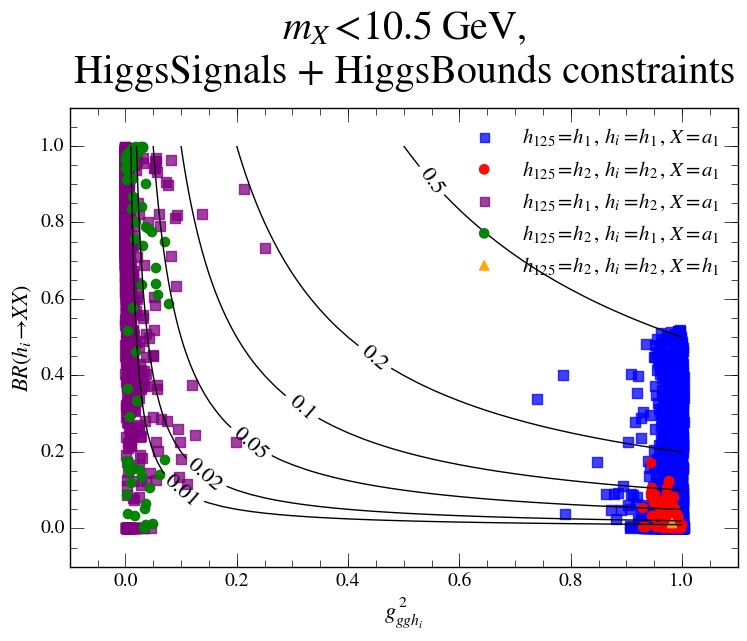

In [100]:
plot_grc2_br(df_pass_all.query('pass_HSHB'), [0, 10.5],
             low_mass_title + ',\nHiggsSignals + HiggsBounds constraints', 
             filename='Thesis_plots_5/Couplings_BR/rc2_br_ma1Lt10p5_HSHB.png')

Setting backend png
Setting backend png


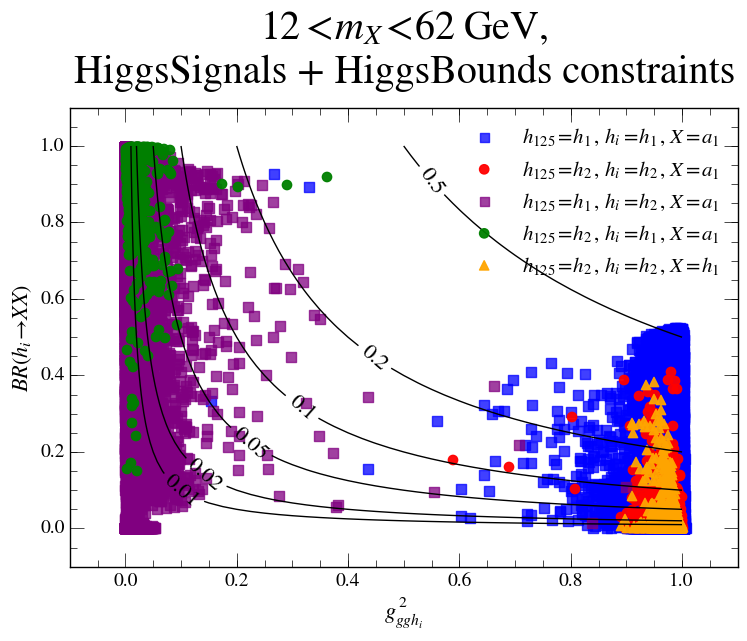

In [101]:
plot_grc2_br(df_pass_all.query('pass_HSHB'), [12, 62],
             hi_mass_title + ',\nHiggsSignals + HiggsBounds constraints', 
             filename='Thesis_plots_5/Couplings_BR/rc2_br_ma1Gt12_HSHB.png')

In [102]:
@save_fig
def plot_h1BR_NT_HSHB(df, title, var, xlim, xlabel, nbins=30, ylim=None, logy=True, leg_loc='best'):
    df = df.query('122.2 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')

    nbins = nbins
    lw = 1
    norm = False
    err = False
    
    plot_histogram(df=df.query('pass_HSHB'), var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw, color='red',
                   errorbars=False, normed=norm)

    plot_histogram(ax=plt.gca(), df=df.query('pass_chi2zz'), var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    plot_histogram(ax=plt.gca(), df=df.query('pass_chi2bb'), var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    plot_histogram(ax=plt.gca(), df=df.query('pass_chi2gg'), var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    plot_histogram(ax=plt.gca(), df=df.query('pass_NT'), var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')


    plt.xlabel(xlabel)
    plt.xlim(*xlim)
    if ylim:
        plt.ylim(*ylim)
    if logy:
        plt.yscale('log')
    plt.legend(loc=leg_loc, fontsize=16, frameon=False)

Setting backend pdf
Setting backend png


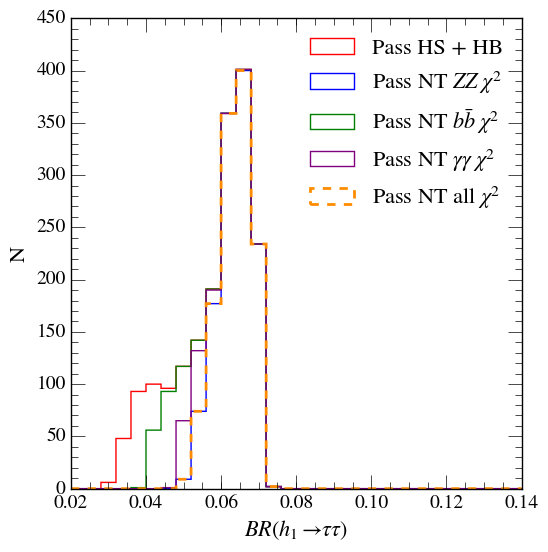

In [103]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1tautau', 
                  xlim=[0.02, .14], xlabel=r'$BR(h_1 \to \tau\tau)$', logy=False,
                  filename='Thesis_plots_5/Couplings_BR/h1tautau_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


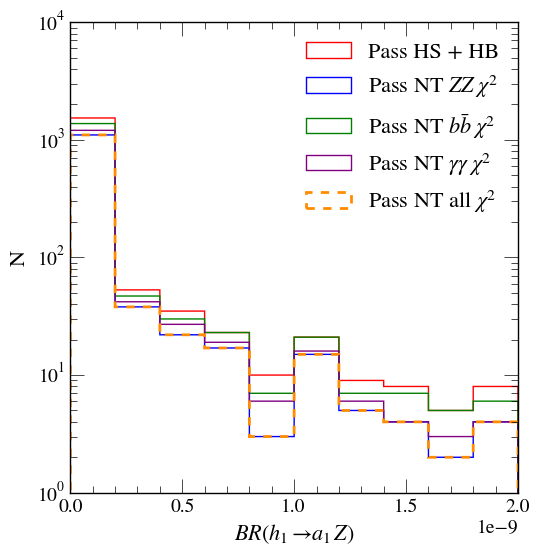

In [104]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1a1z', 
                  xlim=[0, 2E-9], xlabel=r'$BR(h_1 \to a_1Z)$', nbins=10, logy=True,
                  filename='Thesis_plots_5/Couplings_BR/h1a1z_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


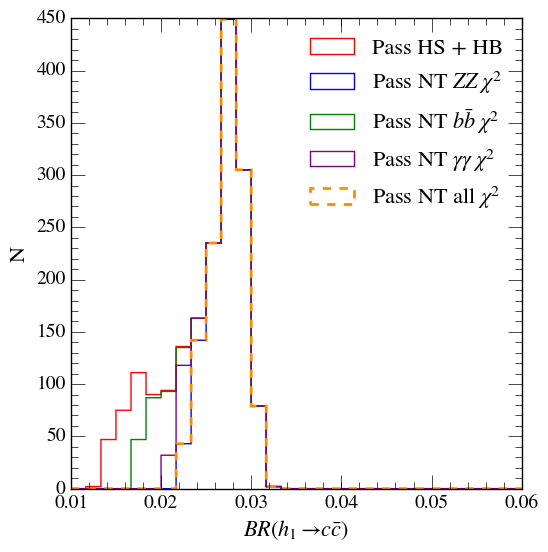

In [105]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1cc', 
                  xlim=[0.01, 6E-2], xlabel=r'$BR(h_1 \to c\bar{c})$', logy=False, #ylim=[0, 700],
                  filename='Thesis_plots_5/Couplings_BR/h1cc_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


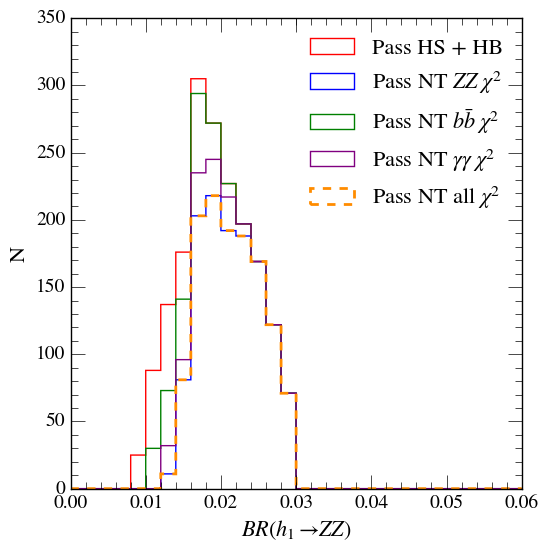

In [106]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1zz', 
                  xlim=[0, 6E-2], xlabel=r'$BR(h_1 \to ZZ)$', logy=False,
                  filename='Thesis_plots_5/Couplings_BR/h1zz_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


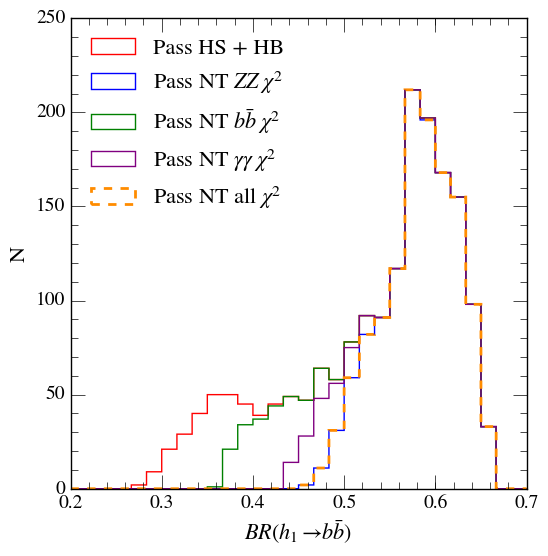

In [107]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1bb', 
                  xlim=[0.2, 0.7], xlabel=r'$BR(h_1 \to b\bar{b})$', logy=False, 
                  leg_loc='upper left', #ylim=[0, 400],
                  filename='Thesis_plots_5/Couplings_BR/h1bb_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


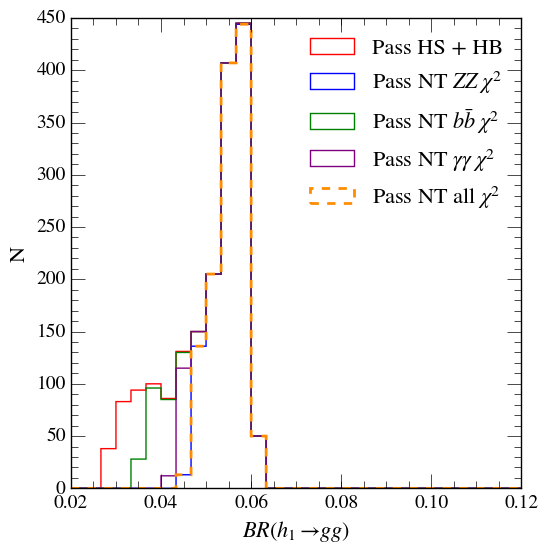

In [108]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1gg', 
                  xlim=[0.02, 0.12], xlabel=r'$BR(h_1 \to gg)$', logy=False, 
                  leg_loc='upper right',
                  filename='Thesis_plots_5/Couplings_BR/h1gluglu_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


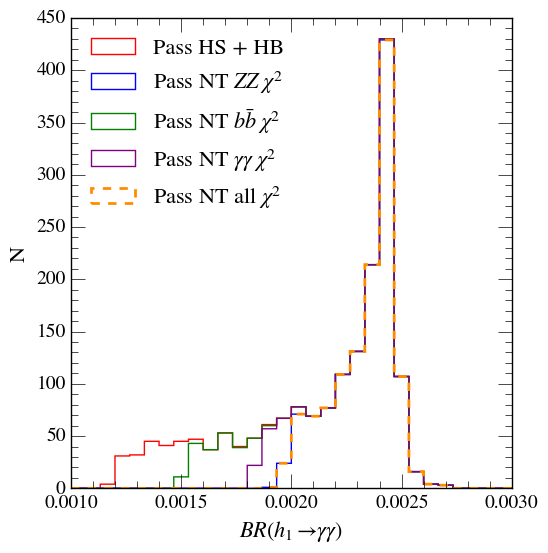

In [109]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1gammagamma', 
                  xlim=[0.001, 0.003], xlabel=r'$BR(h_1 \to \gamma\gamma)$', logy=False, 
                  leg_loc='upper left',
                  filename='Thesis_plots_5/Couplings_BR/h1gammagamma_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


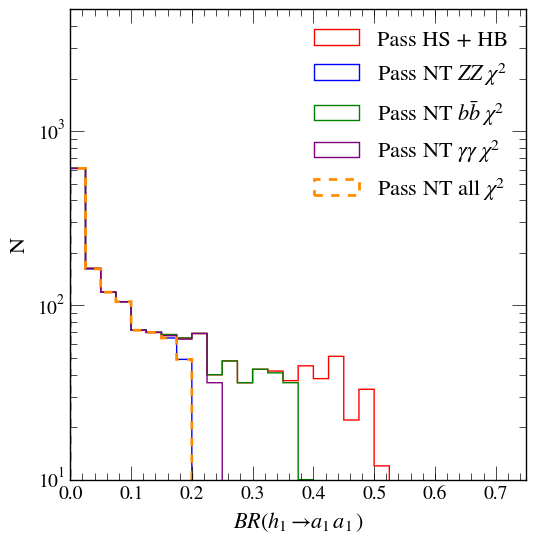

In [110]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1a1a1', 
                  xlim=[0, 0.75], xlabel=r'$BR(h_1 \to a_1 a_1)$', logy=True, 
                  leg_loc='upper right', ylim=[10, 5E3],
                  filename='Thesis_plots_5/Couplings_BR/h1a1a1_NT_HSHB.pdf')

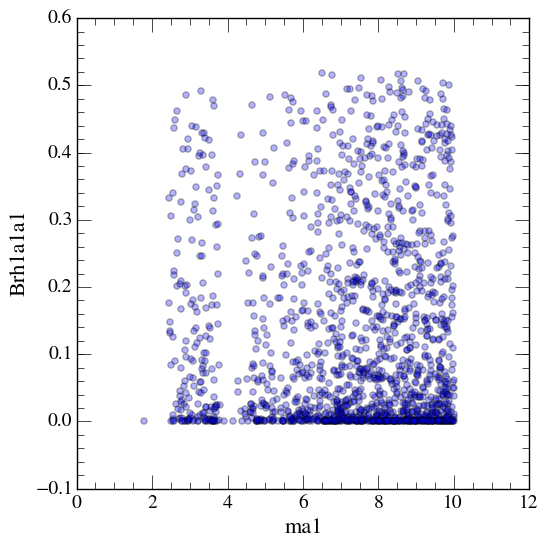

In [111]:
_ = plot_scatter(df=df_pass_all.query('122.1<mh1<128.1 & mh2>128.1 & ma1<10 & pass_HSHB'), 
                     yvar='Brh1a1a1', xvar='ma1', alpha=0.3)

Setting backend pdf
Setting backend png


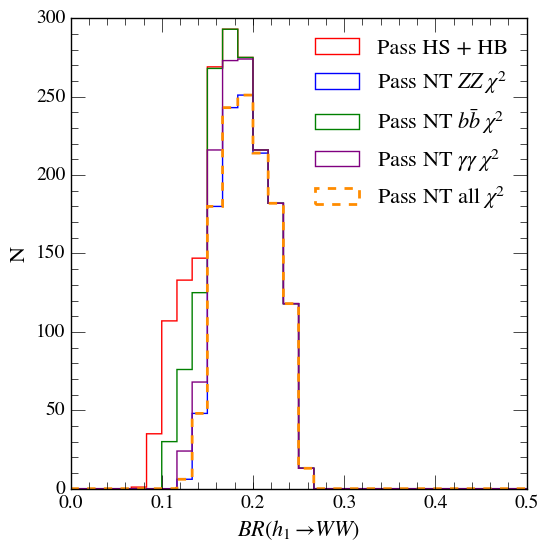

In [112]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1ww', 
                  xlim=[0, 0.5], xlabel=r'$BR(h_1 \to WW)$', logy=False, 
                  leg_loc='upper right',
                  filename='Thesis_plots_5/Couplings_BR/h1ww_NT_HSHB.pdf')

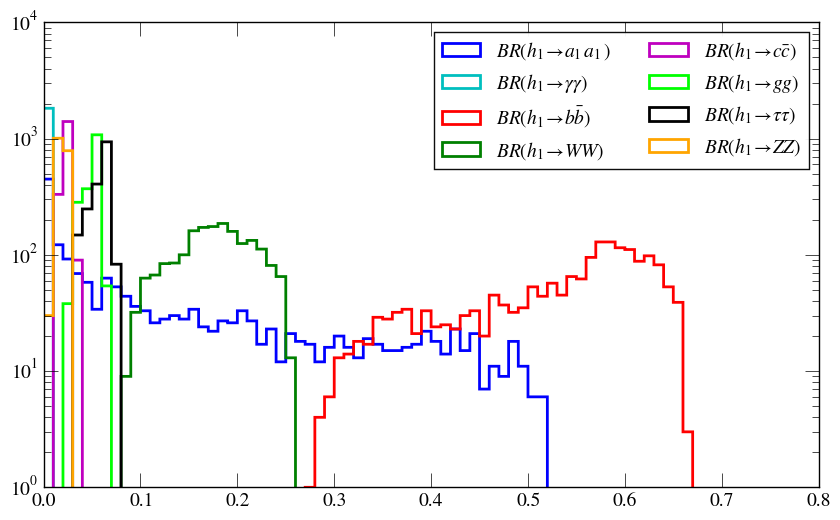

In [113]:
df = df_pass_all
cols = ['Brh1a1a1','Brh1gammagamma', 'Brh1bb', 'Brh1ww', 'Brh1cc', 'Brh1gg', 'Brh1tautau', 'Brh1zz']
df = df.query('pass_HSHB & 122.1<mh1<128.1 & mh2>128.1 & ma1<10.5')[cols]
cols_tex = [r'$BR(h_1\to a_1a_1)$', r'$BR(h_1\to \gamma\gamma)$', 
            r'$BR(h_1\to b\bar{b})$', r'$BR(h_1\to WW)$', r'$BR(h_1\to c\bar{c})$', 
            r'$BR(h_1\to gg)$', r'$BR(h_1\to \tau\tau)$', r'$BR(h_1\to ZZ)$']
df.columns = cols_tex
fig, ax = generate_fig_axes(size=[10,6])
colors = ["b","c","r","g","m","lime","k","orange"]
for i, v in enumerate(cols_tex):
    ax.hist(df[v].values, bins=75, range=[0,0.75], label=v, histtype='step', 
            color=colors[i], linestyle='solid', linewidth=2)
plt.legend(fontsize=14, ncol=2)
plt.yscale('log')

In [114]:
@save_fig
def plot_h1BR_corrs(df, title):
    cols = ['Brh1a1a1', 'Brh1zz', 'Brh1gammagamma', 'Brh1bb', 'Brh1ww', 'Brh1cc', 'Brh1gg', 'Brh1tautau']
    df = df.query('122.1<mh1<128.1 & mh2>128.1 & ma1<10.5')[cols]
    cols_tex = [r'$BR(h_1\to a_1a_1)$', r'$BR(h_1\to ZZ)$', r'$BR(h_1\to \gamma\gamma)$', 
                r'$BR(h_1\to b\bar{b})$', r'$BR(h_1\to WW)$', r'$BR(h_1\to c\bar{c})$', 
                r'$BR(h_1\to gg)$', r'$BR(h_1\to \tau\tau)$']
    df.columns = cols_tex
    pd.tools.plotting.scatter_matrix(df, figsize=[22, 22], alpha=0.7, grid=True, hist_kwds={'bins': 25}, color='red')
    plt.suptitle(title, y=0.93)

Setting backend png
Setting backend png


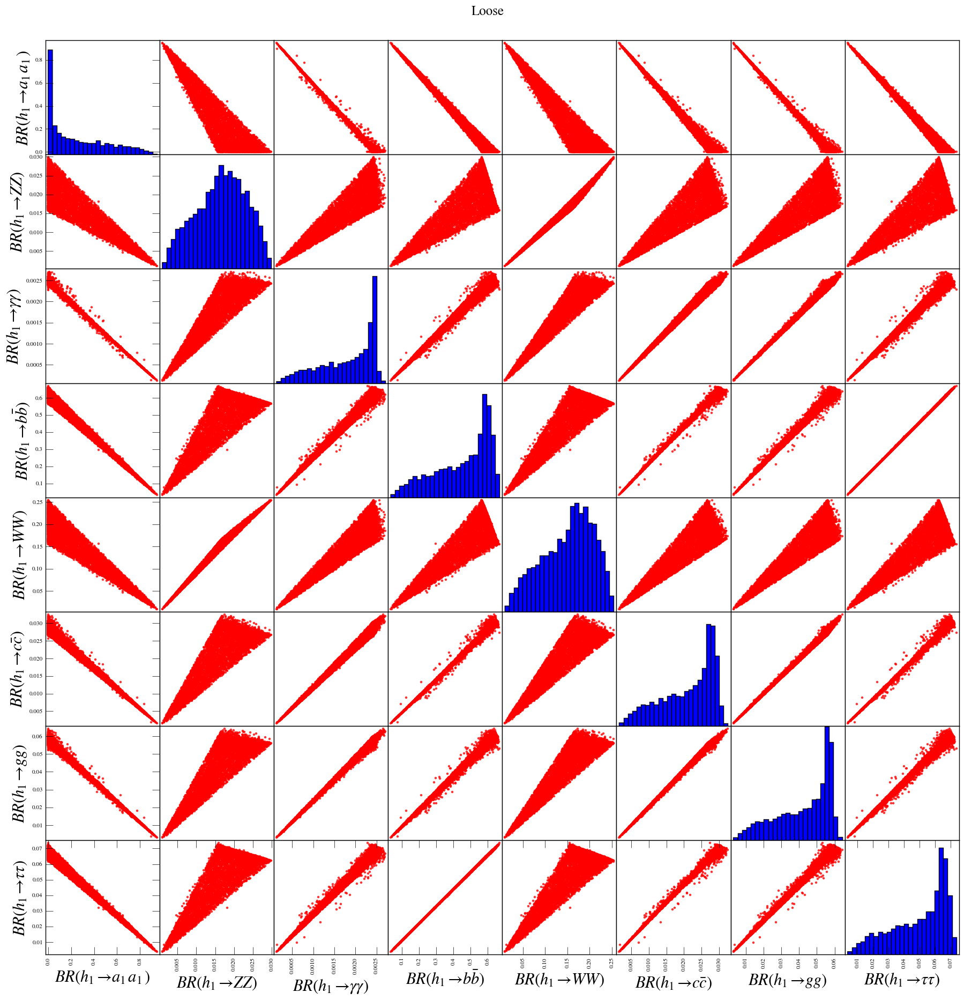

In [64]:
plot_h1BR_corrs(df_pass_all, 'Loose', filename='Thesis_plots_5/Couplings_BR/h1br_corr_loose.png')

Setting backend png
Setting backend png


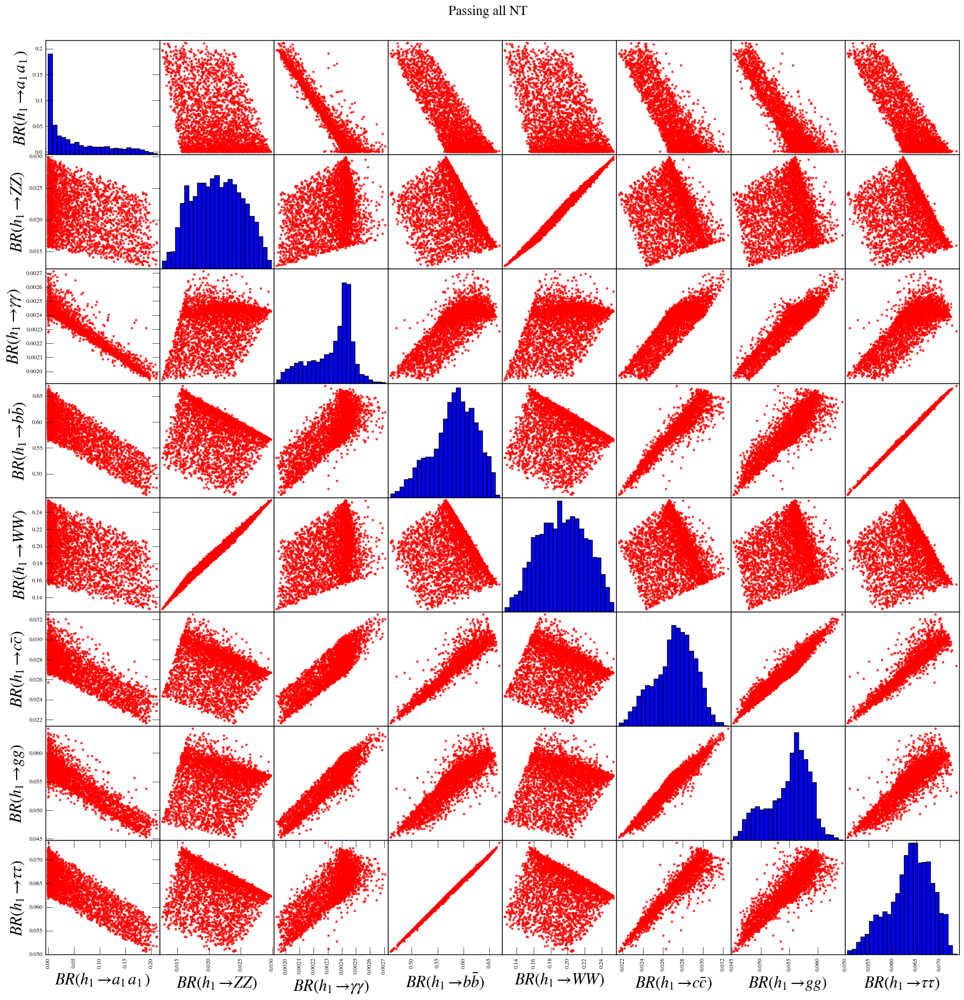

In [65]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], 
                'Passing all NT', filename='Thesis_plots_5/Couplings_BR/h1br_corr_NT.png')

Setting backend png
Setting backend png


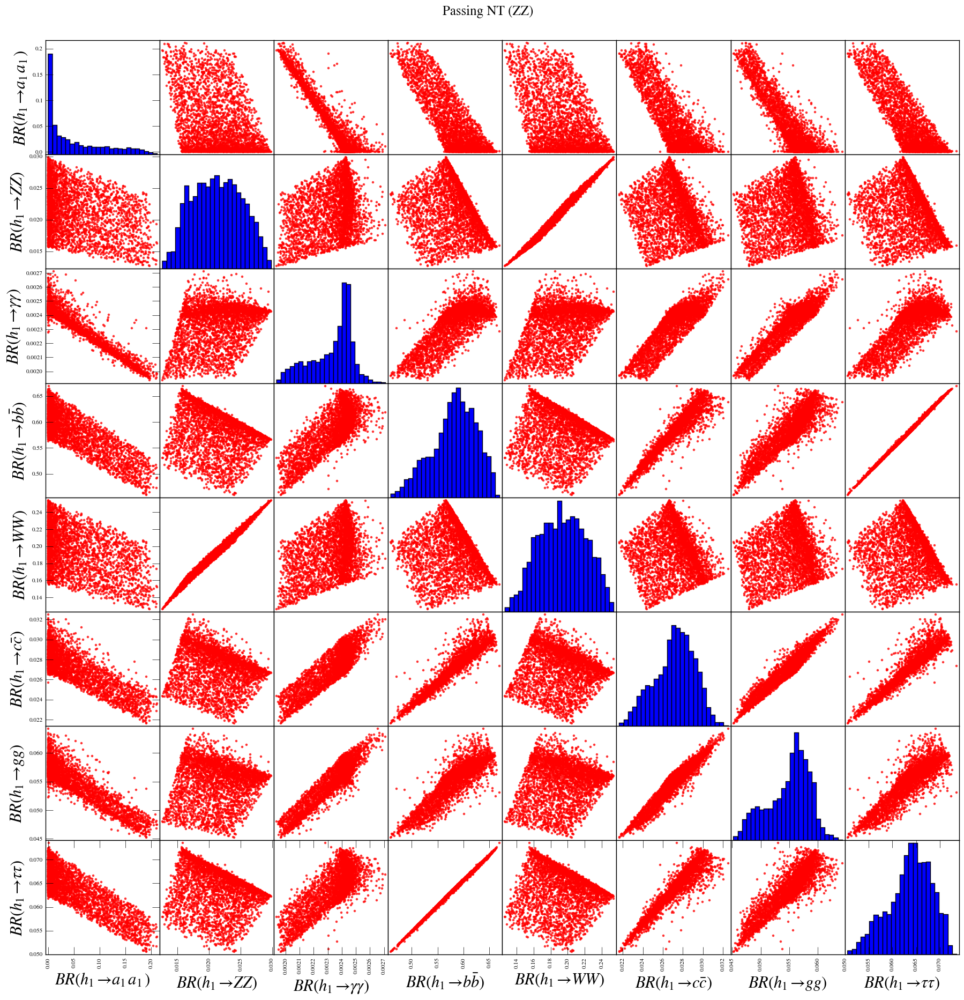

In [66]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('ZZ')], 
                'Passing NT (ZZ)', filename='Thesis_plots_5/Couplings_BR/h1br_corr_NT_ZZ.png')

Setting backend png
Setting backend png


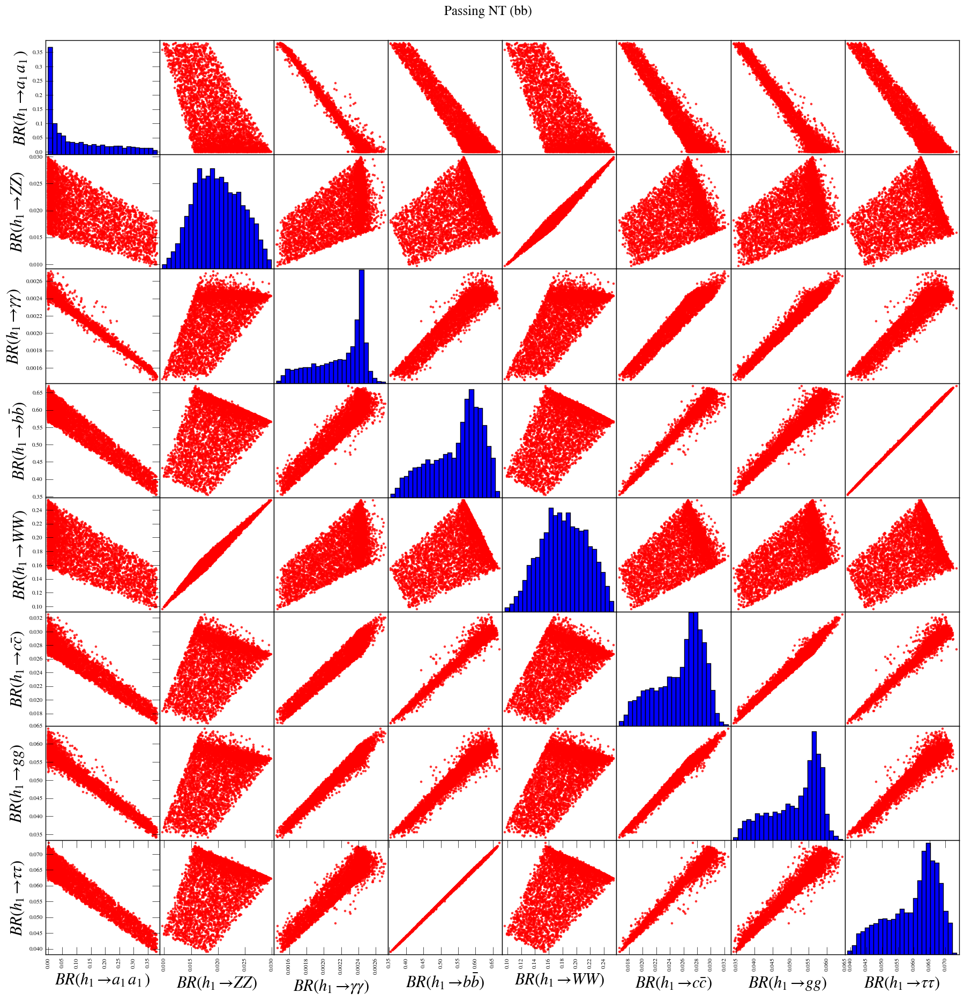

In [67]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('bb')], 
                'Passing NT (bb)', filename='Thesis_plots_5/Couplings_BR/h1br_corr_NT_bb.png')

Setting backend png
Setting backend png


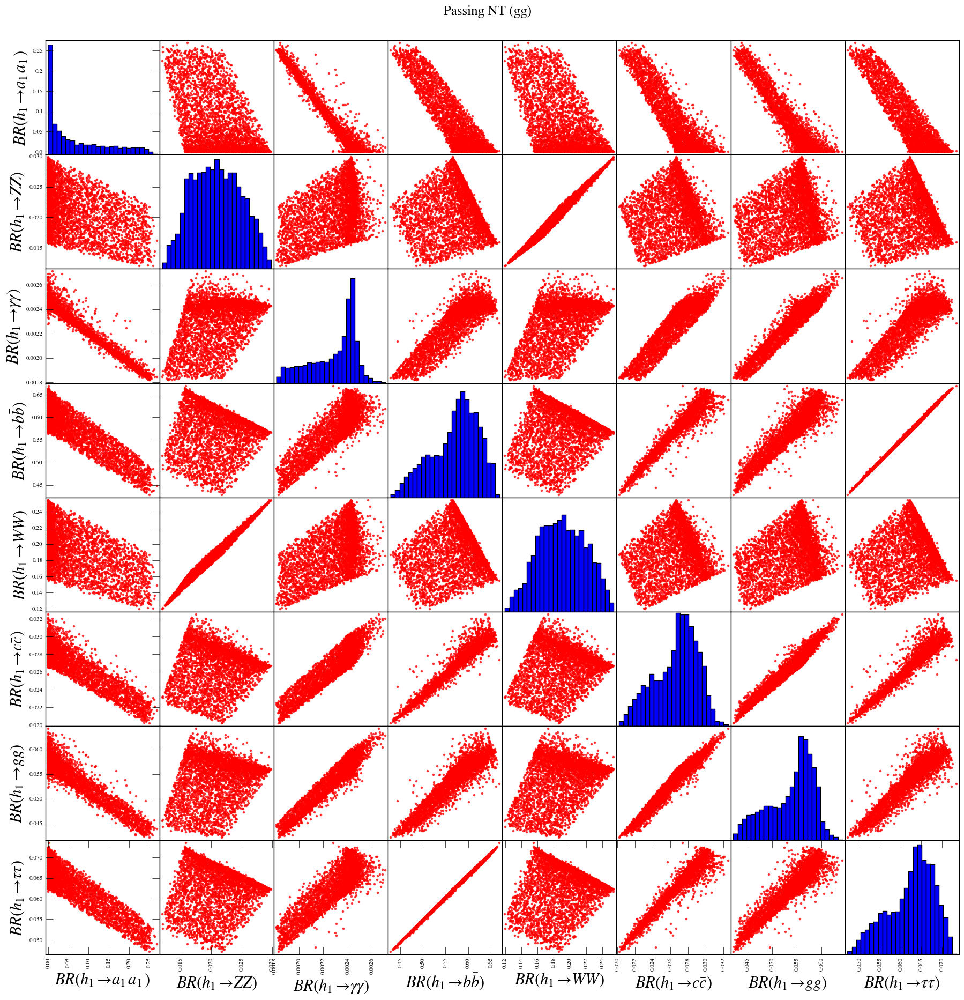

In [68]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('gg')], 
                'Passing NT (gg)', filename='Thesis_plots_5/Couplings_BR/h1br_corr_NT_gg.png')

In [115]:
@save_fig
def plot_bra1_ma1(df, title):
    fig, ax = generate_fig_axes()
    plot_scatter(ax = ax, df=df, xvar='ma1', yvar='Bra1tautau', color='green', label=r'$\tau\tau$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1mumu', color='red', label=r'$\mu\mu$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1bb', color='blue', label=r'$b\bar{b}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1cc', color='orange', label=r'$c\bar{c}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1ss', color='fuchsia', label=r'$s\bar{s}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1gg', color='purple', label=r'$gg$', s=SIZE)
    plt.xlim(0, 25)
    plt.ylim(1E-3, 1.2)
    plt.yscale('log')
    plt.legend(loc='lower right', fontsize=16, framealpha=0.85)
    plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$')
    plt.ylabel(r'$BR(a_1 \to XX)$')
    plt.tight_layout()

Setting backend png
Setting backend png


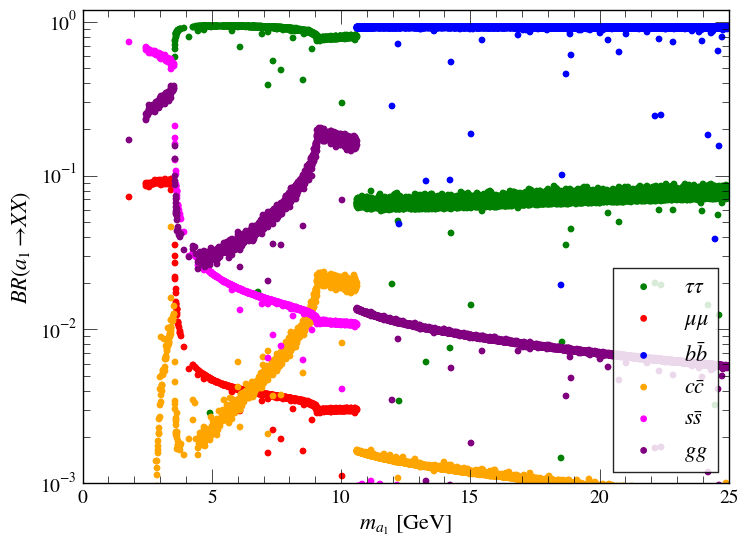

In [116]:
plot_bra1_ma1(df_pass_all.query('pass_NT'), title, filename='Thesis_plots_5/Couplings_BR/bra1_ma1.png')

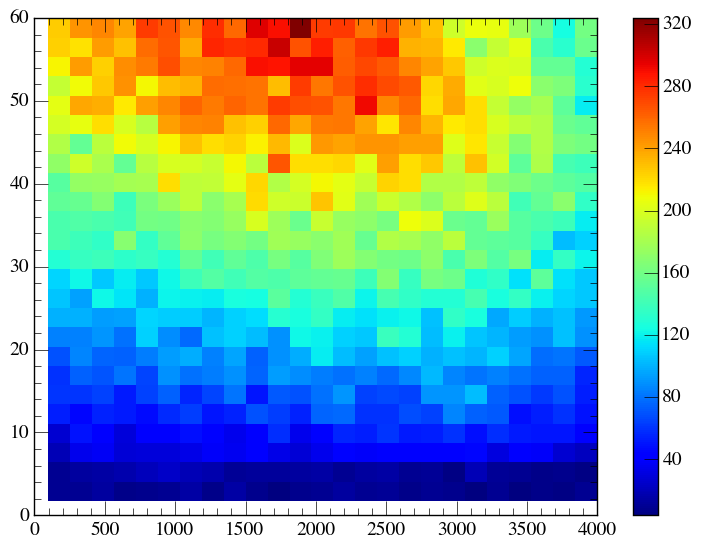

In [16]:
_ = plot_histogram2d(df=df_pass_all, xvar='alambda', yvar='ma1', norm_axis=None)

<matplotlib.colorbar.Colorbar instance at 0x12861e8c0>

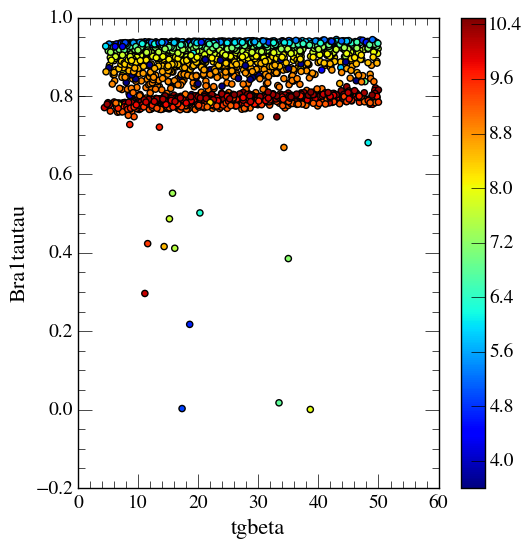

In [23]:
a, p = plot_scatter(df=df_pass_all.query('3.6<ma1<10.5'), xvar='tgbeta', yvar='Bra1tautau', 
             c=df_pass_all.query('3.6<ma1<10.5').ma1.values)
plt.colorbar(p)

Setting backend png
Setting backend png


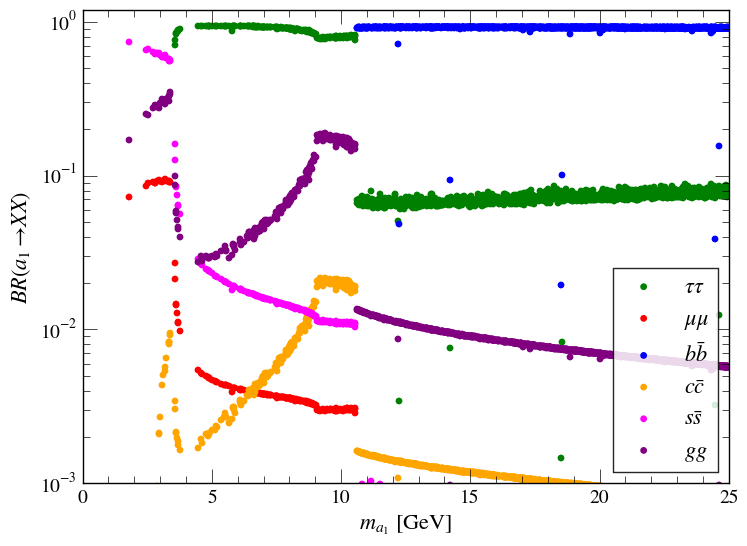

In [117]:
plot_bra1_ma1(df_pass_all.query('pass_strict'), 
              title, filename='Thesis_plots_5/Couplings_BR/bra1_ma1_strict.png')

In [118]:
@save_fig
def plot_brh1_mh1(df, title):
    fig, ax = generate_fig_axes()
    plot_scatter(ax = ax, df=df, xvar='mh1', yvar='Brh1tautau', color='green', label=r'$\tau\tau$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1mumu', color='red', label=r'$\mu\mu$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1bb', color='blue', label=r'$b\bar{b}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1cc', color='orange', label=r'$c\bar{c}$', s=SIZE)
#     plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1ss', color='fuchsia', label=r'$s\bar{s}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1gg', color='purple', label=r'$gg$', s=SIZE)
    plt.xlim(0, 25)
    plt.ylim(1E-3, 1.2)
    plt.yscale('log')
    plt.legend(loc='best', fontsize=16, framealpha=0.85)
    plt.xlabel(r'$m_{h_1}\ \mathrm{[GeV]}$')
    plt.ylabel(r'$BR(h_1 \to XX)$')

Setting backend png
Setting backend png


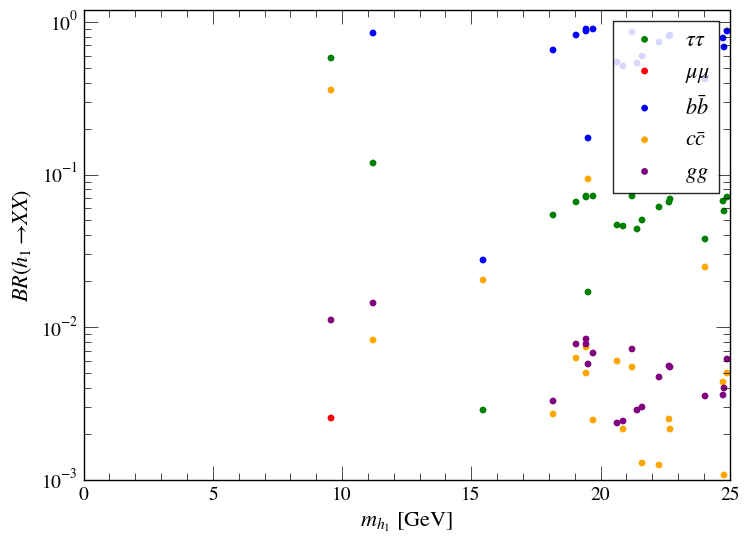

In [119]:
plot_brh1_mh1(df_pass_all, title, filename='Thesis_plots_5/Couplings_BR/brh1_mh1.png')

# Cross-sections 

<matplotlib.colorbar.Colorbar instance at 0x14f4a4878>

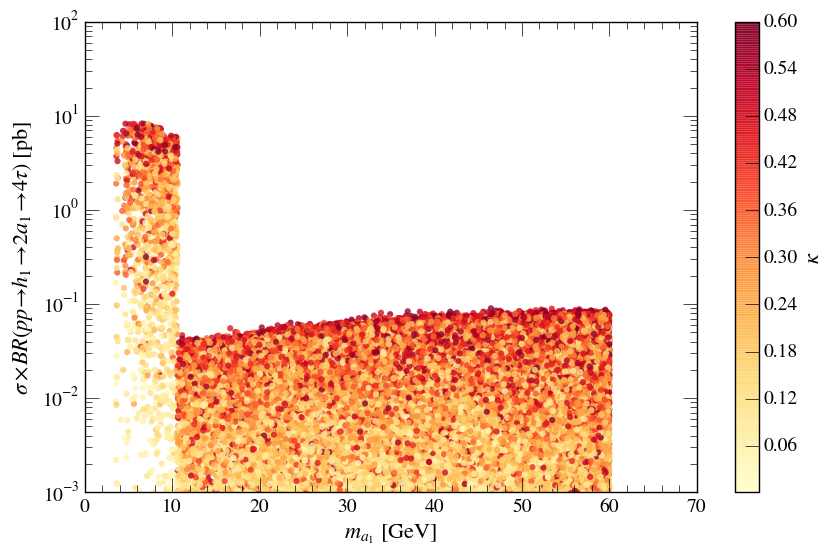

In [127]:
fig, ax = generate_fig_axes(size=[9,6])
q_str = '122.1<mh1<128.1 & HSprob>0.05 & HBresult==1 & 0.<omega<0.16'
_, s = plot_scatter(ax=ax, df=df_pass_all.query(q_str),
                    xvar='ma1', yvar='xsec_8_ggf_h1_2a1_4tau', marker='o', 
                    c=df_pass_all.query(q_str)['kappa'].values, 
                    cmap=plt.get_cmap('YlOrRd'), alpha=0.8, linewidths=0)
plt.ylim(1E-3, 100)
plt.yscale('log')
plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$')
plt.ylabel(r'$\sigma\times BR (pp \to h_1 \to 2a_1 \to 4\tau)\ \mathrm{[pb]}$')
fig.colorbar(s, label=r'$\kappa$')

<matplotlib.colorbar.Colorbar instance at 0x121d69050>

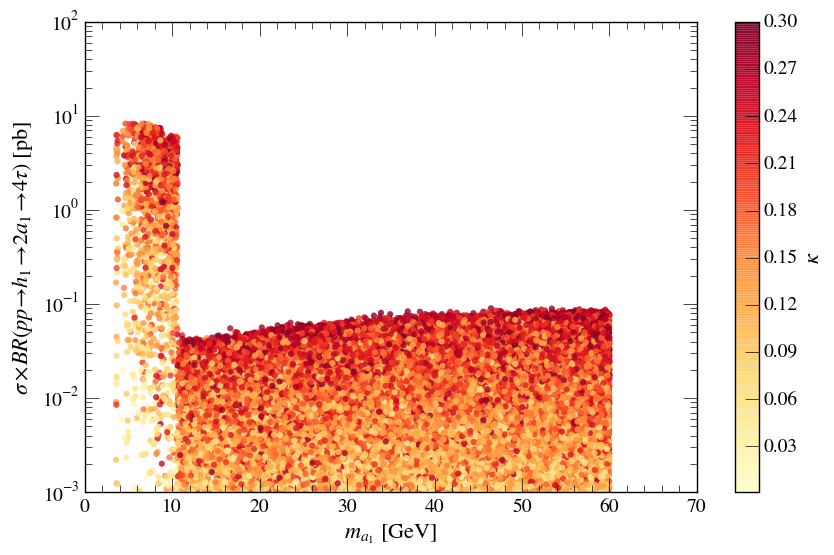

In [128]:
fig, ax = generate_fig_axes(size=[9,6])
q_str = '122.1<mh1<128.1 & HSprob>0.05 & HBresult==1 & 0.<omega<0.16'
_, s = plot_scatter(ax=ax, df=df_pass_all.query(q_str),
                    xvar='ma1', yvar='xsec_8_ggf_h1_2a1_4tau', marker='o', 
                    c=df_pass_all.query(q_str)['lambda_'].values, 
                    cmap=plt.get_cmap('YlOrRd'), alpha=0.8, linewidths=0)
plt.ylim(1E-3, 100)
plt.yscale('log')
plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$')
plt.ylabel(r'$\sigma\times BR (pp \to h_1 \to 2a_1 \to 4\tau)\ \mathrm{[pb]}$')
fig.colorbar(s, label=r'$\kappa$')

1.07 1.23


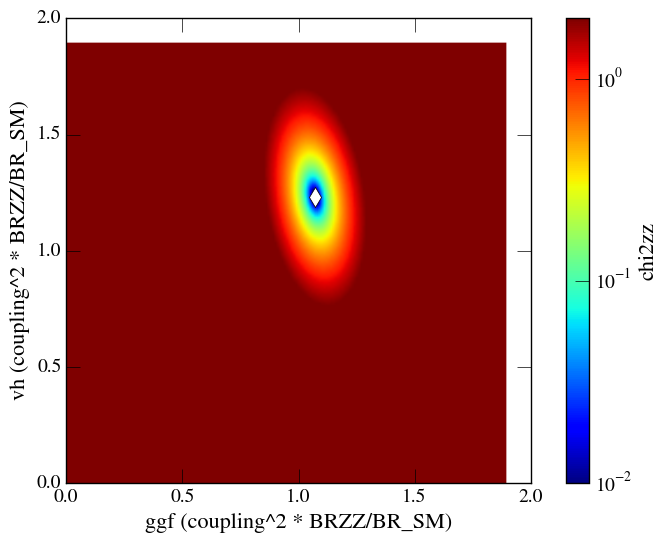

In [129]:
azz=43.29
bzz=4.91
czz=9.61
mugcenzz=1.07
muvcenzz=1.23

def chi2zz(ggf_vv, vh_vv):
    return azz*(ggf_vv-mugcenzz)**2+czz*(vh_vv-muvcenzz)**2+2*bzz*(ggf_vv-mugcenzz)*(vh_vv-muvcenzz)

ggf_vv = np.arange(0, 1.9, 0.01)
vh_vv = np.arange(0, 1.9, 0.01)

chi2 = np.empty([len(ggf_vv), len(vh_vv)])
for i, x in enumerate(ggf_vv):
    for j, y in enumerate(vh_vv):
        chi2[i,j] = chi2zz(x, y)

plt.imshow(chi2.T, interpolation=None, origin='lower', 
#            cmap=plt.get_cmap('summer'), 
           norm=mpl.colors.LogNorm(vmin=0.01, vmax=100),
           extent=[ggf_vv.min(), ggf_vv.max(), vh_vv.min(), vh_vv.max()],
           vmin=0.01, vmax=2)
plt.colorbar(label='chi2zz')

plt.xlabel('ggf (coupling^2 * BRZZ/BR_SM)')
plt.ylabel('vh (coupling^2 * BRZZ/BR_SM)')
min_x_ind, min_y_ind = np.unravel_index(chi2.argmin(), chi2.shape)
print ggf_vv[min_x_ind], vh_vv[min_y_ind]
plt.plot(ggf_vv[min_x_ind], vh_vv[min_y_ind], 'd', c='white', markersize=10)
# print plt.xticks
# plt.gca().set_xticks(ggf_vv)

In [130]:
def plot_xsec_4tau_inputparams(df, title):
    plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel=r'$\sigma \times BR$', 
                               yrange=[0.01,10], param_dict=nmssm_params_extended)
#     plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel='\sigma \times BR()')
    plt.suptitle(title)
    fig = plt.gcf()
    for ax in fig.axes:
        ax.set_yscale('log')

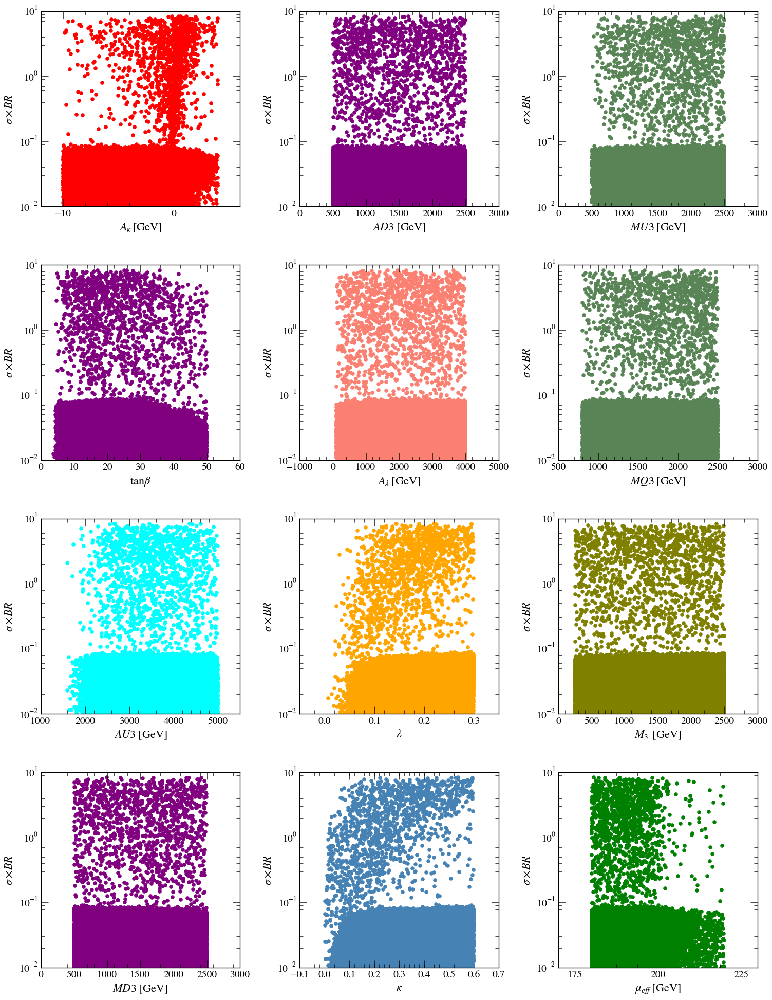

In [124]:
plot_xsec_4tau_inputparams(df_pass_all.query('pass_HSHB'), title='')
# df = df_pass_all.query('HSprob>0.05 & HBresult==1')
# plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel=r'$\sigma \times BR$')
# fig = plt.gcf()

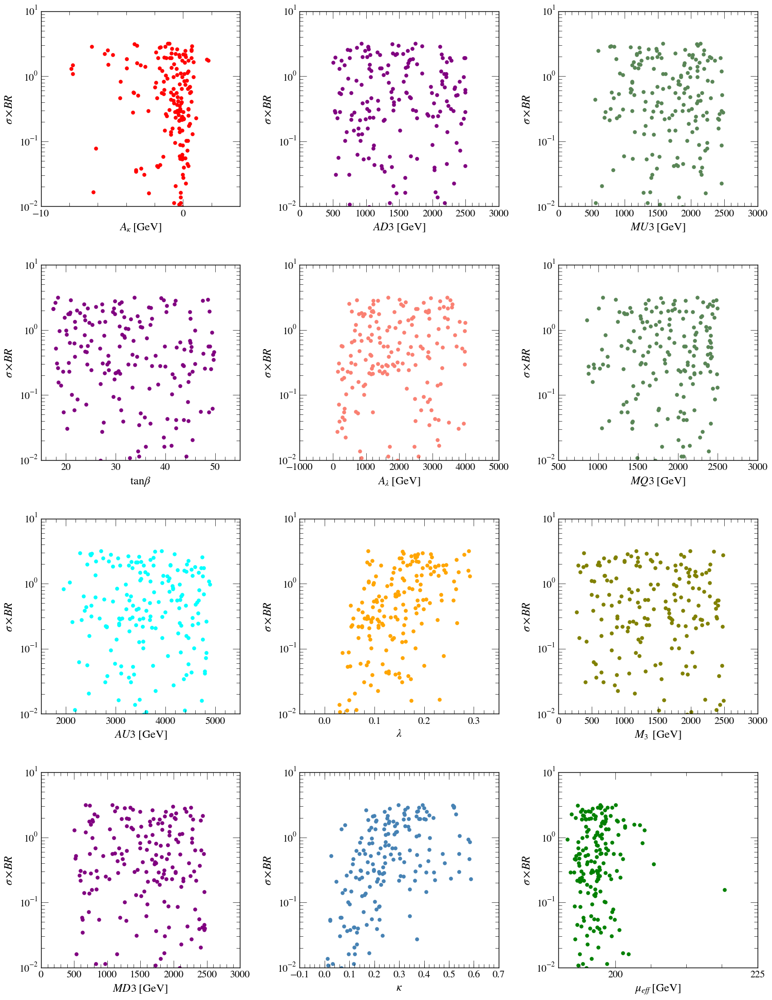

In [125]:
plot_xsec_4tau_inputparams(df_pass_all.query('pass_strict & ma1<10.5'), title='')
# df = df_pass_all.query('HSprob>0.05 & HBresult==1')
# plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel=r'$\sigma \times BR$')
# fig = plt.gcf()

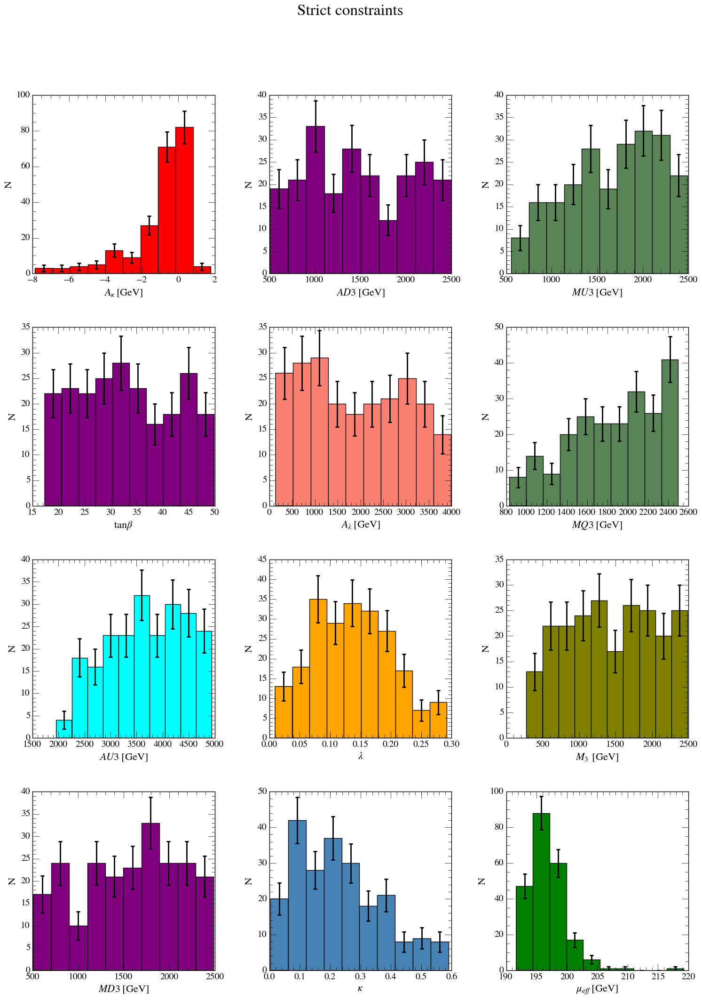

In [126]:
plot_input_params_hists(df_pass_all.query('pass_strict & ma1<10.5'),
                        ylabel='N', title='Strict constraints', param_dict=nmssm_params_extended)


In [119]:
from pandas.tools.plotting import parallel_coordinates

In [190]:
cols = ['HS_%d_chi2' % x for x in range(1, 86)]

df_HS = df_pass_all.query('ma1<10.5')[cols]

df_HS['passHS'] = (df_pass_all.HSprob>0.05) & (df_pass_all.HBresult==1)

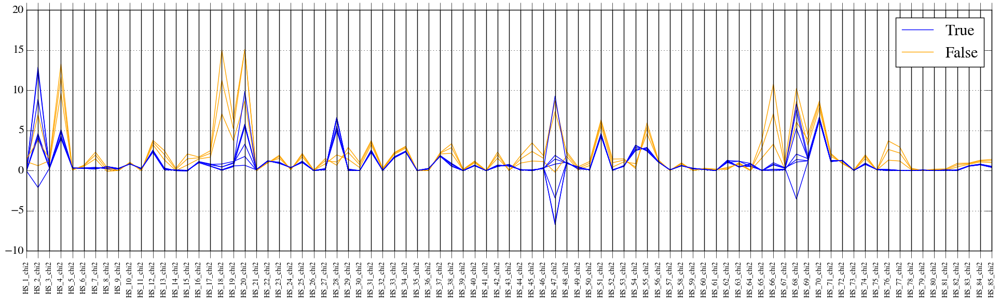

In [194]:
fig = plt.figure(figsize=[24, 6])
ax = parallel_coordinates(df_HS.iloc[0:10], 'passHS', color=['blue', 'orange'])
ax.tick_params(axis='x', which='major', labelsize=10, direction=90)
plt.legend(framealpha=1)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_rotation(90)

# With New Higgs Constraints

In [131]:
atlas.columns

Index([u'Unnamed: 0', u'm_a', u'br_4tau', u'xsec_br_4tau', u'xsec_br_2tau2mu',
       u'xsec_br_4mu', u'br_2tau2mu', u'br_4mu'],
      dtype='object')

In [132]:
experiments = [
    {'df': cms_tau_19, 'label': 'CMS HIG-14-019 ' + r'$(4\tau)$', 'color': 'blue'},
    {'df': cms_tau_22, 'label': 'CMS HIG-14-022 ' + r'$(4\tau)$', 'color': 'green'},
    {'df': atlas, 'label': 'ATLAS HIGG-2014-02 ' + r'$(2\tau2\mu)$', 'color': 'red'},
]

In [133]:
experiments_4mu = experiments[:]
experiments_4mu.append(
    {'df': cms_mu_10, 'label': 'CMS HIG-13-010' + r'$(4\mu)$', 'color': 'purple'}
)

In [134]:
experiments_himass = experiments[:]
experiments_himass.extend([
    {'df': cms_2tau2mu_11, 'label': 'CMS HIG-15-011' + r'$(2\tau2\mu)$', 'color': 'orange'},
    {'df': cms_2b2mu_41, 'label': 'CMS HIG-14-041 ' + r'$(2b2\mu)$', 'color': 'fuchsia', 'yvar': 'xsec_br_2tau2mu_type1_tb1'},
])

In [135]:
scan_dict_h1 = [
    {'df': df_pass_all.query('pass_HSHB'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_1$)", 'color': 'dodgerblue', 'shape': '^'},
    {'df': df_pass_all.query('pass_HSHB & pass_NT'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_1$)", 'color': 'lawngreen', 'shape': '^'},
]

In [136]:
scan_dict_h2 = [
    {'df': df_pass_all.query('pass_HSHB'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_2$)", 'color': 'blue', 'shape': 'v'},
    {'df': df_pass_all.query('pass_HSHB & pass_NT'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_2$)", 'color': 'green', 'shape': 'v'},
]

In [137]:
scan_dict_h1_strict = [
    {'df': df_pass_all.query('pass_HSHB & pass_del_a_mu & pass_relic'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_1$)", 'color': 'dodgerblue', 'shape': '^'},
    {'df': df_pass_all.query('pass_HSHB & pass_NT & pass_del_a_mu & pass_relic'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_1$)", 'color': 'lawngreen', 'shape': '^'},
]

In [138]:
scan_dict_h2_strict = [
    {'df': df_pass_all.query('pass_HSHB & pass_del_a_mu & pass_relic'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_2$)", 'color': 'blue', 'shape': 'v'},
    {'df': df_pass_all.query('pass_HSHB & pass_NT & pass_del_a_mu & pass_relic'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_2$)", 'color': 'green', 'shape': 'v'},
]

In [139]:
scan_dict_h2_h1 = [
    {'df': df_pass_all.query('pass_HSHB'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_2$)", 'color': 'green', 'shape': 's'},
    {'df': df_pass_all.query('pass_HSHB & pass_NT'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_2$)", 'color': 'yellow', 'shape': 's'},
]

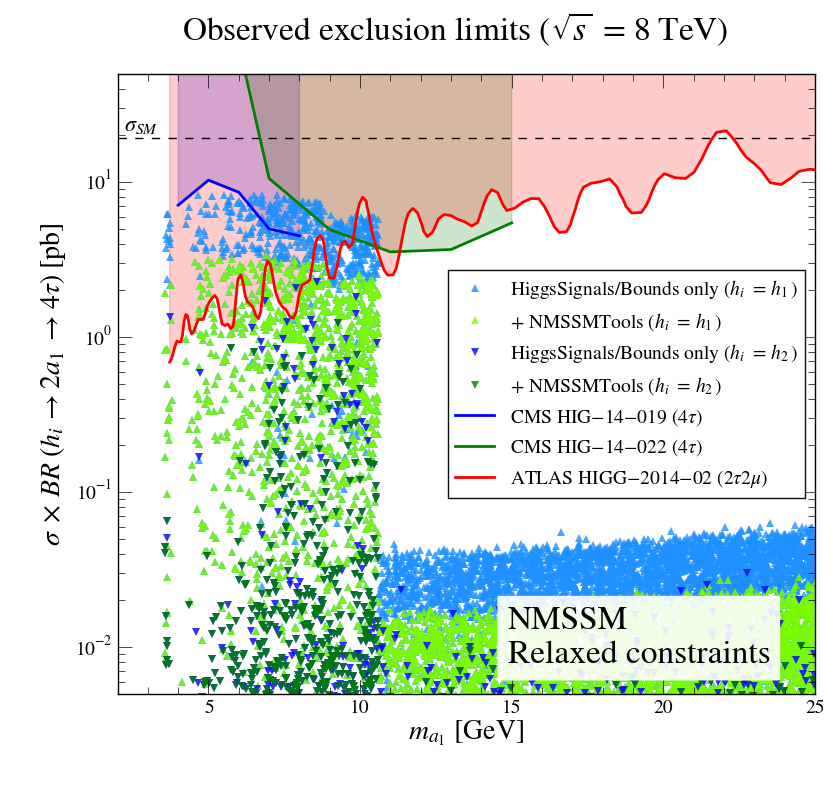

In [149]:
ylim = [5E-3, 50]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', 
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='xsec_br_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], leg_loc='center right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/xsec_br_4tau.png')

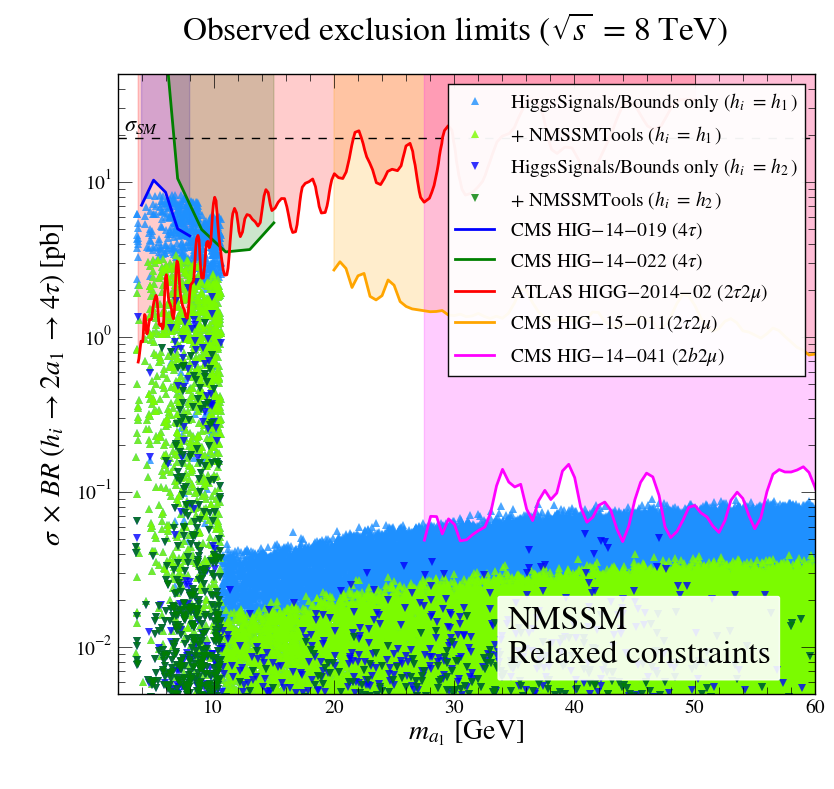

In [150]:
ylim = [5E-3, 50]
xlim = [2, 60]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', 
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
experiments_himass[-1]['yvar'] = 'xsec_br_4tau_type2_tb0p5'
plotr.plot_scan_exclusions(None, experiments_himass, y_var='xsec_br_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='upper right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/xsec_br_4tau_highermass.png')

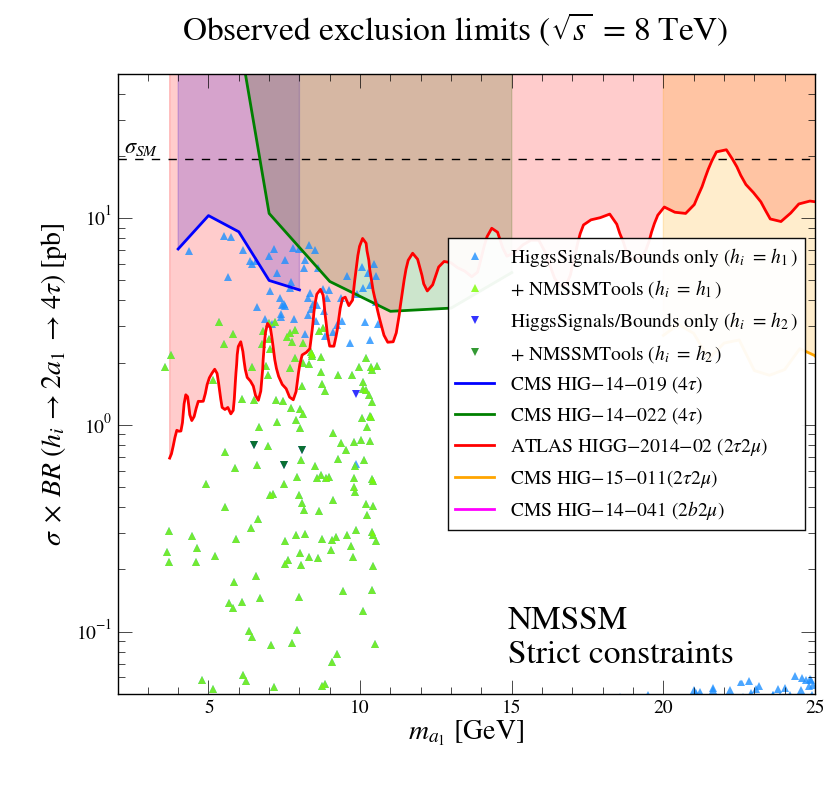

In [151]:
ylim = [5E-2, 50]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nStrict constraints'
plotr.plot_scan_exclusions(scan_dict_h1_strict, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2_strict, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', 
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
experiments_himass[-1]['yvar'] = 'xsec_br_4tau_type2_tb0p5'
plotr.plot_scan_exclusions(None, experiments_himass, y_var='xsec_br_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='center right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/xsec_br_4tau_strict.png')

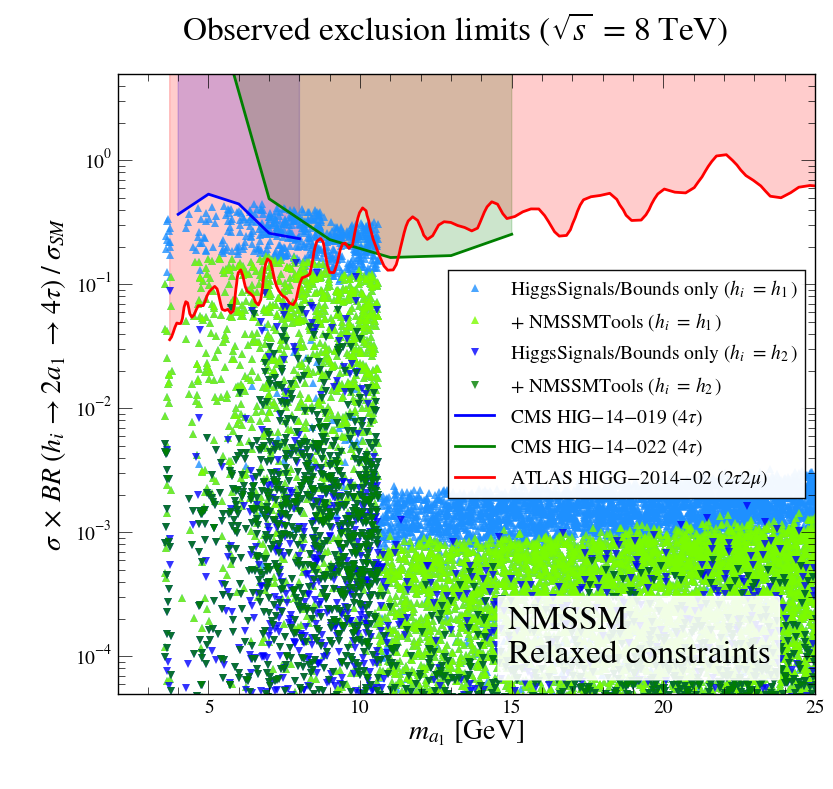

In [152]:
ylim = [5E-5, 5]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='br_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='center right')

plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/br_4tau.png')

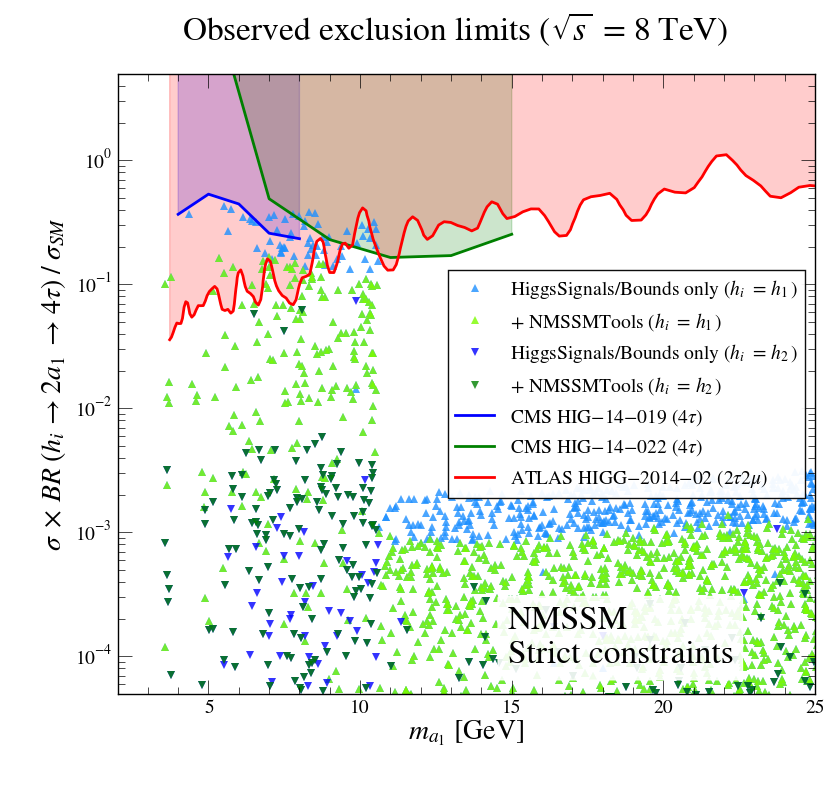

In [153]:
ylim = [5E-5, 5]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nStrict constraints'
plotr.plot_scan_exclusions(scan_dict_h1_strict, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2_strict, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='br_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='center right')

plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/br_4tau_strict.png')

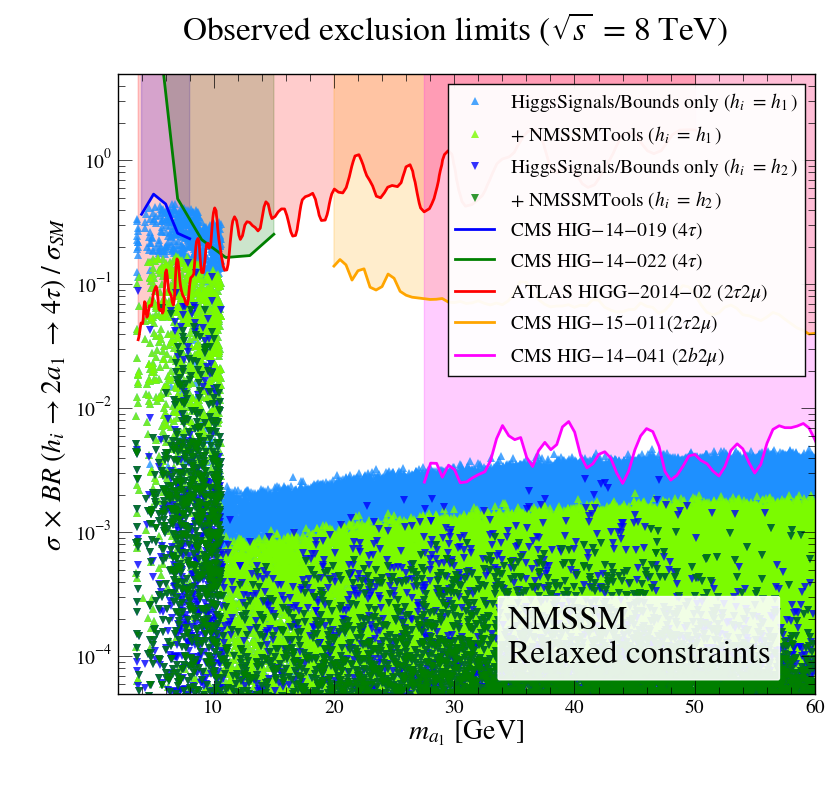

In [154]:
ylim = [5E-5, 5]
xlim = [2, 60]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
experiments_himass[-1]['yvar'] = 'br_4tau_type2_tb0p5'
plotr.plot_scan_exclusions(None, experiments_himass, y_var='br_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='upper right')

plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/br_4tau_highermass.png')

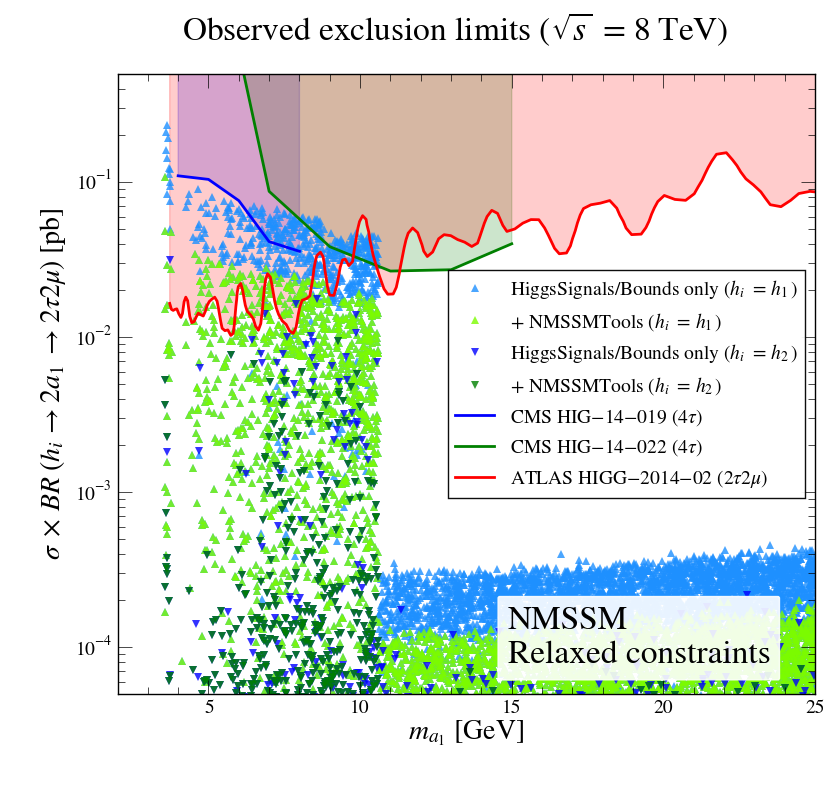

In [155]:
ylim = [5E-5, .5]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='xsec_br_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='center right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/xsec_br_2tau2mu.png')

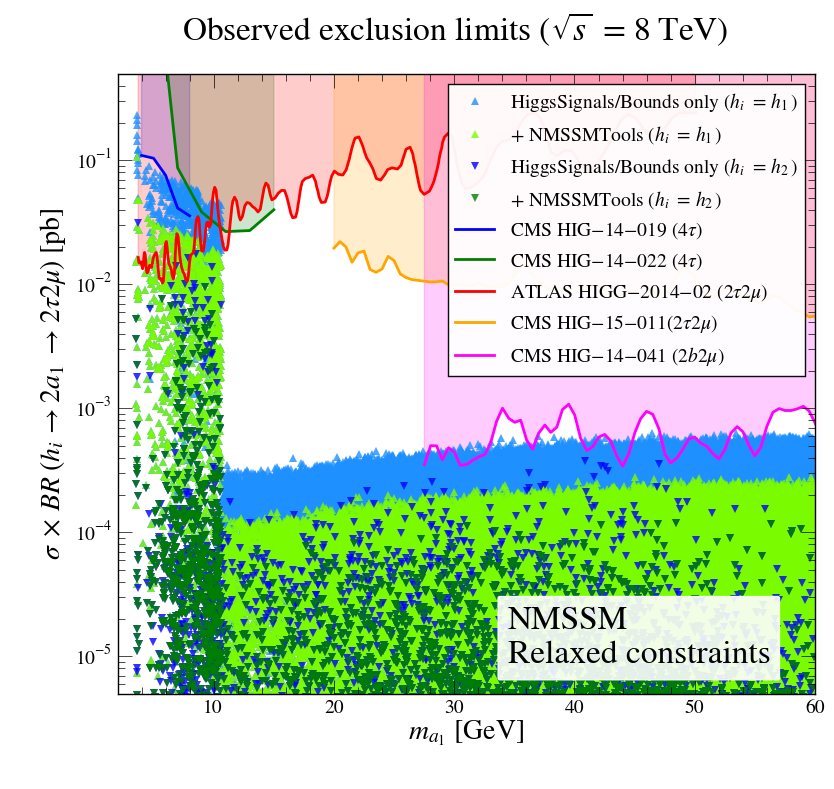

In [156]:
ylim = [5E-6, .5]
xlim = [2, 60]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
experiments_himass[-1]['yvar'] = 'xsec_br_2tau2mu_type2_tb0p5'
plotr.plot_scan_exclusions(None, experiments_himass, y_var='xsec_br_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='upper right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/xsec_br_2tau2mu_highermass.png')

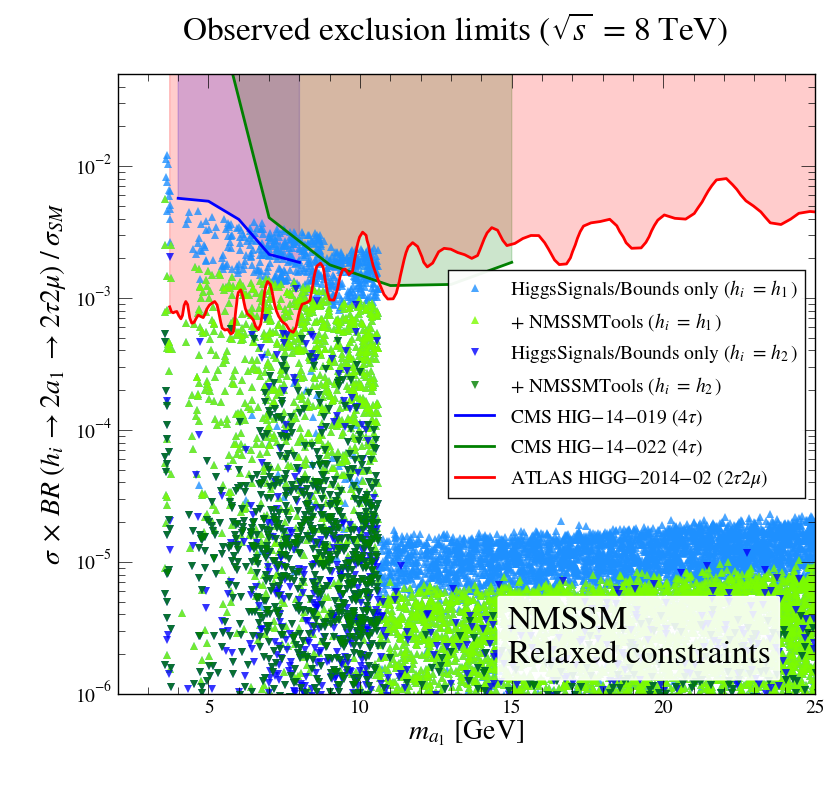

In [157]:
ylim = [1E-6, 5E-2]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='br_2tau2mu', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_2TAU2MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='center right')
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/br_2tau2mu.png')

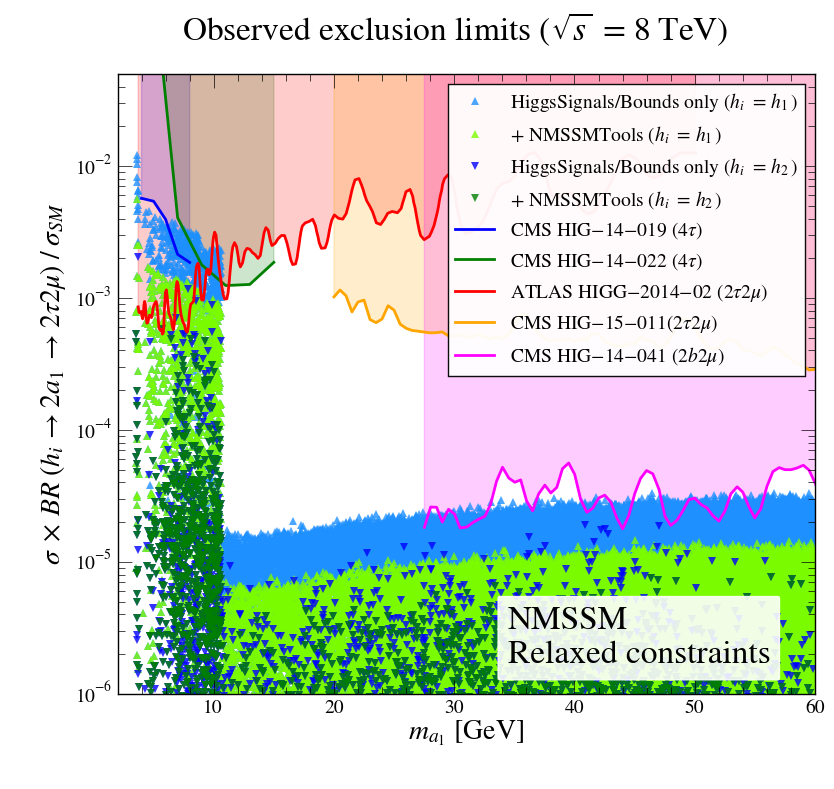

In [158]:
ylim = [1E-6, 5E-2]
xlim = [2, 60]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
experiments_himass[-1]['yvar'] = 'br_2tau2mu_type2_tb0p5'
plotr.plot_scan_exclusions(None, experiments_himass, y_var='br_2tau2mu', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_2TAU2MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='upper right')
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/br_2tau2mu_highermass.png')

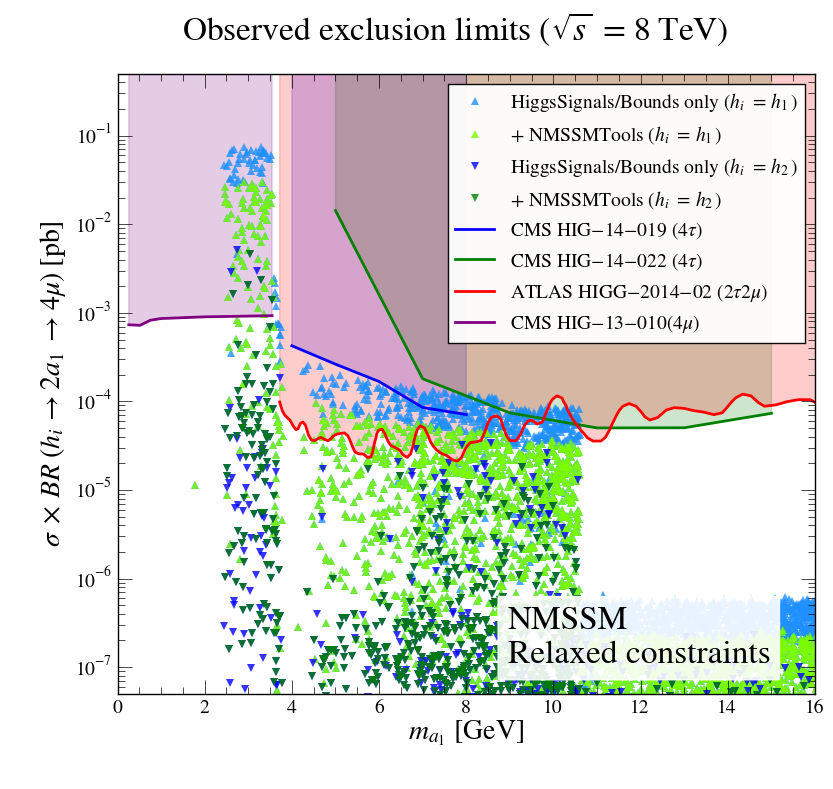

In [159]:
ylim = [5E-8, 5E-1]
xlim = [0, 16]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_4mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_4mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments_4mu, y_var='xsec_br_4mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='upper right')
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/xsec_br_4mu.png')

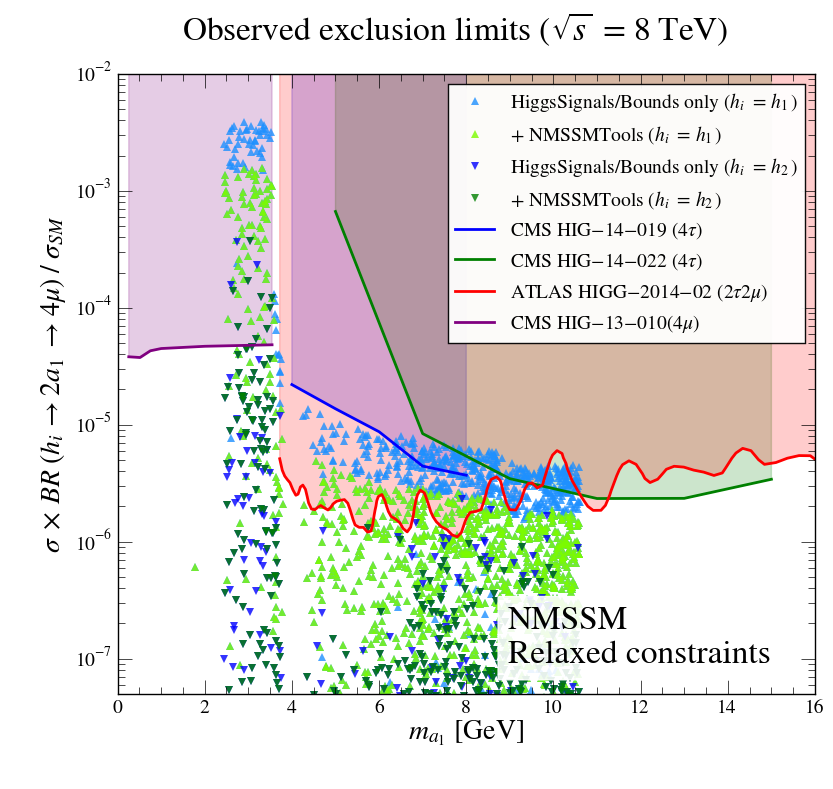

In [160]:
ylim = [5E-8, 1E-2]
xlim = [0, 16]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_4mu', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_4mu', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments_4mu, y_var='br_4mu', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.56, 0.05], 
                           leg_loc='upper right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(9, 8)
plt.savefig('Thesis_plots_5/New_Limits/br_4mu.png')

In [165]:
def add_kap_lam_vars(df):
    df['kap_lam_sq'] = df.kappa*df.kappa + df.lambda_*df.lambda_
    df['kap_lam'] = df.kappa + df.lambda_
    df['kap_lam_diff'] = df.kappa - df.lambda_

In [166]:
add_kap_lam_vars(df_pass_all)

(0.001, 10)

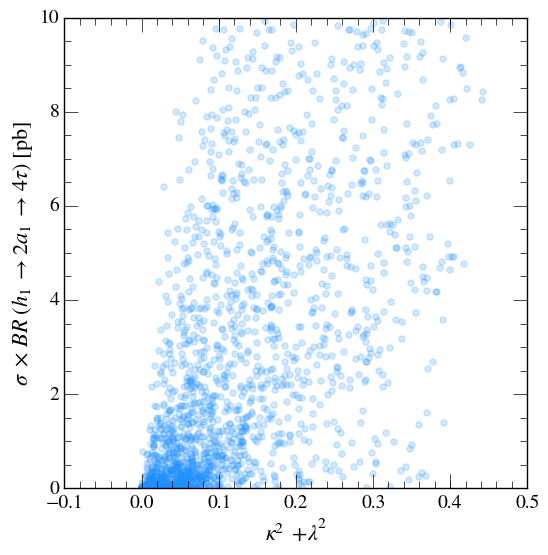

In [167]:
plot_scatter(df=df_pass_all.query('ma1<10.5'), yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam_sq', alpha=0.2, color='dodgerblue')
plt.xlabel(KAPPA_LAMBDA_SQ_STR)
plt.ylabel(XSEC_BR_H1_2A1_4TAU_STR)
# plt.yscale('log')
plt.ylim(1E-3, 10)

(0, 10)

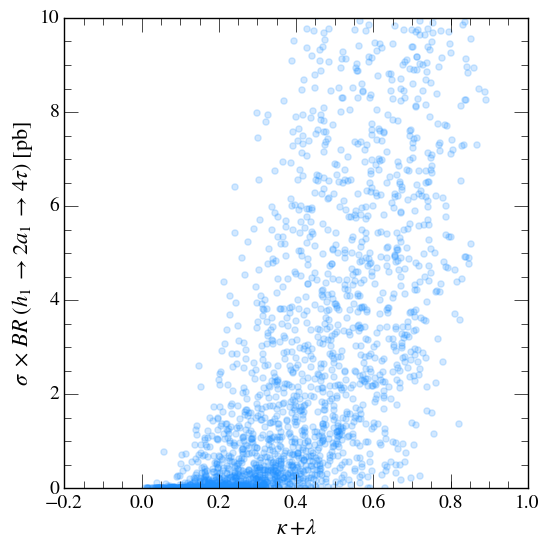

In [168]:
plot_scatter(df=df_pass_all.query('ma1<10.5'), yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam', alpha=0.2, color='dodgerblue')
plt.xlabel(KAPPA_LAMBDA_STR)
plt.ylabel(XSEC_BR_H1_2A1_4TAU_STR)
# plt.yscale('log')
plt.ylim(0, 10)

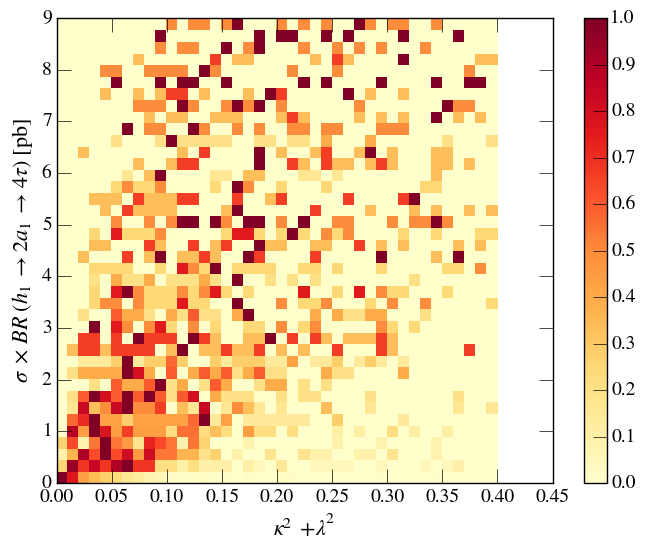

In [169]:
_ = plot_histogram2d(df=df_pass_all.query('ma1<10.5').dropna(subset=['xsec_8_ggf_h1_2a1_4tau']), 
                     yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam_sq', 
                     range=[[0, 0.4],[0, 9]], 
                     bins=[40,40],
#                      norm=LogNorm(),
                     norm_axis='y',
                     cmap='YlOrRd')
plt.xlabel(KAPPA_LAMBDA_SQ_STR)
plt.ylabel(XSEC_BR_H1_2A1_4TAU_STR)

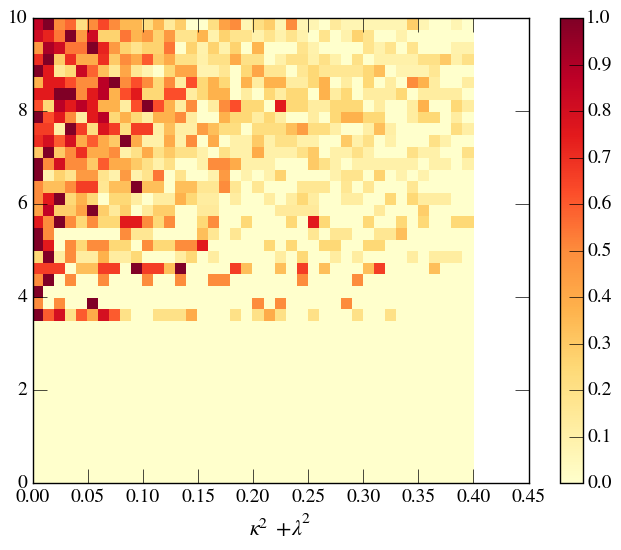

In [170]:
_ = plot_histogram2d(df=df_pass_all.query('ma1<10.5').dropna(subset=['xsec_8_ggf_h1_2a1_4tau']), 
                     yvar='ma1', xvar='kap_lam_sq', 
                     range=[[0, 0.4],[0, 10]], 
                     bins=[40,40],
#                      norm=LogNorm(),
                     norm_axis='y',
                     cmap='YlOrRd')
plt.xlabel(r'$\kappa^2 + \lambda^2$')


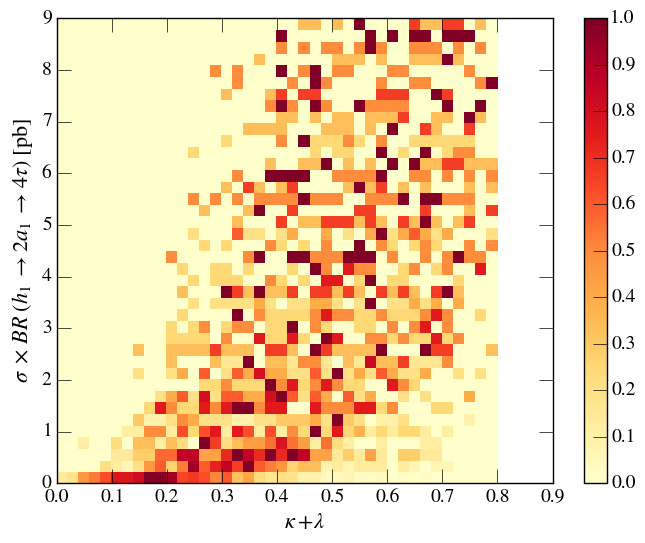

In [171]:
_ = plot_histogram2d(df=df_pass_all.query('ma1<10.5').dropna(subset=['xsec_8_ggf_h1_2a1_4tau']), 
                     yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam', 
                     range=[[0, 0.8],[0, 9]], 
                     bins=[40,40],
#                      norm=LogNorm(),
                     norm_axis='y',
                     cmap='YlOrRd')
plt.xlabel(KAPPA_LAMBDA_STR)
plt.ylabel(XSEC_BR_H1_2A1_4TAU_STR)

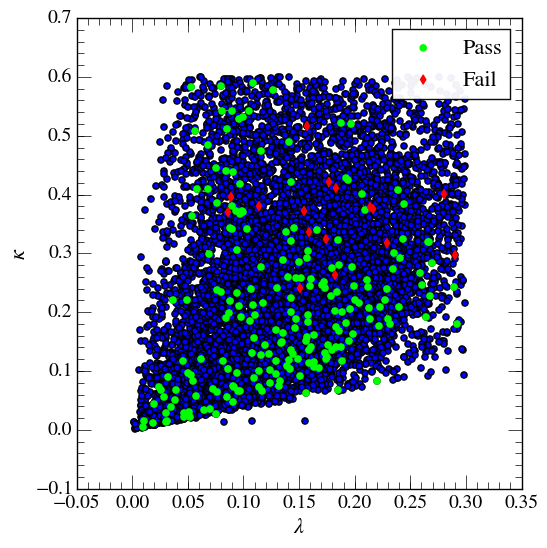

In [172]:
plot_scatter(df=df_pass_all.query('pass_strict'),
             xvar='lambda_', yvar='kappa')
plot_scatter(ax=plt.gca(), df=df_pass_all.query('pass_strict & pass_limits_xsec_8_ggf_h1_2a1_4tau & ma1<10.5'), 
             xvar='lambda_', yvar='kappa', color='lime', label='Pass')
# plot_scatter(ax=plt.gca(), df=df_pass_all.query('ma1<10.5 & pass_strict & not pass_limits_xsec_8_ggf_h1_2a1_4tau'), 
#              xvar='lambda_', yvar='kappa', color='red', marker='d', label='Fail')
plot_scatter(ax=plt.gca(), df=df_pass_all.query('ma1<10.5 & pass_strict & not pass_limits_xsec_8_ggf_h1_2a1_4tau'), 
             xvar='lambda_', yvar='kappa', color='red', marker='d', label='Fail')
plt.xlabel(LAMBDA_STR)
plt.ylabel(KAPPA_STR)
plt.legend(loc='best')

In [173]:
from pprint import pprint

In [174]:
@save_fig
def plot_hist_pass_fail(df, var, ratio=True, title='', **kwargs):
    if ratio:
        fig = generate_fig(size=[8, 10])
        ax1 = plt.subplot2grid((3, 3), (0, 0), colspan=3, rowspan=2)
        plt.subplots_adjust(hspace=0)
    else:
        fig, ax1 = generate_fig_axes()
        
    n, bins, patches = ax1.hist([df.query('pass_limits_xsec_8_ggf_h1_2a1_4tau')[var].values, 
                                df.query('not pass_limits_xsec_8_ggf_h1_2a1_4tau')[var].values],
                               bins=25, #range=nmssm_params_extended[var].range,
                               color=['dodgerblue', 'red'], linewidth=2, 
                               histtype='barstacked', rwidth=1,
                               label=['Survive new limits', 'Excluded by new limits'])
    # hacky styling :(((
    for p in patches[0].patches:
        p.__dict__['_hatch'] = r'\\'

    for p in patches[1].patches:
        p.__dict__['_hatch'] = '///'

    ax1.set_ylabel('N')
    ax1.set_ylim(top=plt.ylim()[1] * 1.25) # hack spacing to get legend in there
    ax1.minorticks_on()
    
    plt.legend(loc='best', frameon=False)    
    plt.suptitle(title)
    
    if not ratio:
        if var in nmssm_params_extended:
            ax1.set_xlabel(nmssm_params_extended[var].label)
        elif 'xlabel' in kwargs:
            ax1.set_xlabel(kwargs['xlabel'])
        else:
            ax1.set_xlabel(var)

    if ratio:
        plt.setp(ax1.get_xticklabels(), visible=False)

        ax2 = plt.subplot2grid((3, 3), (2, 0), colspan=3)
        
        ratios = n[1] / (n[0] + n[1])  # if NOT stacked
        ratios = (n[1] - n[0]) / (n[1])  # if stacked
        centers = [0.5*(bins[i] + bins[i+1]) for i, _ in enumerate(bins[:-1])]
        ax2.plot(centers, ratios, 'o')

        mean_excluded = n[1].sum()/(n[0].sum() + n[1].sum()) # if NOT stacked
        mean_excluded = (n[1].sum()-n[0].sum())/n[1].sum() # if stacked
        ax2.plot([bins[0], bins[-1]], [mean_excluded, mean_excluded], 
                 linewidth=2, linestyle='dashed', label='Total excluded fraction')
        
        ax2.set_ylim(0, min(1, ratios.max() * 1.25))
        ax2.set_ylabel('Fraction of\npoints excluded')
        if var in nmssm_params_extended:
            ax2.set_xlabel(nmssm_params_extended[var].label)
        elif 'xlabel' in kwargs:
            ax2.set_xlabel(kwargs['xlabel'])
        else:
            ax2.set_xlabel(var)

        ax2.grid(which='major')
        
    plt.legend(loc='best', frameon=False, fontsize=16)    

In [175]:
df_s = df_pass_all.query('pass_strict & ma1<10.5')

Setting backend pdf
Setting backend png


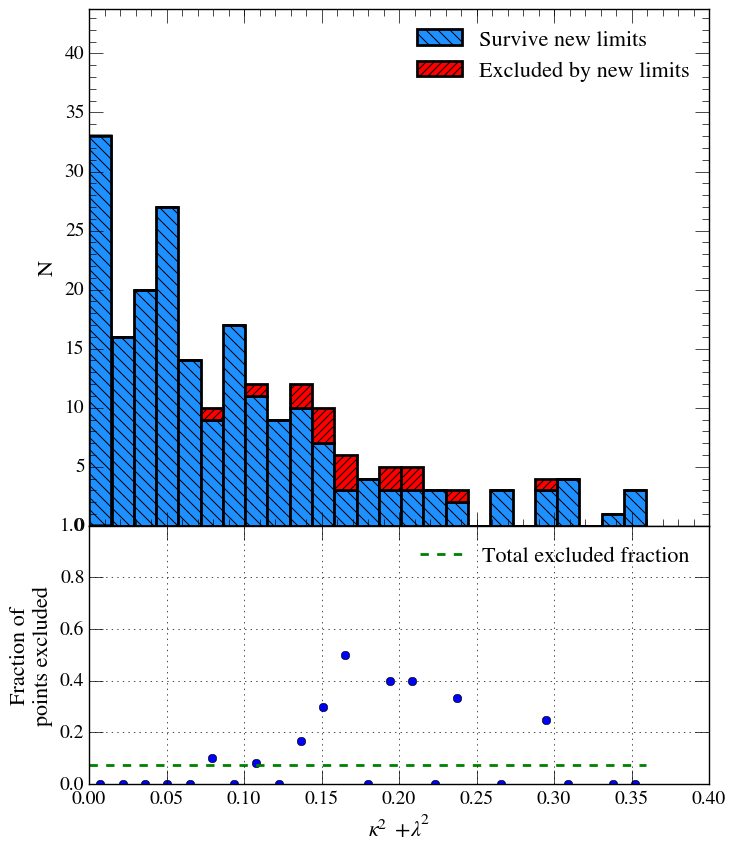

In [176]:
plot_hist_pass_fail(df_s, 'kap_lam_sq', xlabel=r'$\kappa^2 + \lambda^2$', 
                    filename='Thesis_plots_5/New_Limits/kappa_lambda_sq_hist_passfail.pdf')

Setting backend pdf
Setting backend png


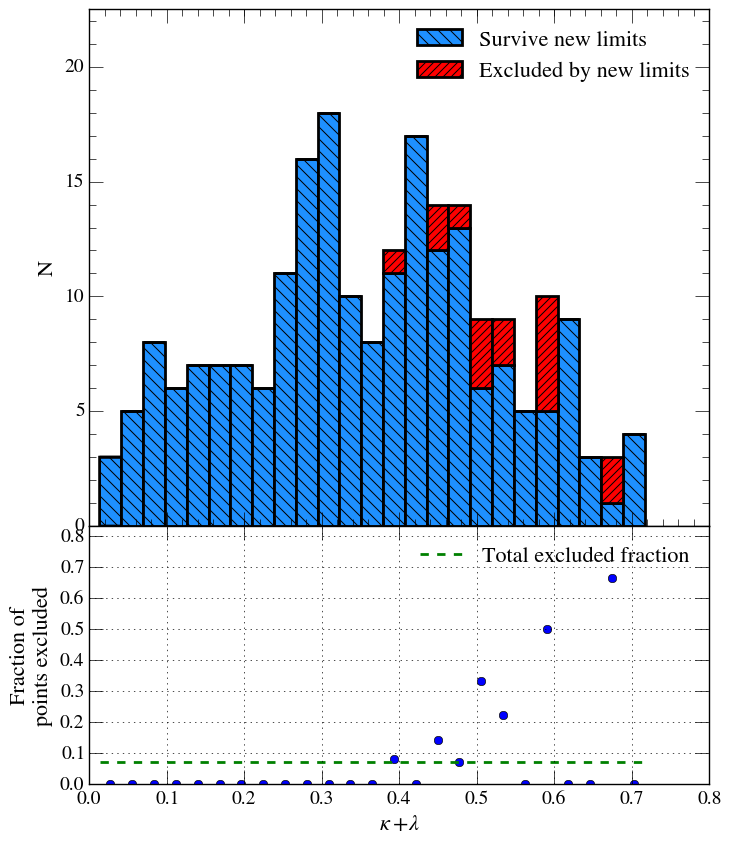

In [177]:
plot_hist_pass_fail(df_s, 'kap_lam', xlabel=r'$\kappa + \lambda$', 
                    filename='Thesis_plots_5/New_Limits/kappa_lambda_hist_passfail.pdf')

Setting backend pdf
Setting backend png


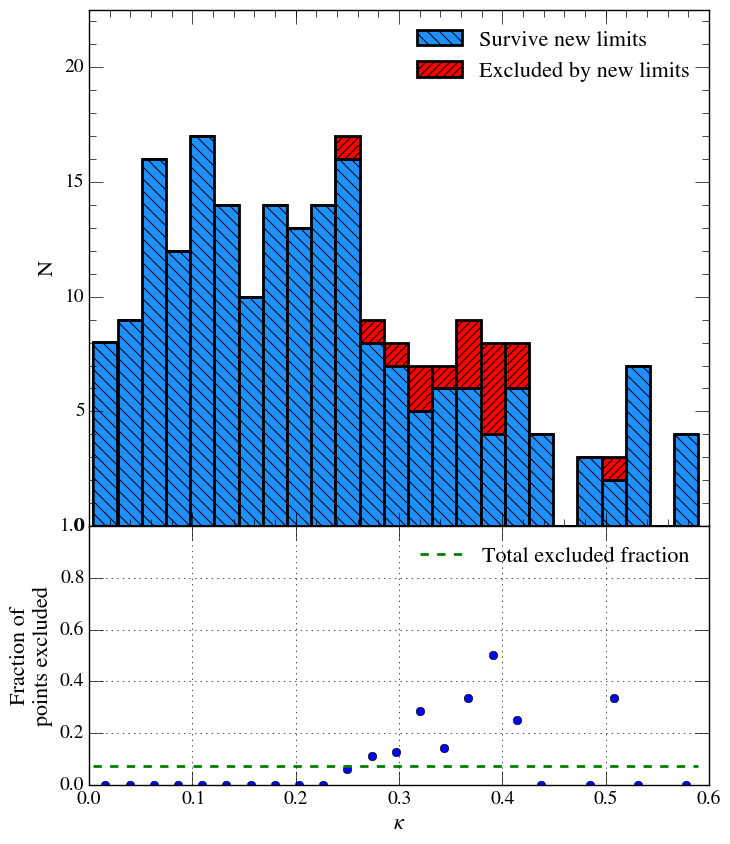

In [178]:
plot_hist_pass_fail(df_s, 'kappa', filename='Thesis_plots_5/New_Limits/kappa_hist_passfail.pdf')

Setting backend pdf
Setting backend png


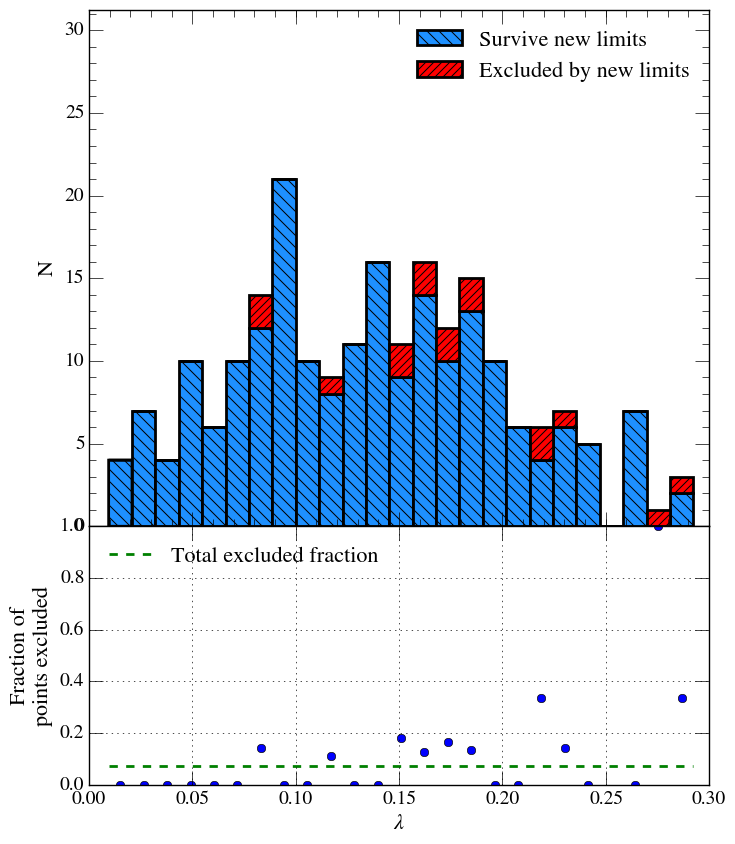

In [179]:
plot_hist_pass_fail(df_s, 'lambda_', filename='Thesis_plots_5/New_Limits/lambda_hist_passfail.pdf')

Setting backend pdf
Setting backend png


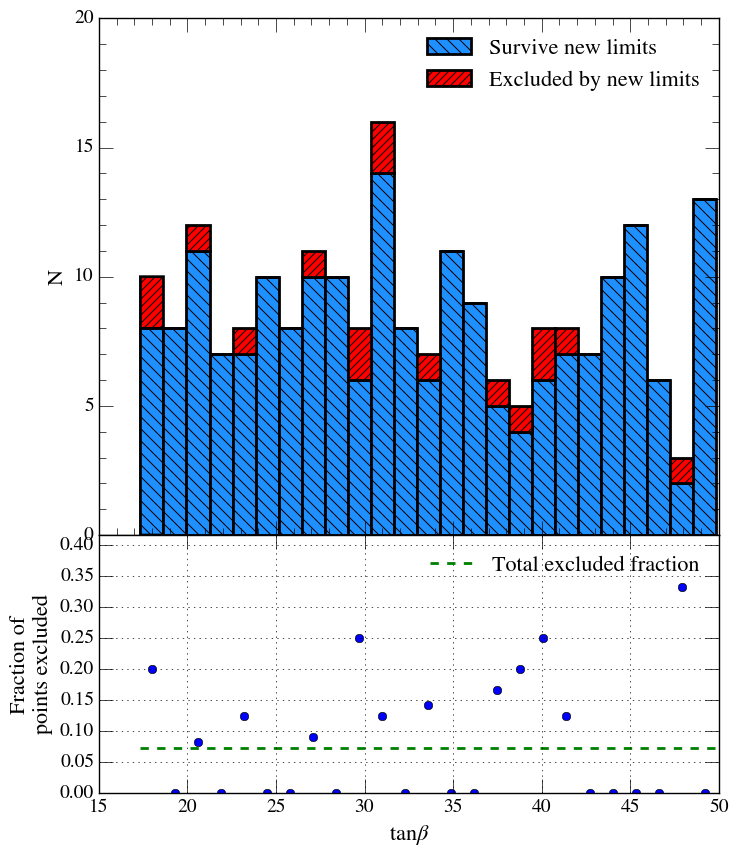

In [180]:
plot_hist_pass_fail(df_s, 'tgbeta', filename='Thesis_plots_5/New_Limits/tgbeta_hist_passfail.pdf')

Setting backend pdf
Setting backend png


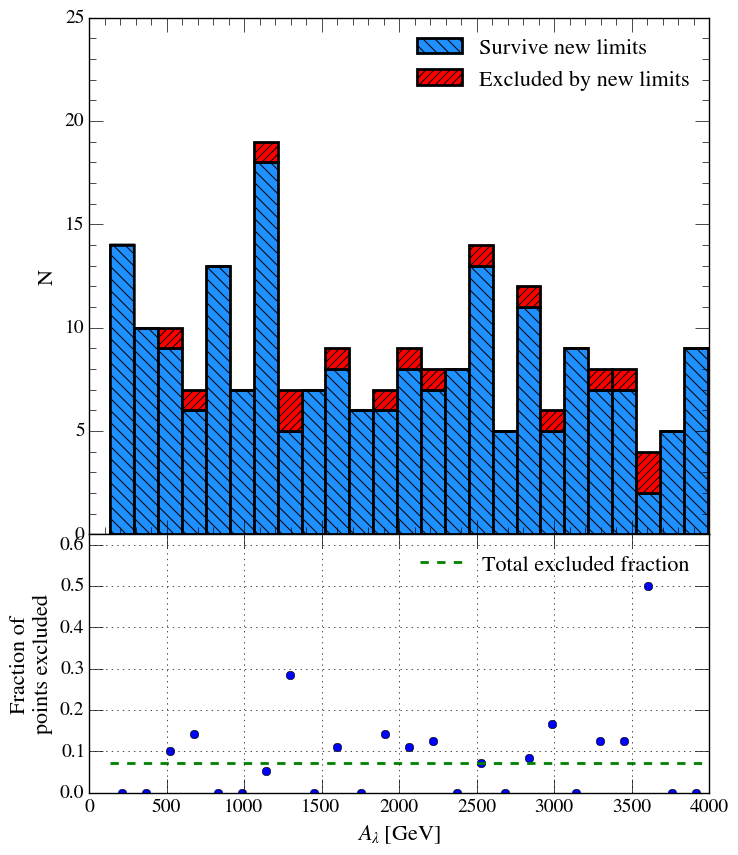

In [181]:
plot_hist_pass_fail(df_s, 'alambda', filename='Thesis_plots_5/New_Limits/alambda_hist_passfail.pdf')

Setting backend pdf
Setting backend png


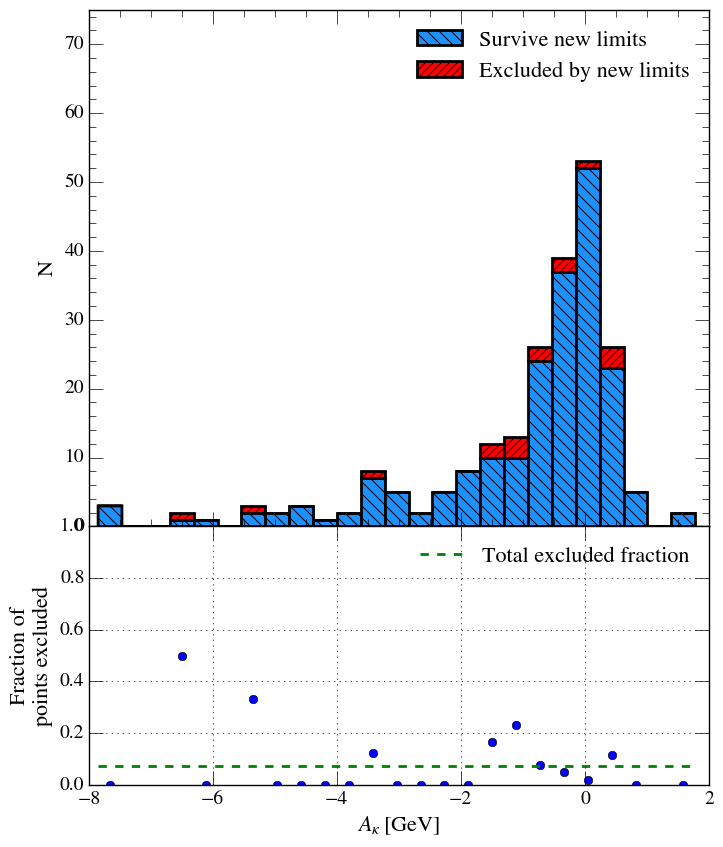

In [182]:
plot_hist_pass_fail(df_s, 'akappa', filename='Thesis_plots_5/New_Limits/akappa_hist_passfail.pdf')

Setting backend pdf
Setting backend png


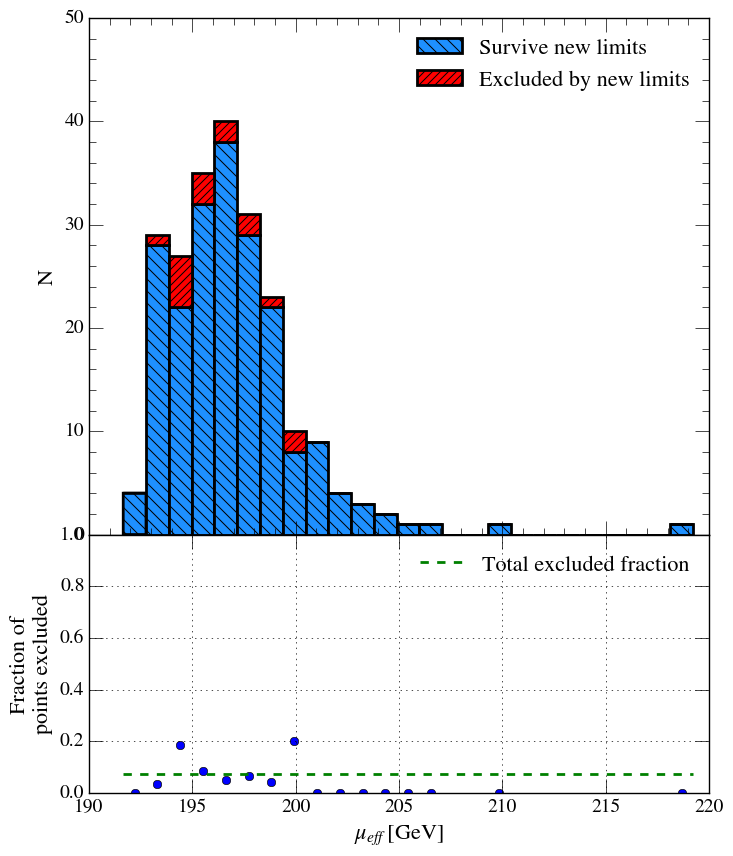

In [183]:
plot_hist_pass_fail(df_s, 'mueff', filename='Thesis_plots_5/New_Limits/mueff_hist_passfail.pdf')

Setting backend pdf
Setting backend png


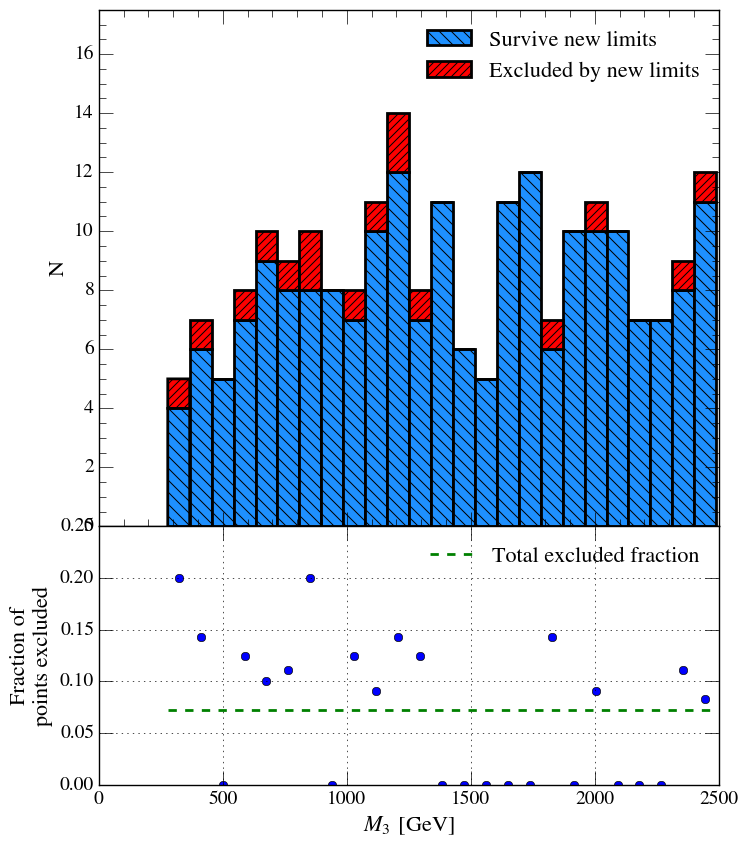

In [184]:
plot_hist_pass_fail(df_s, 'm3', filename='Thesis_plots_5/New_Limits/m3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


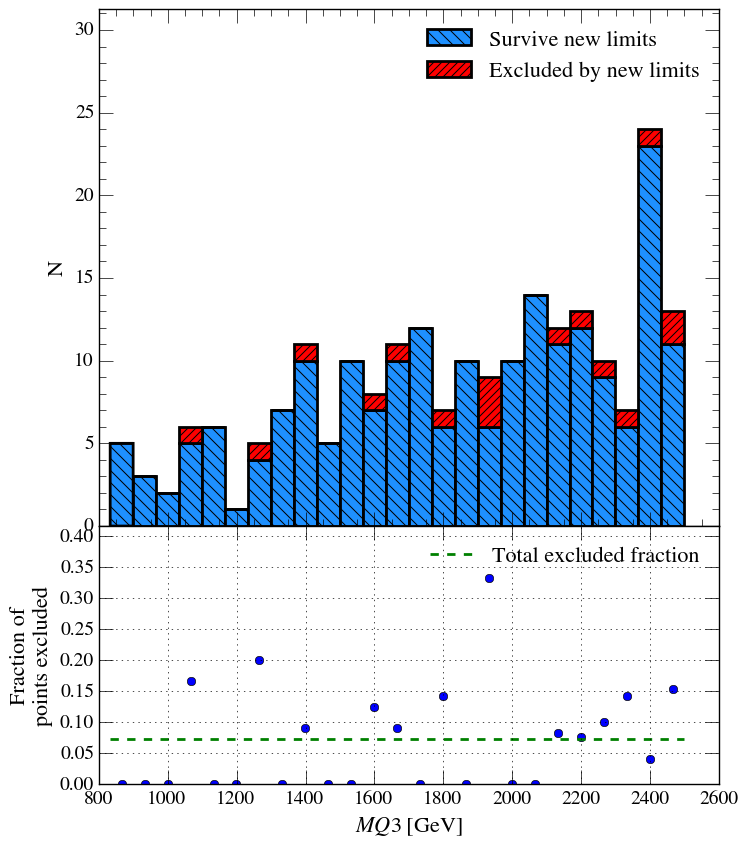

In [185]:
plot_hist_pass_fail(df_s, 'mq3', filename='Thesis_plots_5/New_Limits/mq3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


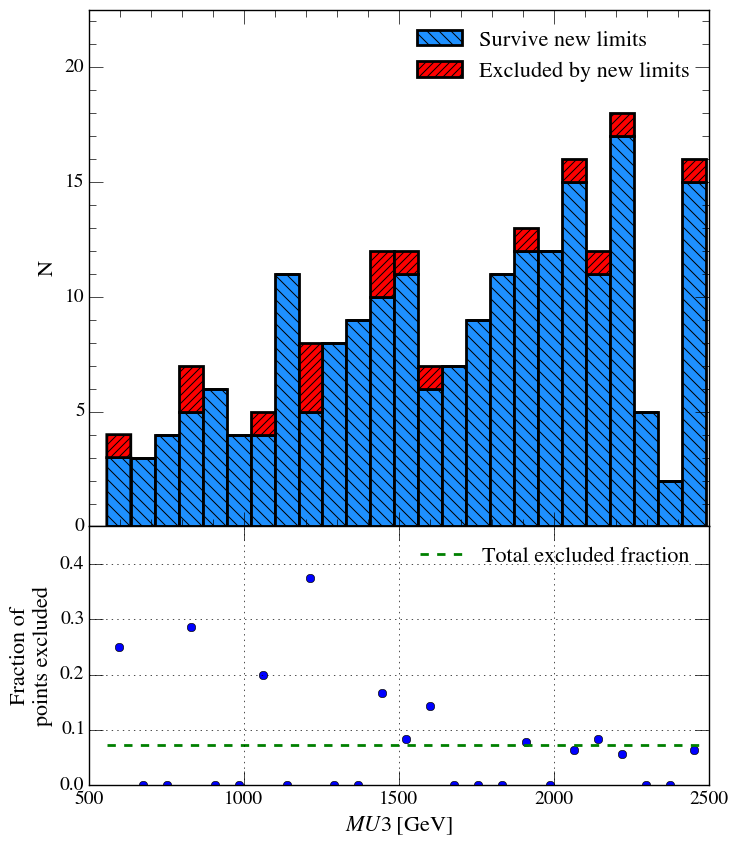

In [186]:
plot_hist_pass_fail(df_s, 'mu3', filename='Thesis_plots_5/New_Limits/mu3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


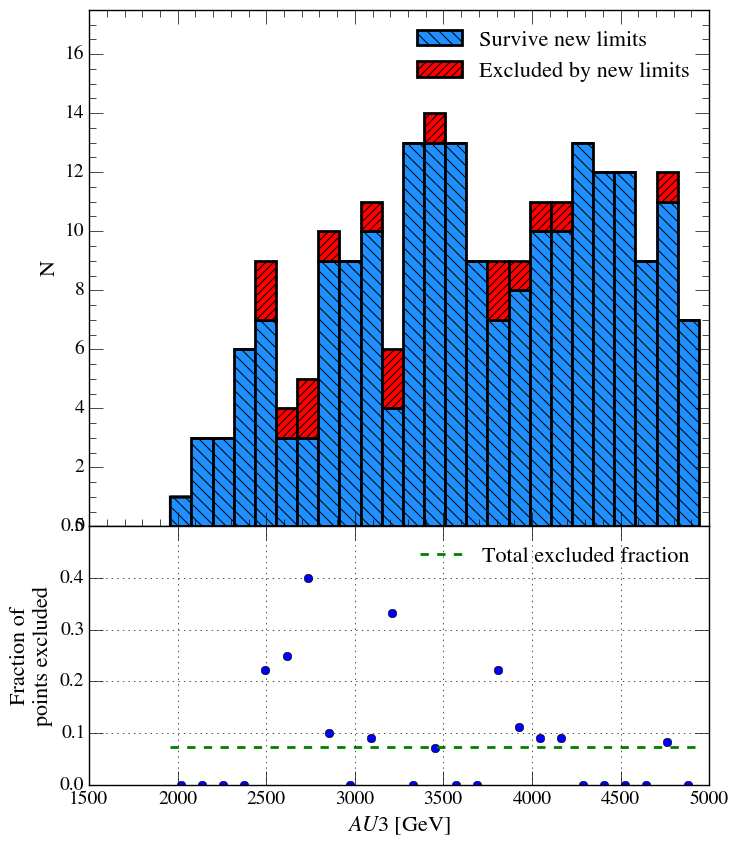

In [187]:
plot_hist_pass_fail(df_s, 'au3', filename='Thesis_plots_5/New_Limits/au3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


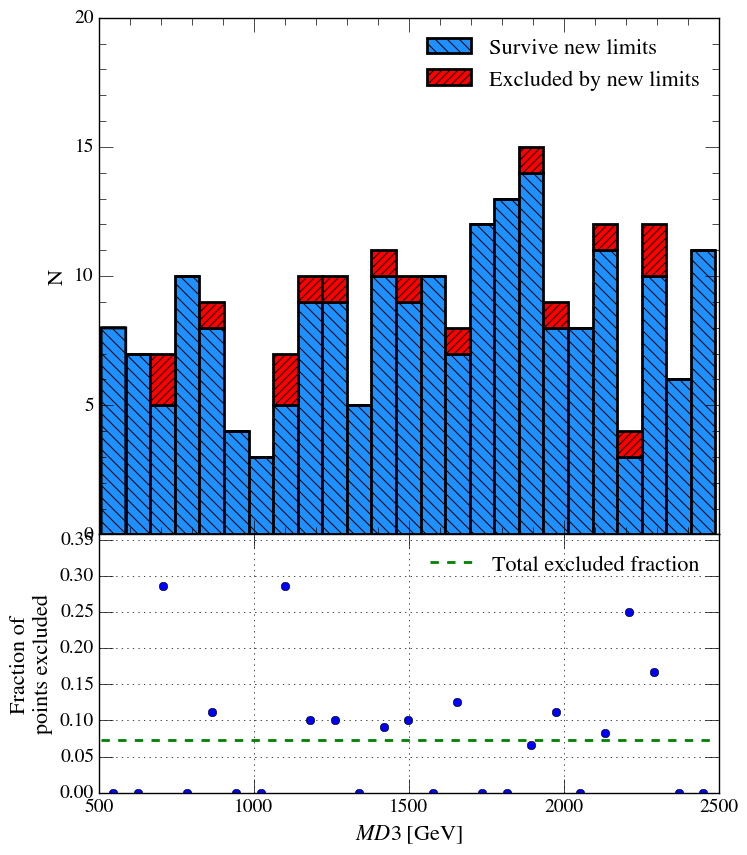

In [188]:
plot_hist_pass_fail(df_s, 'md3', filename='Thesis_plots_5/New_Limits/md3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


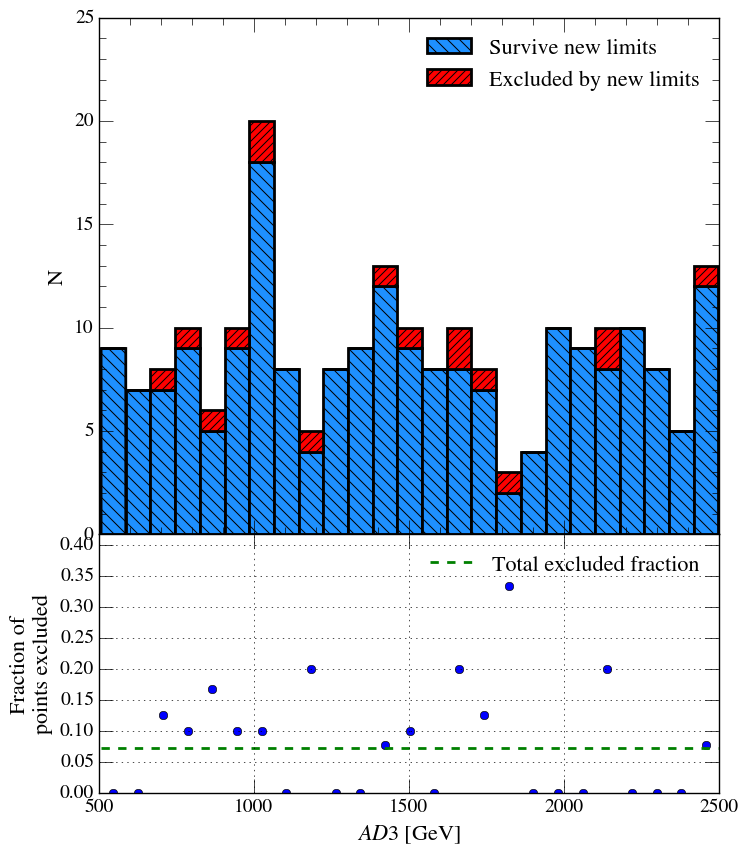

In [189]:
plot_hist_pass_fail(df_s, 'ad3', filename='Thesis_plots_5/New_Limits/ad3_hist_passfail.pdf')

# Non-Higgs Experimental Constraints

## Relic density, $\Omega h^2$

Setting backend png
Setting backend png


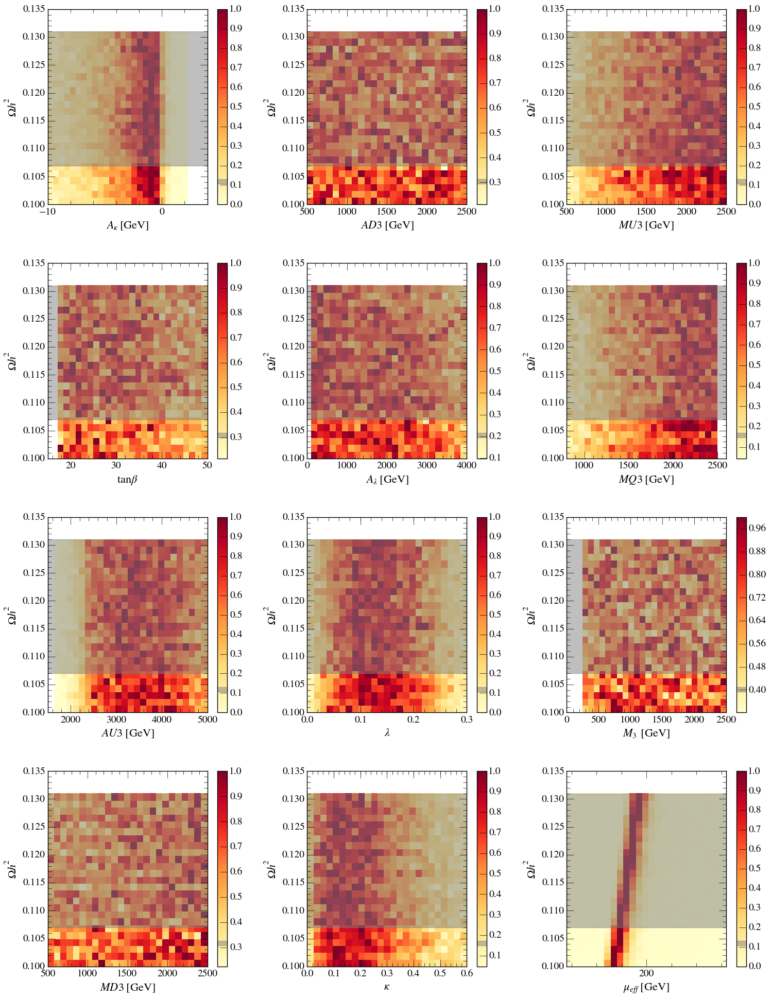

In [190]:
@save_fig
def plot_omega_input_hist2d(df):
    plot_input_params_hist2d(df=df.query('0.1 < omega < 0.14'), 
                             yvar='omega', ylabel=r'$\Omega h^2$', 
                             param_dict=nmssm_params_extended,
                             cmap=plt.get_cmap('YlOrRd'), 
                             norm_axis='y')
                             #, norm=LogNorm(vmin=1E-3))
    for ax in plt.gcf().axes:
        make_highlight_region(ax, OMEGA_LIM, 'Y')
        
plot_omega_input_hist2d(df_pass_all.query('pass_NT & pass_del_a_mu'),
                        filename='Thesis_plots_5/Exp_cons/omega_input_hist2d.png')

Setting backend png
Setting backend png


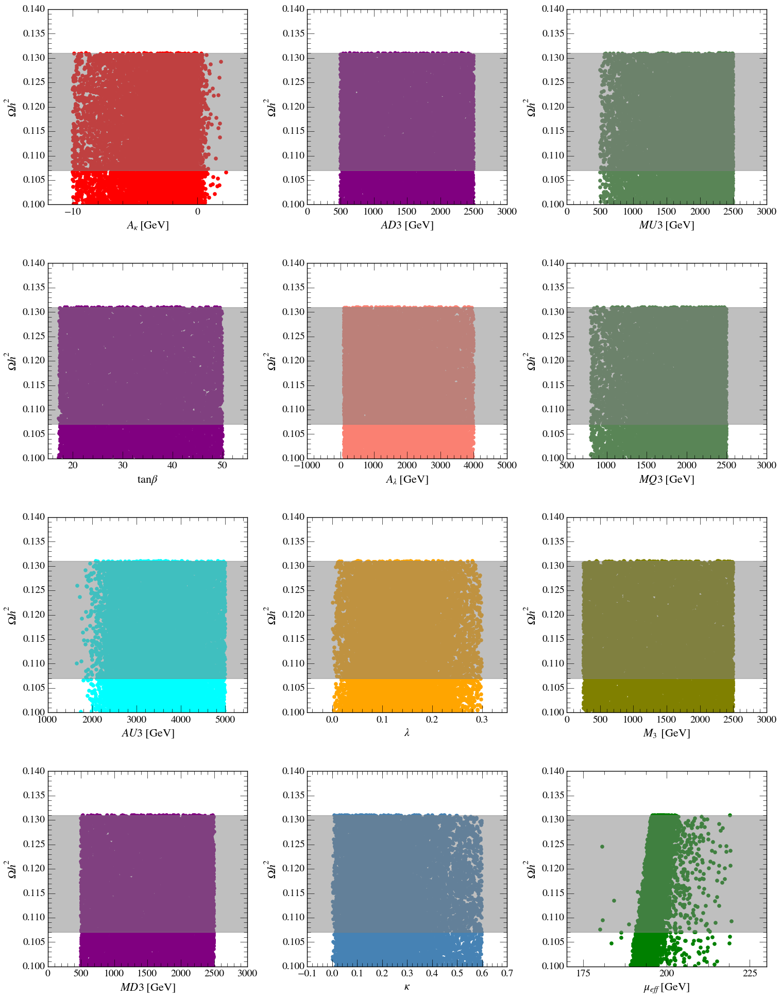

In [191]:
@save_fig
def plot_omega_input_scatter(df):
    plot_input_params_scatters(df=df.query('0.1 < omega < 0.14'), 
                               yvar='omega', ylabel=r'$\Omega h^2$', 
                               yrange=[0.1, 0.14],
                               param_dict=nmssm_params_extended)
    for ax in plt.gcf().axes:
        make_highlight_region(ax, OMEGA_LIM, 'Y')

plot_omega_input_scatter(df_pass_all.query('pass_NT & pass_del_a_mu'),
                         filename='Thesis_plots_5/Exp_cons/omega_input_scatter.png')

Setting backend png
Setting backend png


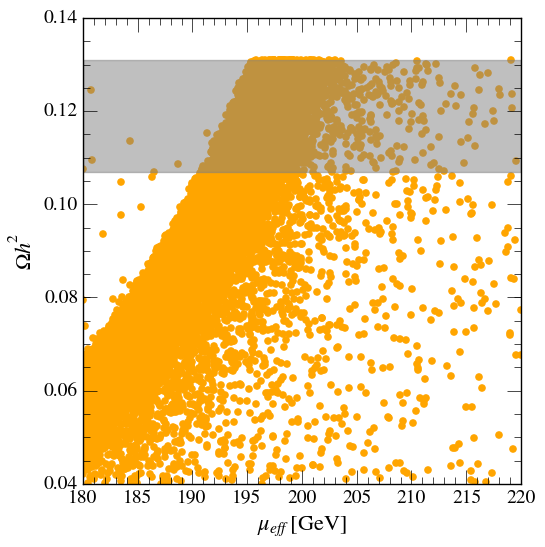

In [192]:
@save_fig
def plot_omega_mueff_scatter(df):
    plot_scatter(df=df.query('0.04 < omega < 0.14'), 
                 xvar='mueff', yvar='omega', 
                 xlabel=MUEFF_STR, ylabel=OMEGA_STR,
                 color='orange')
    plt.ylim(0.04, 0.14)
    plt.xlim(180, 220)
    make_highlight_region(plt.gca(), OMEGA_LIM, 'Y')
        
plot_omega_mueff_scatter(df_pass_all.query('pass_NT & pass_del_a_mu'), 
                         filename='Thesis_plots_5/Exp_cons/omega_mueff_scatter.png')

Setting backend png
Setting backend png


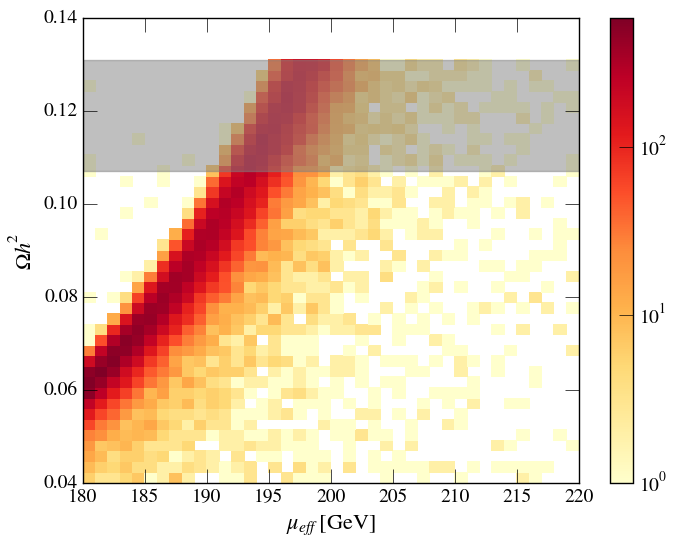

In [193]:
@save_fig
def plot_omega_mueff_hist2d(df):
    plot_histogram2d(df=df.query('0.04 < omega<0.14'), 
                     xvar='mueff', yvar='omega', 
                     xlabel=MUEFF_STR, ylabel=OMEGA_STR,
                     cmap='YlOrRd', bins=[40, 40], norm=LogNorm())
    
    make_highlight_region(plt.gca(), OMEGA_LIM, 'Y')
        
plot_omega_mueff_hist2d(df_pass_all.query('pass_NT & pass_del_a_mu'), 
                        filename='Thesis_plots_5/Exp_cons/omega_mueff_hist2d.png')

## $\Delta a_{\mu}$

Setting backend png
Setting backend png


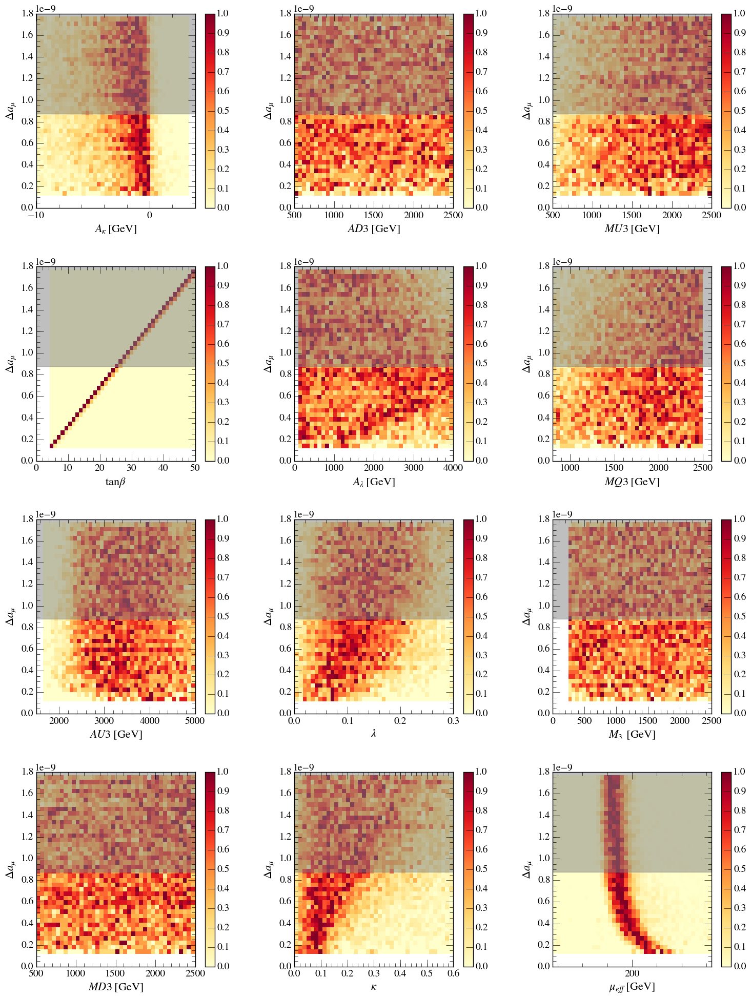

In [194]:
@save_fig
def plot_del_a_mu_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='Del_a_mu',
                             ylabel=DEL_A_MU_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', 
                             norm_axis='y',
    #                          norm=LogNorm(vmin=1E-3), 
    #                          norm=Normalize(vmin=0, vmax=1), 
                             bins=[40,40])
    for ax in plt.gcf().axes:
        make_highlight_region(ax, DEL_A_MU_LIM, 'Y')

plot_del_a_mu_input_hist2d(df_pass_all.query('pass_NT & pass_relic'), 
                           filename='Thesis_plots_5/Exp_cons/del_a_mu_input_hist2d.png')

Setting backend png
Setting backend png


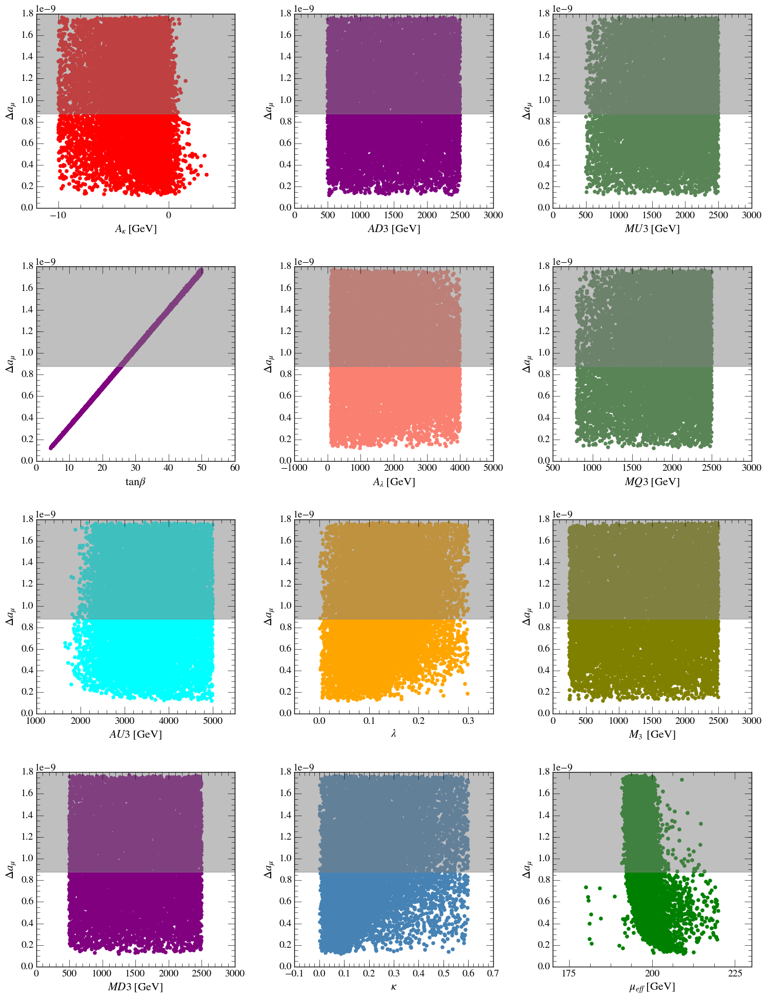

In [210]:
@save_fig
def plot_del_a_mu_input_scatter(df):
    plot_input_params_scatters(df=df, 
                               ylabel=DEL_A_MU_STR,
                               yvar='Del_a_mu', yrange=[0, 1.8E-9],
                               param_dict=nmssm_params_extended)
    for ax in plt.gcf().axes:
        make_highlight_region(ax, DEL_A_MU_LIM, 'Y')
        
plot_del_a_mu_input_scatter(df_pass_all.query('pass_NT & pass_relic'),
                           filename='Thesis_plots_5/Exp_cons/del_a_mu_input_scatter.png')

Setting backend pdf
Setting backend png


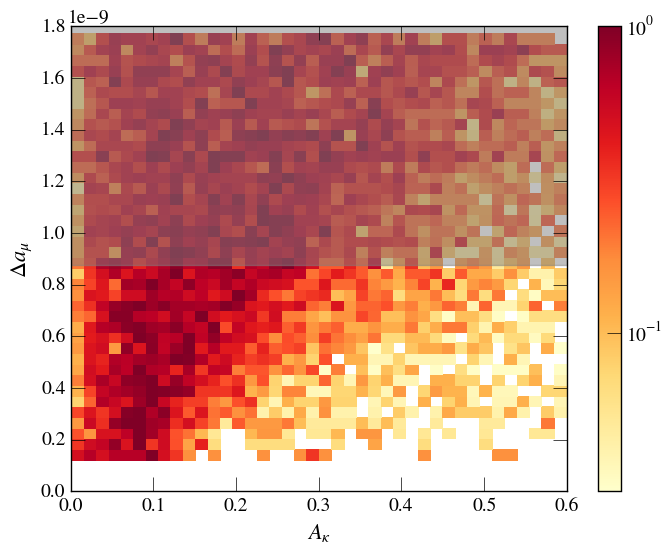

In [196]:
@save_fig
def plot_del_a_mu_kappa_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='kappa', yvar='Del_a_mu', 
    #                      range=[[2, 10], [0, 0.7E-8]], 
                         bins=[40, 40], 
                         norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
                         norm=LogNorm(),
                         xlabel=r'$A_{\kappa}$', ylabel=r'$\Delta a_{\mu}$')

    make_highlight_region(plt.gca(), DEL_A_MU_LIM, 'Y')
    
plot_del_a_mu_kappa_hist2d(df_pass_all.query('pass_NT & pass_relic'),
                           filename='Thesis_plots_5/Exp_cons/del_a_mu_kappa_hist2d.pdf')

Setting backend pdf
Setting backend png


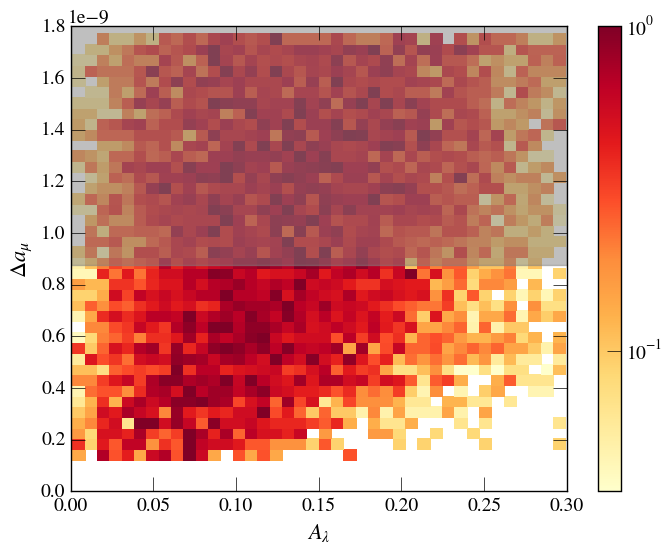

In [197]:
@save_fig
def plot_del_a_mu_lambda_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='lambda_', yvar='Del_a_mu', 
    #                      range=[[2, 10], [0, 0.7E-8]], 
                         bins=[40, 40], 
                         norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
                         norm=LogNorm(),
                         xlabel=r'$A_{\lambda}$', ylabel=r'$\Delta a_{\mu}$')

    make_highlight_region(plt.gca(), DEL_A_MU_LIM, 'Y')
    
plot_del_a_mu_lambda_hist2d(df_pass_all.query('pass_NT & pass_relic'),
                           filename='Thesis_plots_5/Exp_cons/del_a_mu_lambda_hist2d.pdf')

Setting backend pdf
Setting backend png


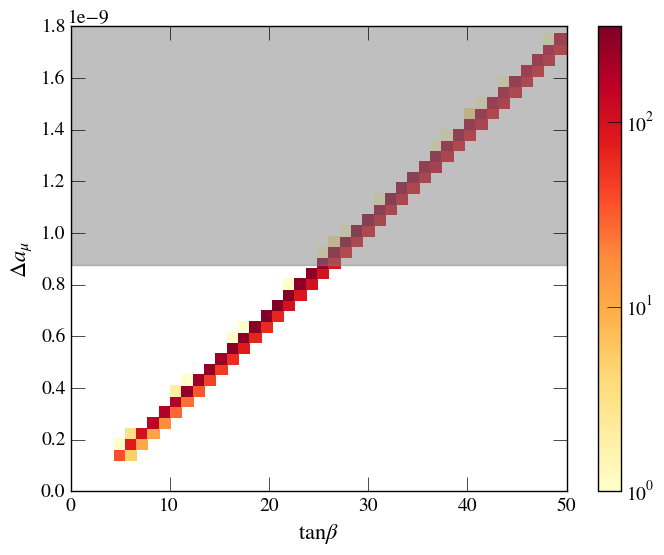

In [198]:
@save_fig
def plot_del_a_mu_tgbeta_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='tgbeta', yvar='Del_a_mu', 
    #                      range=[[2, 10], [0, 0.7E-8]], 
                         bins=[40, 40], 
#                          norm_axis='x', 
                         cmap=plt.get_cmap('YlOrRd'), 
                         norm=LogNorm(),
                         xlabel=r'$\tan\beta$', ylabel=r'$\Delta a_{\mu}$')

    make_highlight_region(plt.gca(), DEL_A_MU_LIM, 'Y')
        
plot_del_a_mu_tgbeta_hist2d(df_pass_all.query('pass_NT & pass_relic'),
                            filename='Thesis_plots_5/Exp_cons/del_a_mu_tgbeta_hist2d.pdf')

Setting backend png
Setting backend png


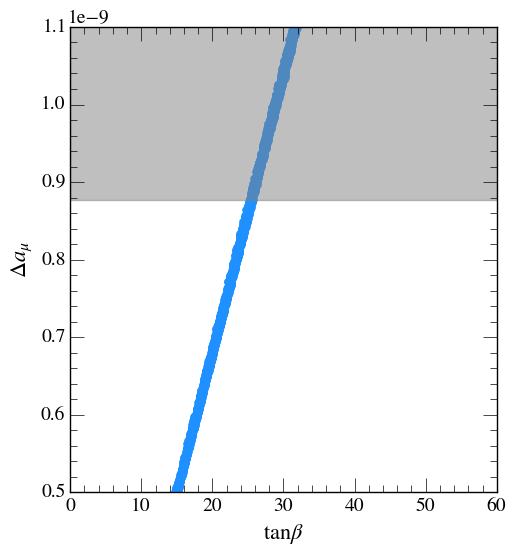

In [199]:
@save_fig
def plot_del_a_mu_tgbeta_scatter(df):
    _ = plot_scatter(df=df, xvar='tgbeta', yvar='Del_a_mu', 
                     xlabel=r'$\tan\beta$', ylabel=r'$\Delta a_{\mu}$',
                     color='dodgerblue')

    plt.ylim(0.5E-9, 1.1E-9)
    make_highlight_region(plt.gca(), DEL_A_MU_LIM, 'Y')
        
plot_del_a_mu_tgbeta_scatter(df_pass_all.query('pass_NT & pass_relic'),
                             filename='Thesis_plots_5/Exp_cons/del_a_mu_tgbeta_scatter.png')


## $B_S \to \mu\mu$

Setting backend png
Setting backend png


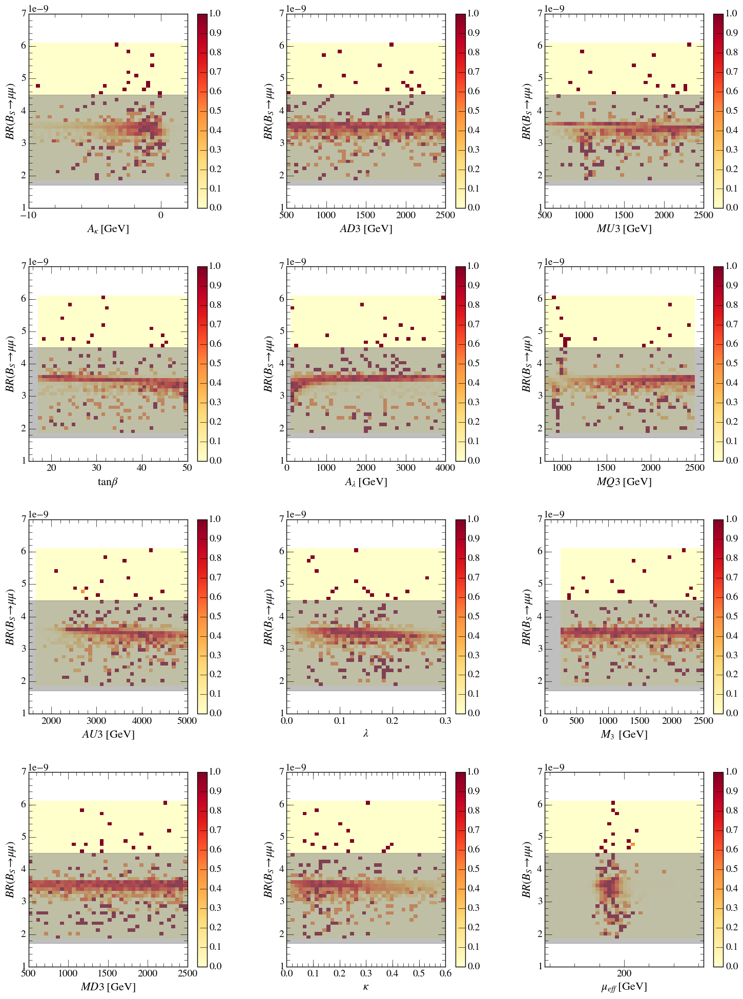

In [200]:
@save_fig
def plot_bsmumu_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='bsmumu',
                             ylabel=BSMUMU_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', norm_axis='y',
    #                          norm=LogNorm(vmin=1E-3), 
    #                          norm=Normalize(vmin=0, vmax=1), 
                             bins=[40,40])
    for ax in plt.gcf().axes:
        make_highlight_region(ax, [1.72E-9, 4.5E-9], 'Y')

plot_bsmumu_input_hist2d(df_pass_all.query('pass_strict'), 
                         filename='Thesis_plots_5/Exp_cons/bsmumu_input_hist2d.png')

Setting backend png
Setting backend png


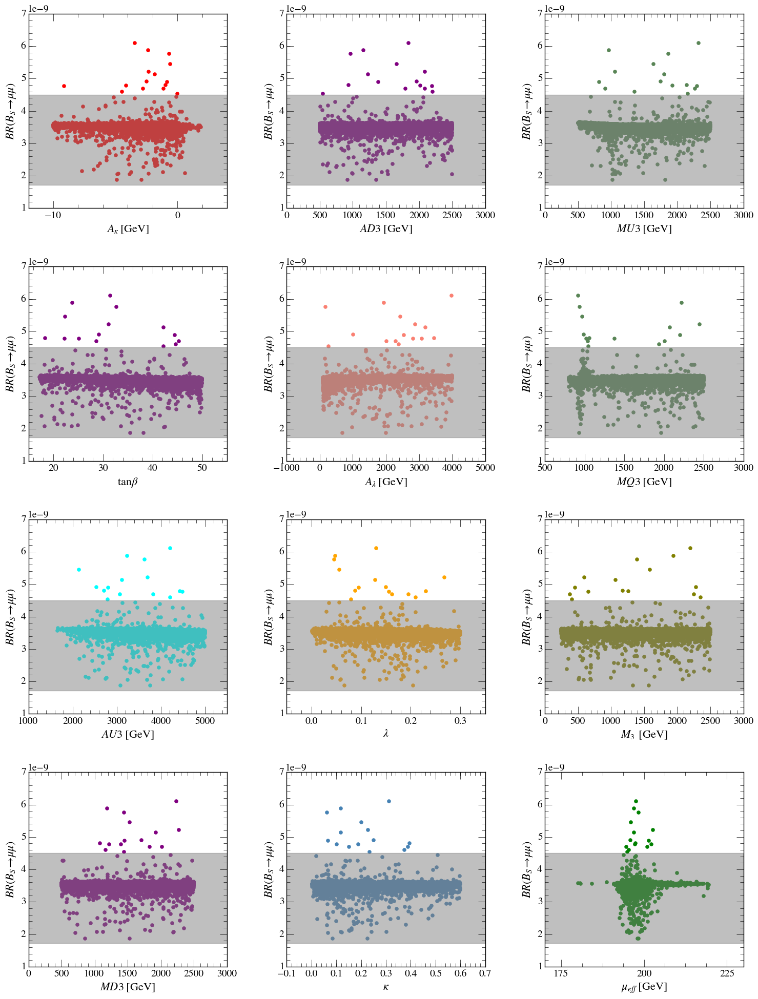

In [201]:
@save_fig
def plot_bsmumu_input_scatter(df):
    plot_input_params_scatters(df=df, 
                               yvar='bsmumu',
                               ylabel=BSMUMU_STR, 
                               yrange=[1E-9, 7E-9],
                               param_dict=nmssm_params_extended)
    
    for ax in plt.gcf().axes:
        make_highlight_region(ax, [1.72E-9, 4.5E-9], 'Y')

plot_bsmumu_input_scatter(df_pass_all.query('pass_strict'), 
                          filename='Thesis_plots_5/Exp_cons/bsmumu_input_scatter.png')

Setting backend png
Setting backend png


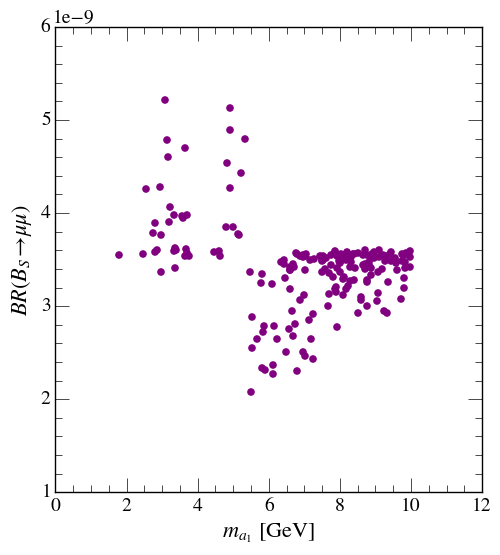

In [202]:
@save_fig
def plot_bsmumu_ma1_scatter(df):
    plot_scatter(df=df.query('ma1<10'),
                 xvar='ma1',
                 yvar='bsmumu',
                 xlabel=M_A1_STR,
                 ylabel=BSMUMU_STR,
                 color='purple')
    plt.ylim([1E-9, 6E-9])
#     plt.xlim()
#     make_highlight_region(plt.gca(), [1.72E-9, 4.5E-9], 'Y')


plot_bsmumu_ma1_scatter(df_pass_all.query('pass_strict'),
                        filename='Thesis_plots_5/Exp_cons/bsmumu_ma1_scatter.png')

Setting backend png
Setting backend png


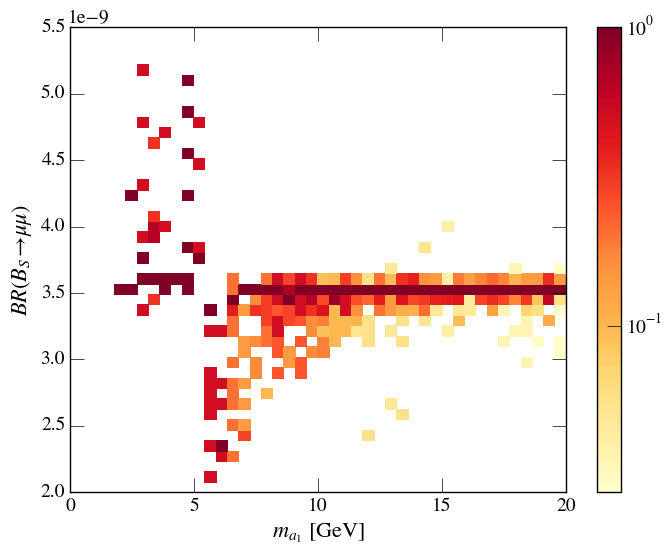

In [203]:
@save_fig
def plot_bsmumu_ma1_hist2d(df):
    plot_histogram2d(df=df.query('ma1<20'),
                     xvar='ma1',
                     yvar='bsmumu',
                     xlabel=M_A1_STR,
                     ylabel=BSMUMU_STR,
                     cmap='YlOrRd',
                     norm_axis='x',
                     bins=[40, 40],
                     norm=LogNorm())
#     plt.ylim([1E-9, 7E-9])

#     make_highlight_region(plt.gca(), [1.72E-9, 4.5E-9], 'Y')


plot_bsmumu_ma1_hist2d(df_pass_all.query('pass_strict'),
                        filename='Thesis_plots_5/Exp_cons/bsmumu_ma1_hist2d.png')

## R(D), R(D*)

Setting backend png
Setting backend png


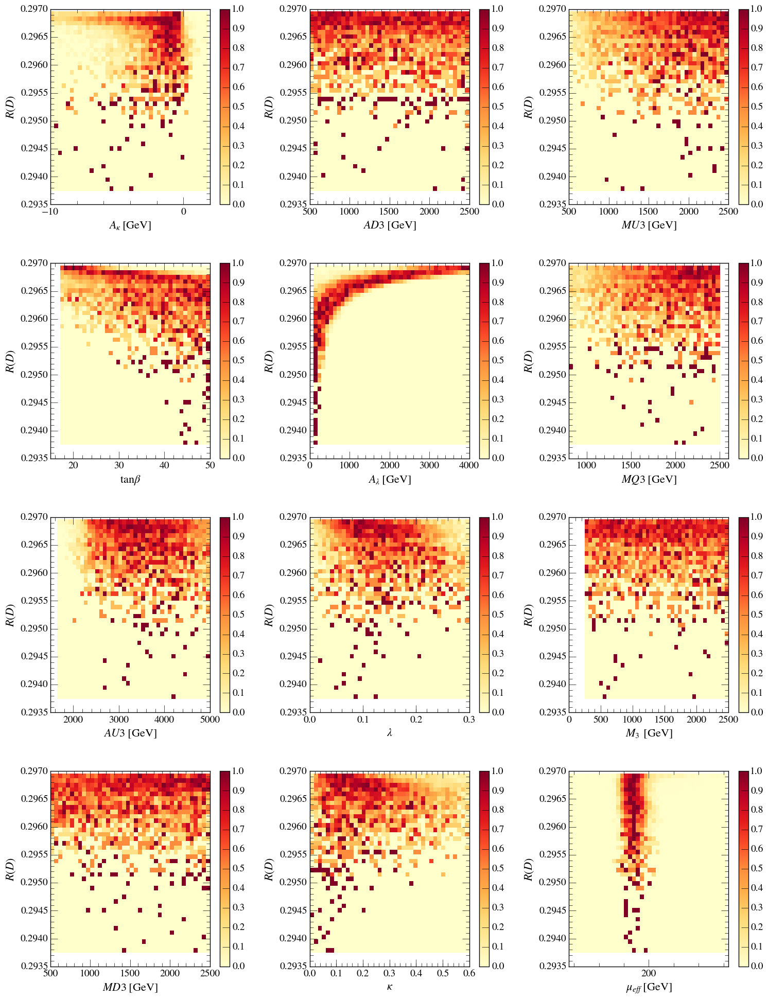

In [204]:
@save_fig
def plot_rd_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='rd',
                             ylabel=RD_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', norm_axis='y',
#                              norm=LogNorm(vmin=1E-2), 
                             bins=[40,40])
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RD_LIM, 'Y')

plot_rd_input_hist2d(df_pass_all.query('pass_strict'), 
                     filename='Thesis_plots_5/Exp_cons/rd_input_hist2d.png')

Setting backend png
Setting backend png


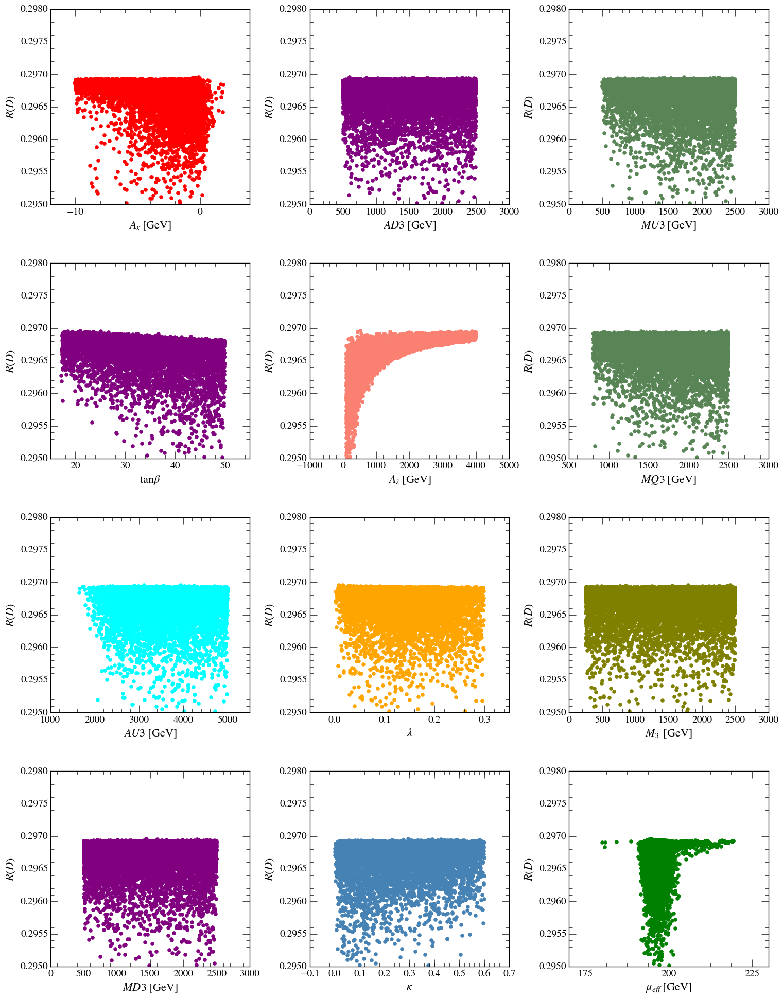

In [205]:
@save_fig
def plot_rd_input_scatter(df):
    plot_input_params_scatters(df=df, 
                               yvar='rd',
                               ylabel=RD_STR, 
                               yrange=[0.295, 0.298],
                               param_dict=nmssm_params_extended)
    
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RD_LIM, 'Y')

plot_rd_input_scatter(df_pass_all.query('pass_strict'), 
                     filename='Thesis_plots_5/Exp_cons/rd_input_scatter.png')

Setting backend png
Setting backend png


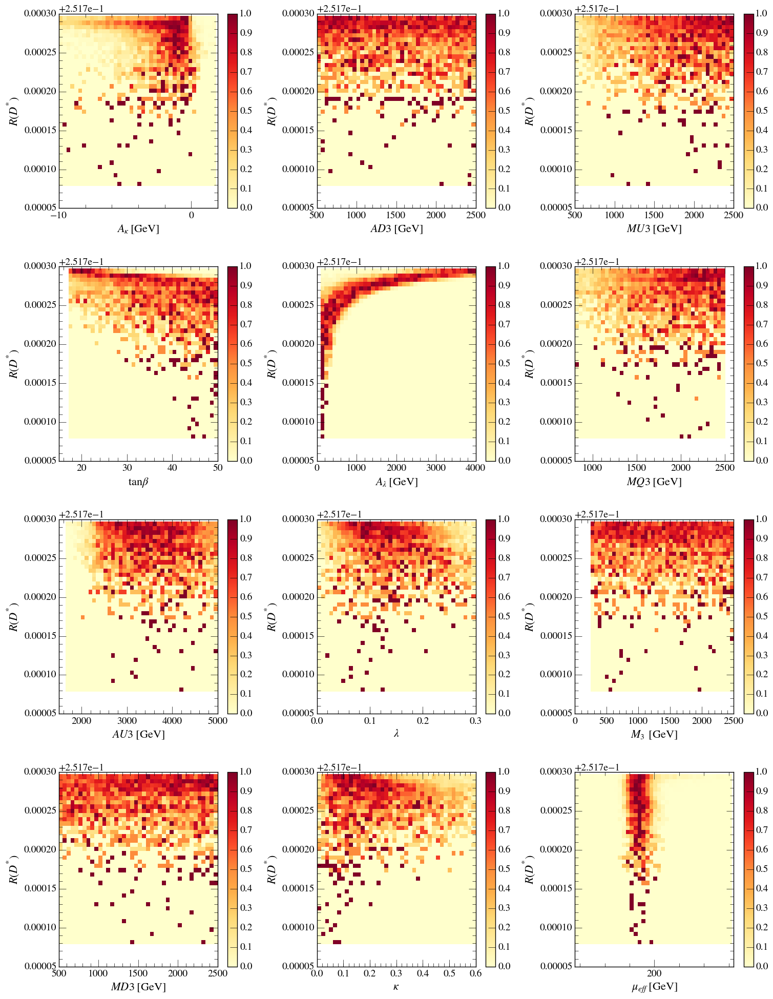

In [206]:
@save_fig
def plot_rds_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='rds',
                             ylabel=RDS_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', norm_axis='y',
    #                          norm=LogNorm(vmin=1E-3), 
                             bins=[40,40])
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RDS_LIM, 'Y')

plot_rds_input_hist2d(df_pass_all.query('pass_strict'), 
                     filename='Thesis_plots_5/Exp_cons/rds_input_hist2d.png')

Setting backend png
Setting backend png


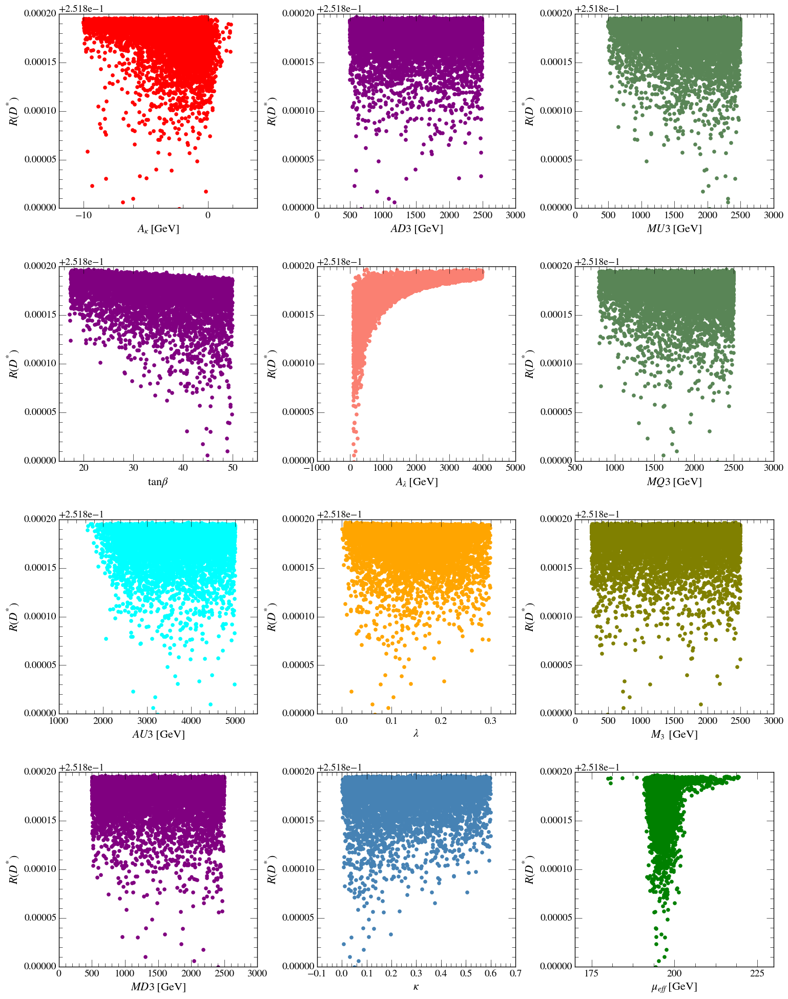

In [207]:
@save_fig
def plot_rds_input_scatter(df):
    plot_input_params_scatters(df=df, 
                              yvar='rds',
                              ylabel=RDS_STR, 
                              param_dict=nmssm_params_extended,
                              yrange=[0.2518, 0.252])
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RDS_LIM, 'Y')

plot_rds_input_scatter(df_pass_all.query('pass_strict'), 
                       filename='Thesis_plots_5/Exp_cons/rds_input_scatter.png')